# Penalaan Parameter PID Menggunakan Deep Learning pada Kit iTCLab

![PID_Deep_Learning](Deep_PID_iTCLab.jpg)
Proses penalaan nilai Kc, τI dan τD pada
pengendali PID menggunakan Deep Learning pada Kit iTCLab

In [8]:
import itclab
import numpy as np
import time
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import random

In [9]:
# Machine Learning - Building Datasets and Model
# Impor `Sequential` dari` keras.models`
from keras.models import Sequential

# Impor `Dense` dari` keras.layers`
from keras.layers import Dense

# Inisialisasi konstruktor
model = Sequential()

# Tambahkan lapisan masukan 
model.add(Dense(2, activation='sigmoid', input_shape=(2,)))

# Tambahkan satu lapisan tersembunyi
model.add(Dense(3, activation='sigmoid'))

# Tambahkan lapisan keluaran
model.add(Dense(3, activation='sigmoid'))

# Data Latih.
X = np.array([
    [1, 1],
    [0.4, 1.2],
    [1.2, 0.1],
    [1, 0.1]
])

# Label untuk Data Latih.
y = np.array([
    [0.25, 4.31, 0.20],
    [0.2, 4.1, 0.1],
    [0.1, 4.0, 0],
    [0.1, 4.0, 0]
])

# Bentuk keluaran model
model.output_shape

# Ringkasan model
model.summary()

# Konfigurasi model
model.get_config()

# Buat daftar semua tensor bobot 
model.get_weights()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_3 (Dense)                 │ (None, 2)              │             6 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 3)              │             9 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 3)              │            12 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27 (108.00 B)

 Trainable params: 27 (108.00 B)

 Non-trainable params: 0 (0.00 B)

[array([[-0.8562922 , -0.7762565 ],
        [-1.1338693 , -0.01893806]], dtype=float32),
 array([0., 0.], dtype=float32),
 array([[ 1.0445452 ,  0.5909383 , -0.618948  ],
        [ 0.879452  , -0.9111354 , -0.04631197]], dtype=float32),
 array([0., 0., 0.], dtype=float32),
 array([[-0.27839017,  0.12609649, -0.6505122 ],
        [ 0.2530961 , -0.71457124, -0.79189134],
        [ 0.38522243,  0.7114706 , -0.6991215 ]], dtype=float32),
 array([0., 0., 0.], dtype=float32)]

In [10]:
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
                   
model.fit(X, y,epochs=100, batch_size=1, verbose=1)

Epoch 1/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.1667 - loss: 0.4906      
Epoch 2/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.1000 - loss: 0.4786     
Epoch 3/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5333 - loss: 0.4600     
Epoch 4/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.4481 
Epoch 5/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 1.0000 - loss: 0.4206 
Epoch 6/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.4076 
Epoch 7/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.3847 
Epoch 8/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.3640 
Epoch 9/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.3617 
Epoch 10/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.3295 
Epoch 11/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 1.0000 - loss: 0.3268 
Epoch 12/100
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy:

In [11]:
######################################################
# Use this script for evaluating model predictions   #
# and PID controller performance for the TCLab       #
# Adjust only PID and model sections                 #
######################################################

######################################################
# PID Controller                                     #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution
def pid(sp,pv,pv_last,ierr,dt):
    Kc   = 10.0 # K/%Heater
    tauI = 50.0 # sec
    tauD = 1.0  # sec
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0
    # calculate the error
    error = sp-pv
    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [12]:
######################################################
# PID Controller using Deep Learning                 #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution

def pid_dl(sp,pv,pv_last,ierr,dt):

    # calculate the error
    error = sp-pv
    d_error = sp-pv_last
    delta_error = (error - d_error)
    
    outDL = model.predict(np.array([[error,delta_error]]))
    
    Kc = outDL[0,0]
    tauI = outDL[0,1]
    tauD = outDL[0,2]
    
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0

    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [13]:
######################################################
# FOPDT model                                        #
######################################################
Kp = 0.5      # degC/%
tauP = 120.0  # seconds
thetaP = 10   # seconds (integer)
Tss = 23      # degC (ambient temperature)
Qss = 0       # % heater

######################################################
# Energy balance model                               #
######################################################
def heat(x,t,Q):
    # Parameters
    Ta = 23 + 273.15   # K
    U = 10.0           # W/m^2-K
    m = 4.0/1000.0     # kg
    Cp = 0.5 * 1000.0  # J/kg-K    
    A = 12.0 / 100.0**2 # Area in m^2
    alpha = 0.01       # W / % heater
    eps = 0.9          # Emissivity
    sigma = 5.67e-8    # Stefan-Boltzman

    # Temperature State 
    T = x[0]

    # Nonlinear Energy Balance
    dTdt = (1.0/(m*Cp))*(U*A*(Ta-T) \
            + eps * sigma * A * (Ta**4 - T**4) \
            + alpha*Q)
    return dTdt

Opening connection
iTCLab connected via Arduino on port COM8
LED On
Running Main Loop. Ctrl-C to end.
  Time     SP     PV     Q1   =  P   +  I  +   D
   0.0  25.00  27.61   0.00   0.00   0.00   0.00


<Figure size 1000x700 with 0 Axes>

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


C:\Users\MSI-PC\AppData\Local\Temp\ipykernel_17164\303965437.py:80: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Tp[i] = Tnext[1]-273.15


   1.0  25.00  27.58   0.00  -0.75   0.00   0.00


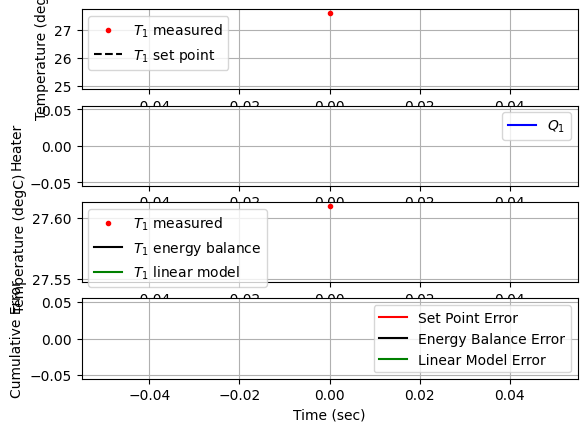

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
   2.0  25.00  27.62   0.00  -0.76   0.00  -0.00


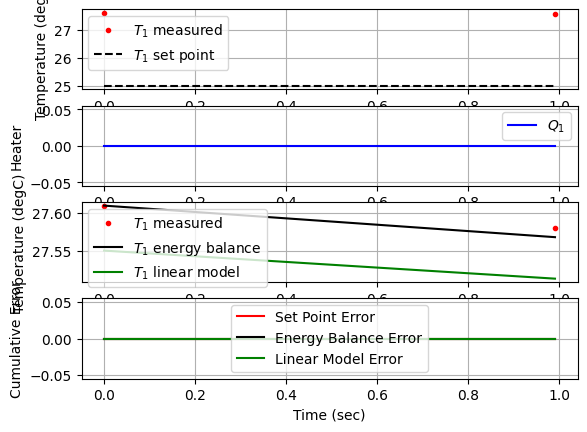

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
   3.0  25.00  27.69   0.00  -0.78   0.00  -0.00


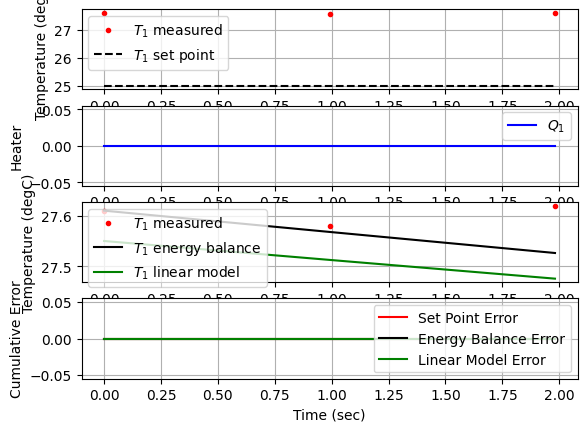

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
   4.0  25.00  27.61   0.00  -0.76   0.00   0.00


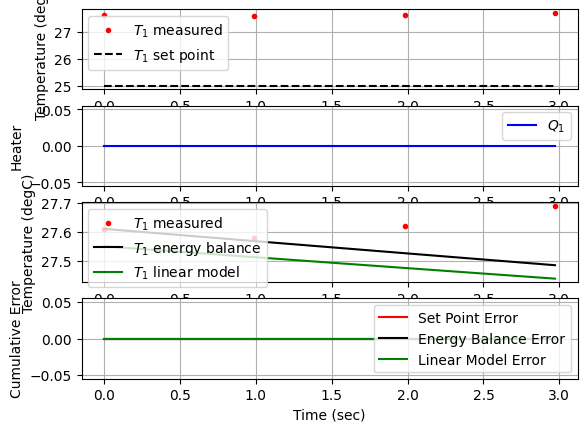

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
   5.0  25.00  27.68   0.00  -0.78   0.00  -0.00


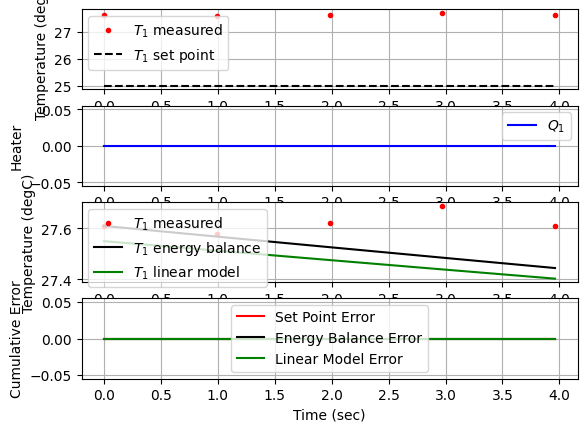

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
   5.9  25.00  27.61   0.00  -0.76   0.00   0.00


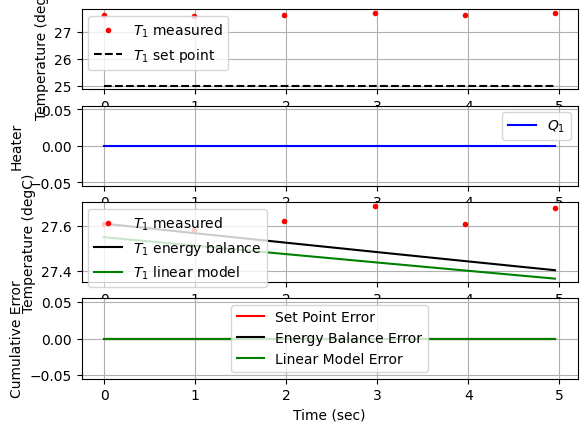

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
   6.9  25.00  27.58   0.00  -0.75   0.00   0.00


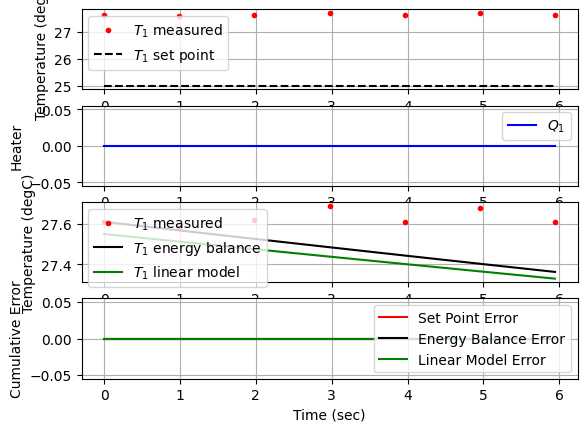

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
   7.9  25.00  27.71   0.00  -0.79   0.00  -0.00


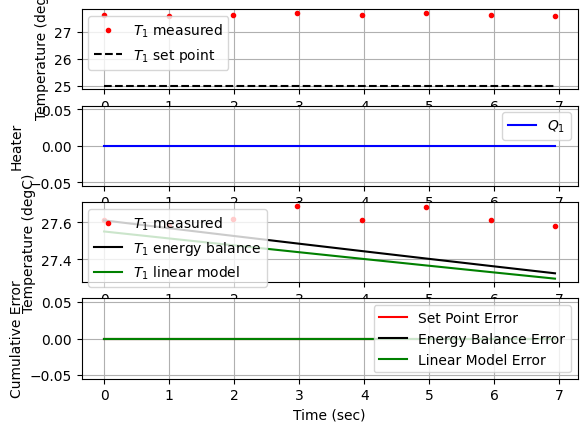

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
   8.9  25.00  27.63   0.00  -0.77   0.00   0.00


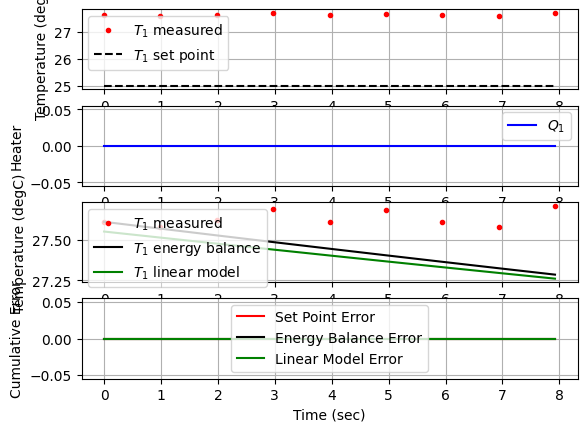

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
   9.9  25.00  27.68   0.00  -0.78   0.00  -0.00


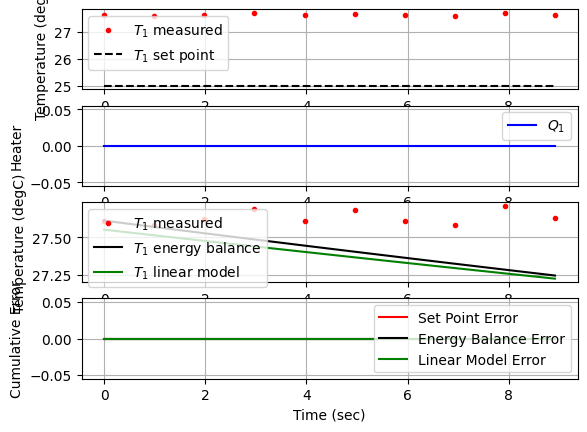

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  10.9  25.00  27.56   0.00  -0.75   0.00   0.00


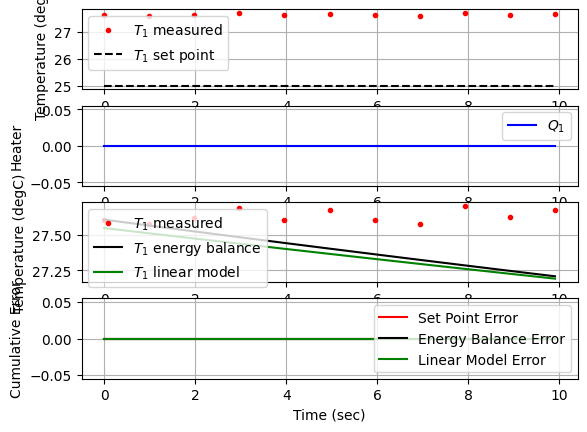

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  11.9  25.00  27.58   0.00  -0.75   0.00  -0.00


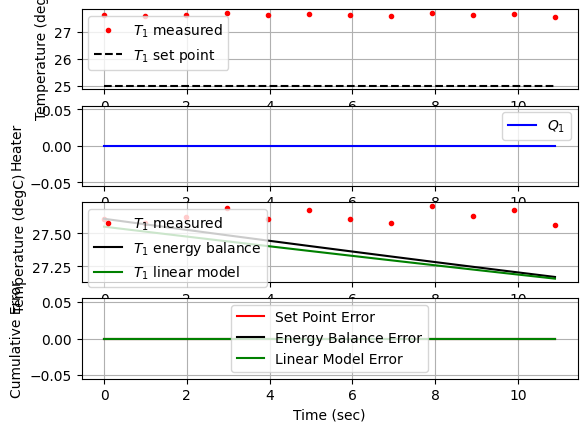

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  12.9  25.00  27.60   0.00  -0.76   0.00  -0.00


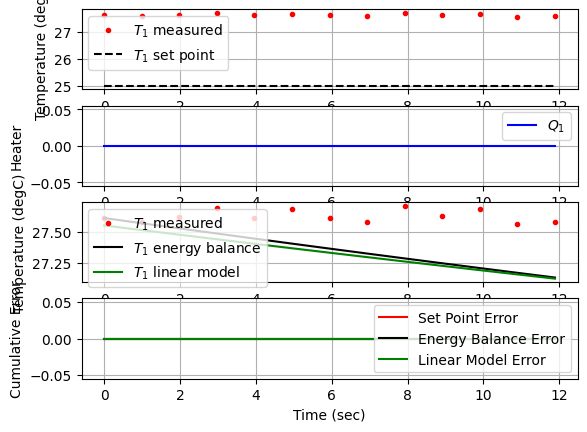

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  13.9  25.00  27.61   0.00  -0.76   0.00  -0.00


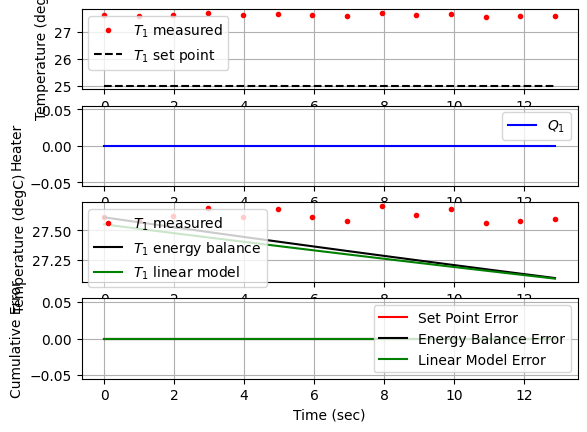

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  14.9  25.00  27.64   0.00  -0.77   0.00  -0.00


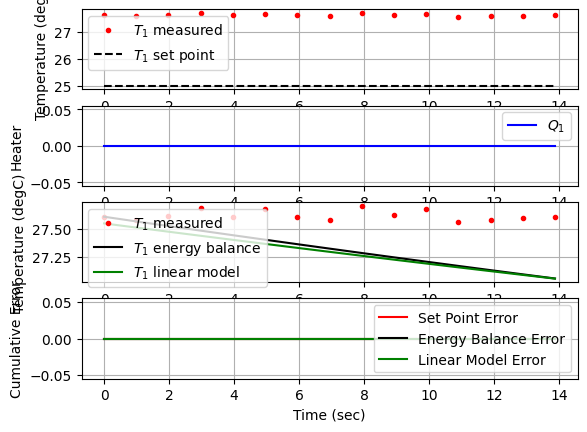

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  15.8  25.00  27.70   0.00  -0.79   0.00  -0.00


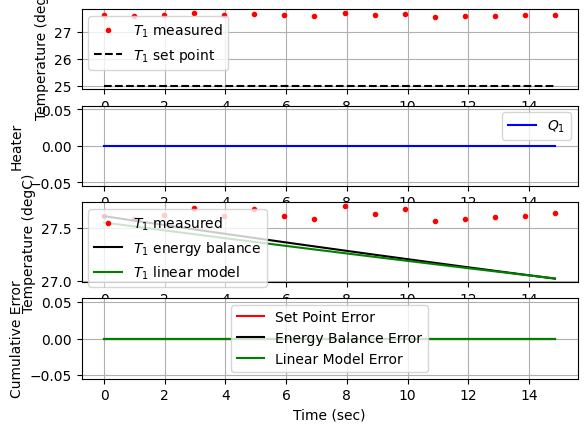

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  16.8  25.00  27.67   0.00  -0.78   0.00   0.00


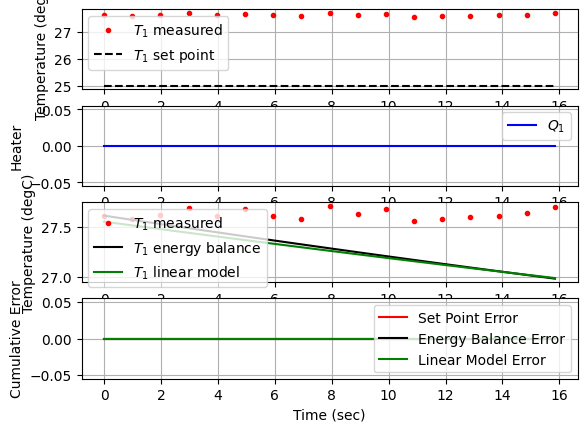

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  17.8  25.00  27.61   0.00  -0.76   0.00   0.00


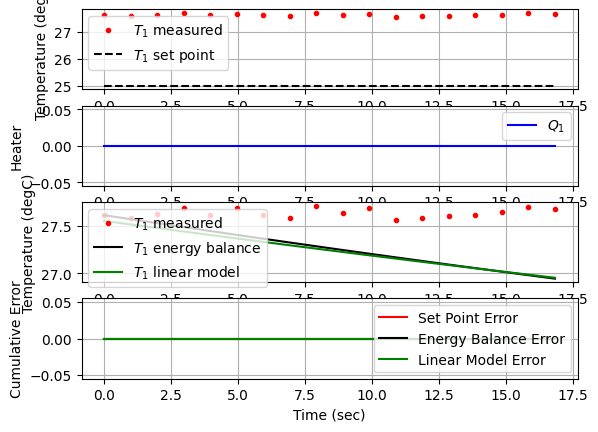

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  18.8  25.00  27.60   0.00  -0.76   0.00   0.00


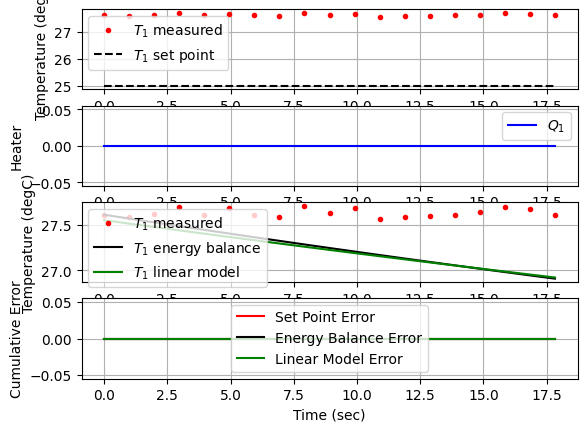

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  19.8  25.00  27.67   0.00  -0.78   0.00  -0.00


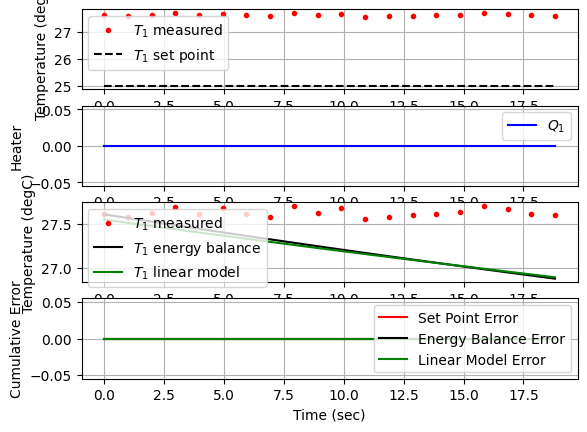

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  20.8  25.00  27.66   0.00  -0.78   0.00   0.00


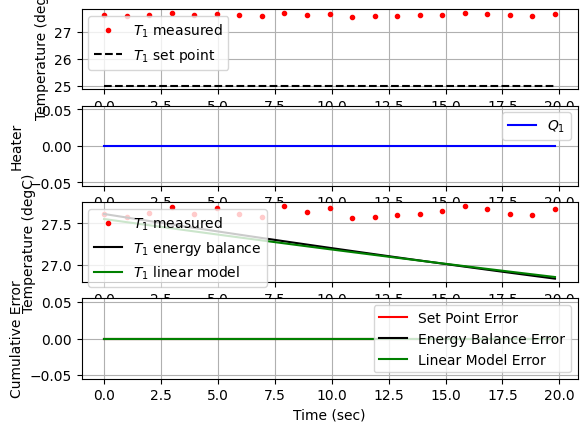

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  21.8  25.00  27.61   0.00  -0.76   0.00   0.00


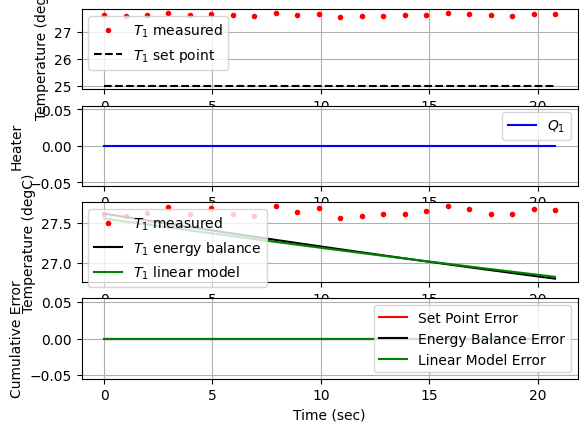

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  22.8  25.00  27.60   0.00  -0.76   0.00   0.00


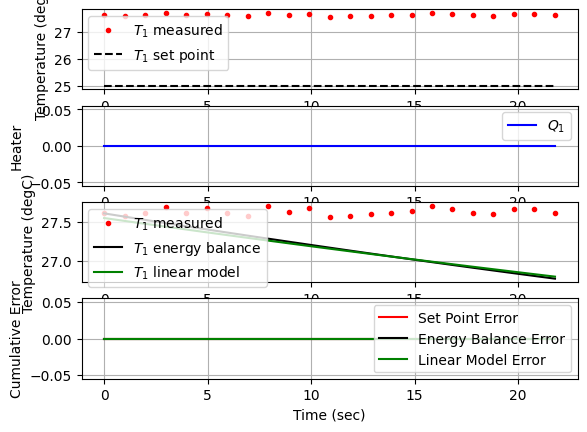

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  23.8  25.00  27.62   0.00  -0.76   0.00  -0.00


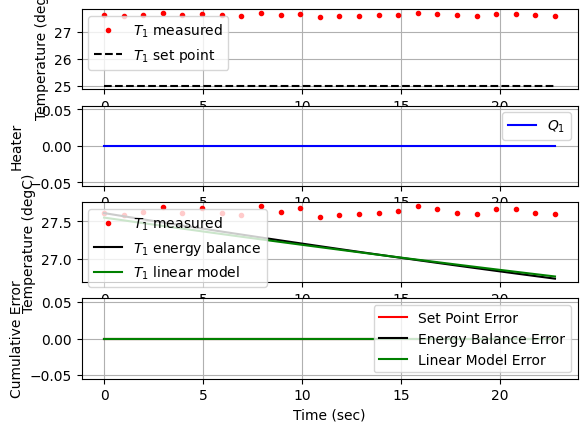

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  24.8  25.00  27.56   0.00  -0.75   0.00   0.00


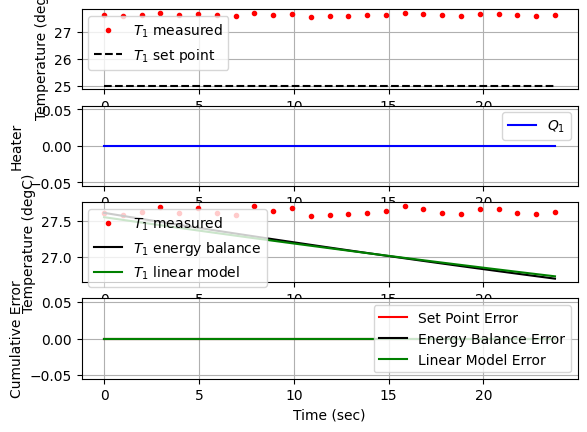

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  25.7  25.00  27.59   0.00  -0.76   0.00  -0.00


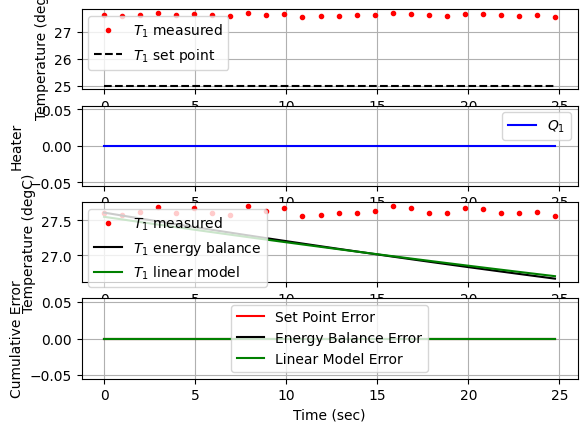

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  26.7  25.00  27.67   0.00  -0.78   0.00  -0.00


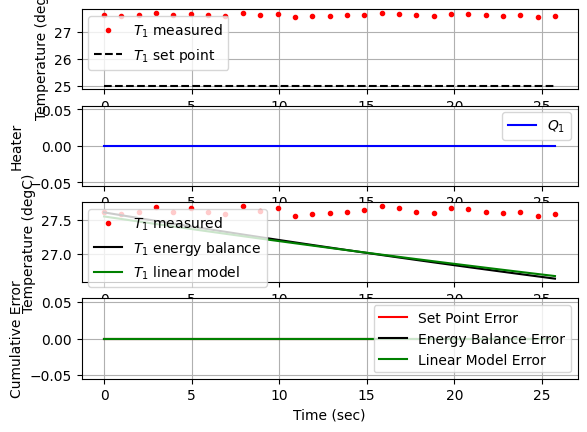

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  27.7  25.00  27.68   0.00  -0.78   0.00  -0.00


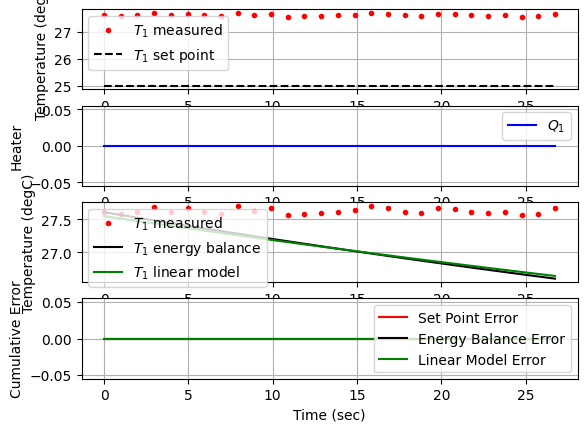

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  28.7  25.00  27.64   0.00  -0.77   0.00   0.00


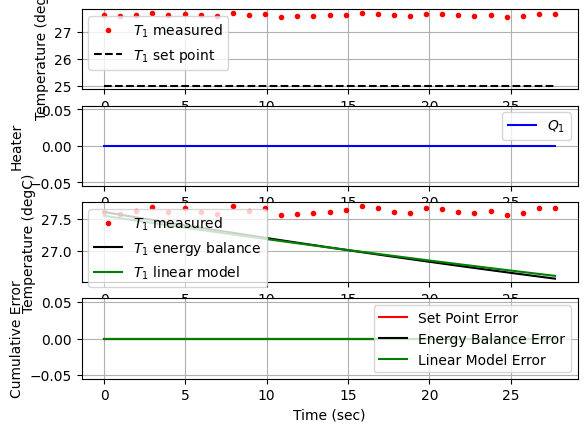

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  29.7  25.00  27.68   0.00  -0.78   0.00  -0.00


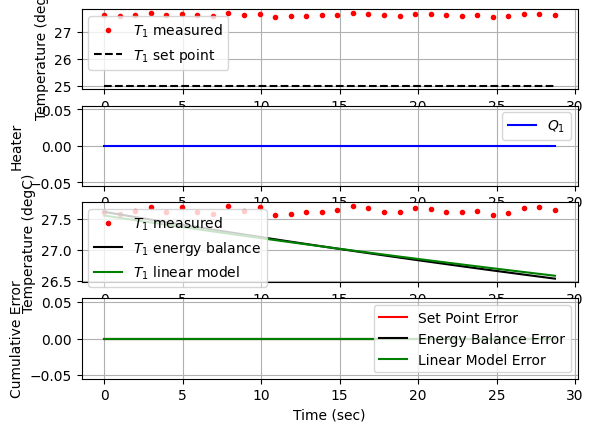

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
  30.7  25.00  27.61   0.00  -0.76   0.00   0.00


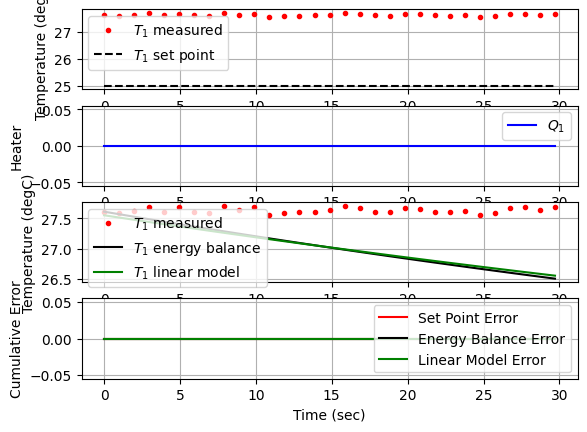

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  31.7  25.00  27.58   0.00  -0.75   0.00   0.00


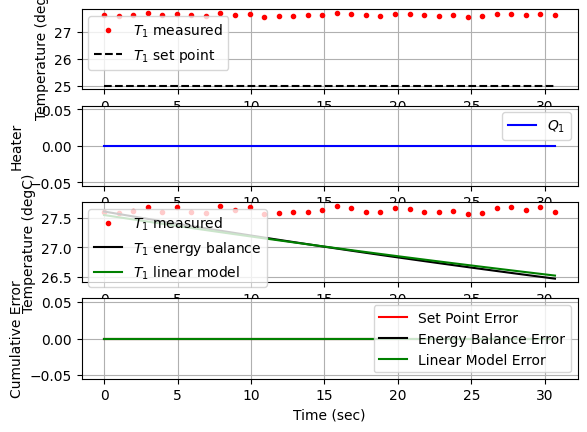

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  32.7  25.00  27.69   0.00  -0.78   0.00  -0.00


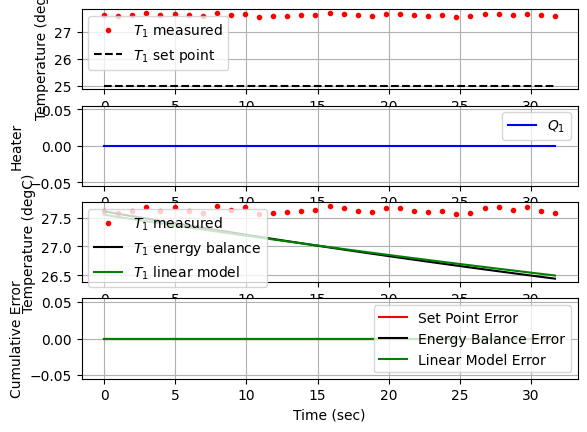

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  33.7  25.00  27.70   0.00  -0.79   0.00  -0.00


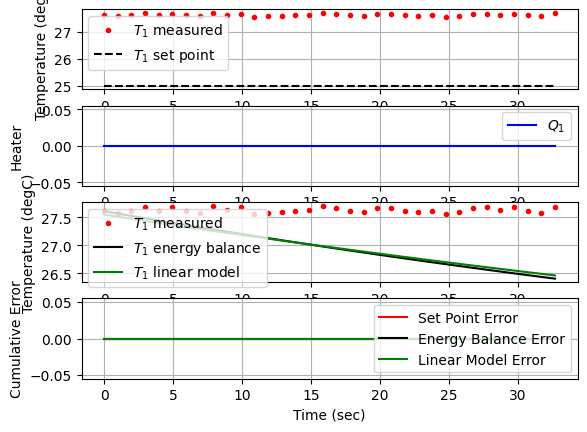

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  34.7  25.00  27.70   0.00  -0.79   0.00  -0.00


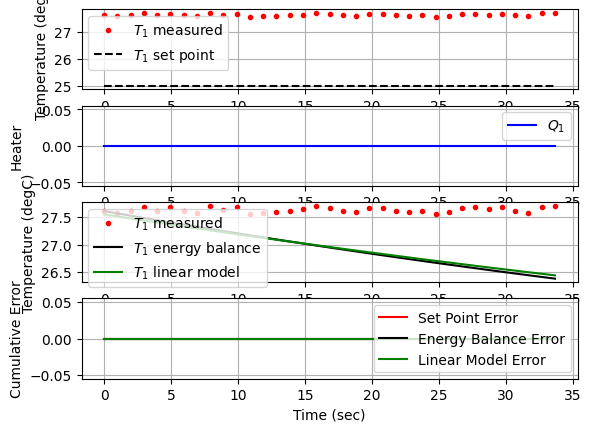

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  35.7  25.00  27.68   0.00  -0.78   0.00   0.00


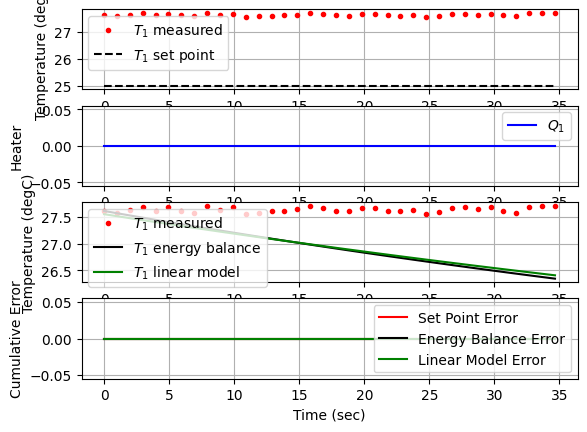

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  36.6  25.00  27.67   0.00  -0.78   0.00   0.00


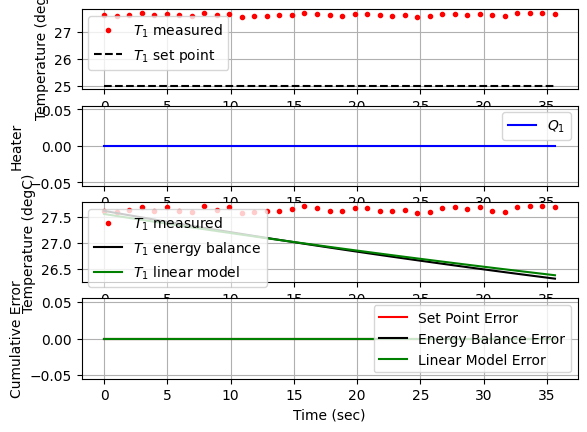

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  37.6  25.00  27.66   0.00  -0.78   0.00   0.00


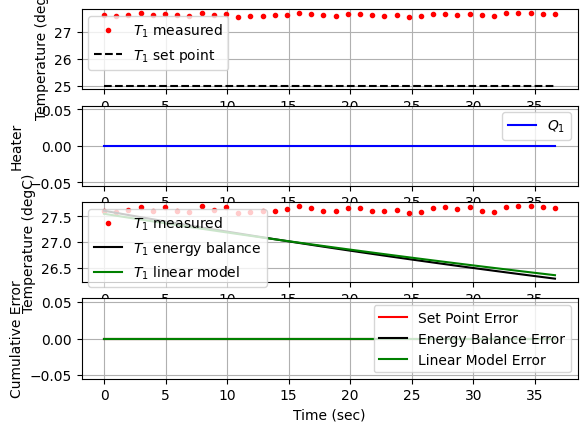

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  38.6  25.00  27.63   0.00  -0.77   0.00   0.00


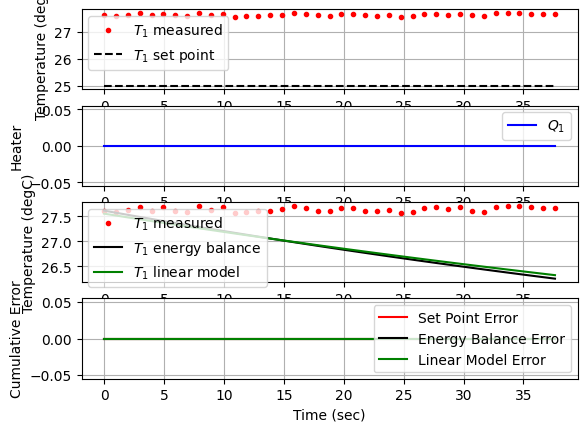

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  39.6  25.00  27.61   0.00  -0.76   0.00   0.00


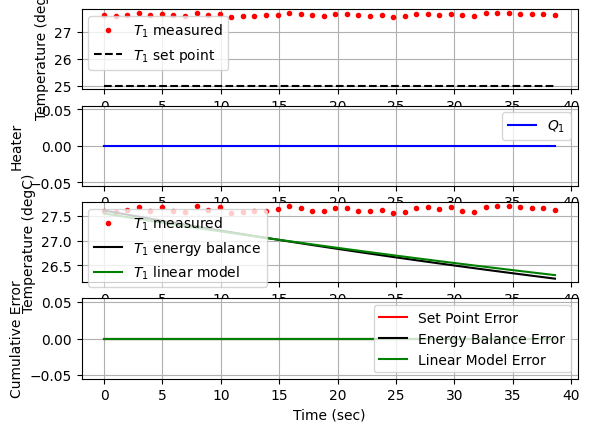

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  40.6  25.00  27.68   0.00  -0.78   0.00  -0.00


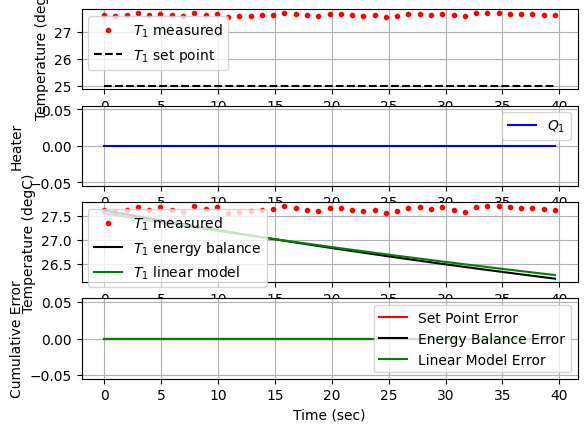

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  41.6  25.00  27.65   0.00  -0.77   0.00   0.00


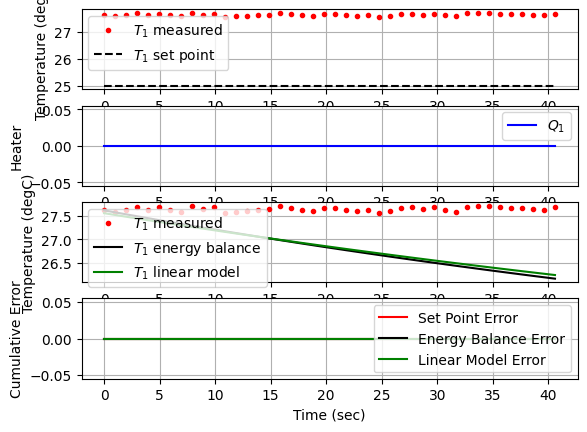

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  42.6  25.00  27.64   0.00  -0.77   0.00   0.00


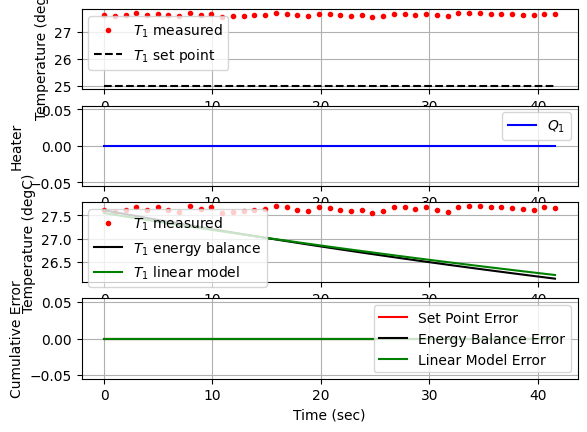

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
  43.6  25.00  27.68   0.00  -0.78   0.00  -0.00


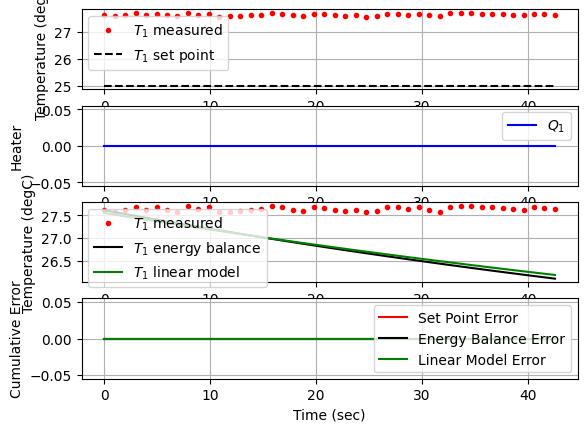

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  44.6  25.00  27.61   0.00  -0.76   0.00   0.00


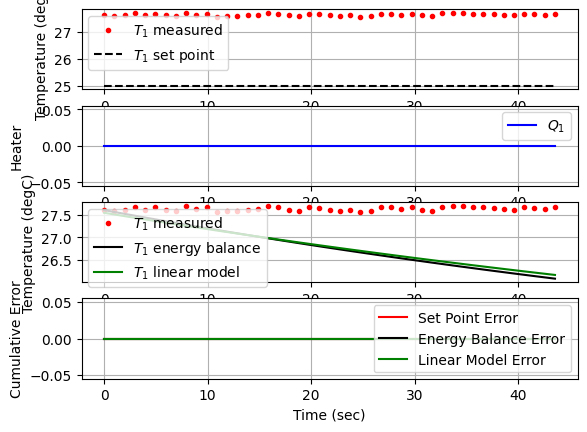

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  45.6  25.00  27.68   0.00  -0.78   0.00  -0.00


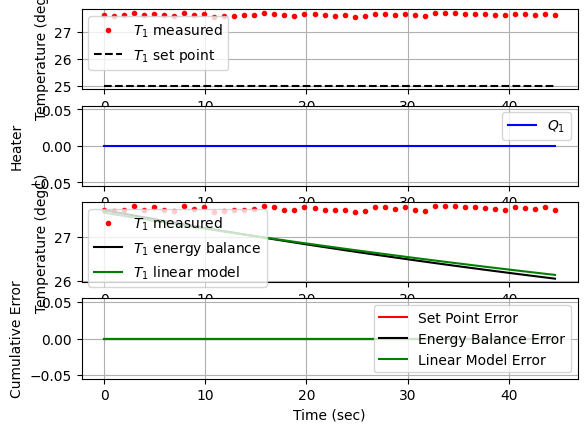

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  46.5  25.00  27.64   0.00  -0.77   0.00   0.00


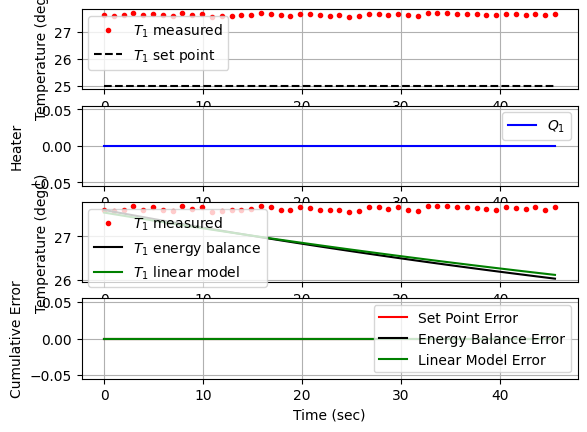

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  47.5  25.00  27.66   0.00  -0.78   0.00  -0.00


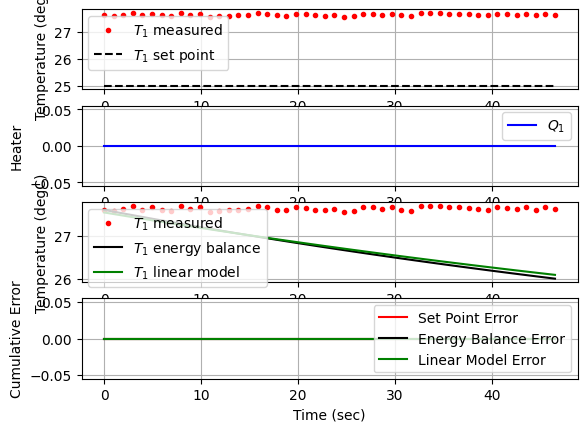

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
  48.5  25.00  27.57   0.00  -0.75   0.00   0.00


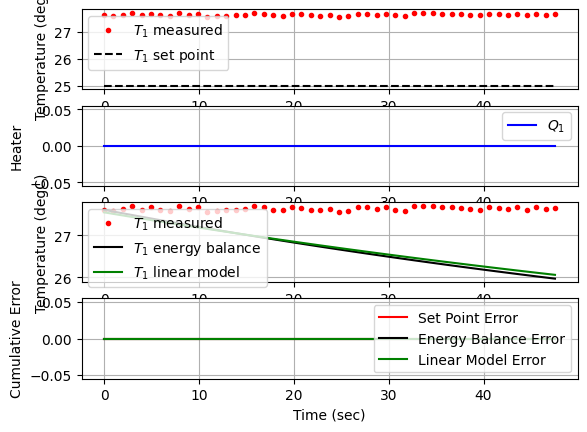

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  49.5  25.00  27.60   0.00  -0.76   0.00  -0.00


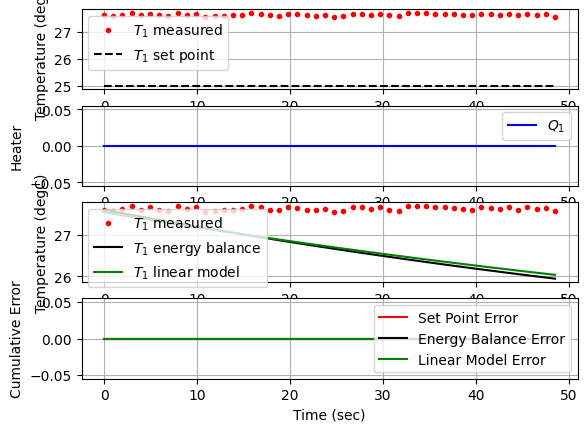

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  50.5  25.00  27.70   0.00  -0.79   0.00  -0.00


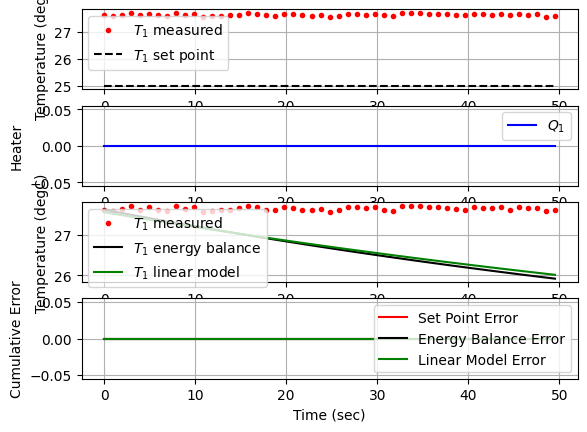

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  51.5  25.00  27.67   0.00  -0.78   0.00   0.00


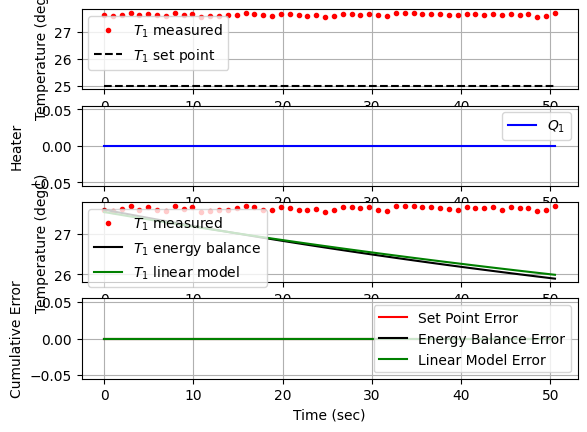

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  52.5  25.00  27.62   0.00  -0.76   0.00   0.00


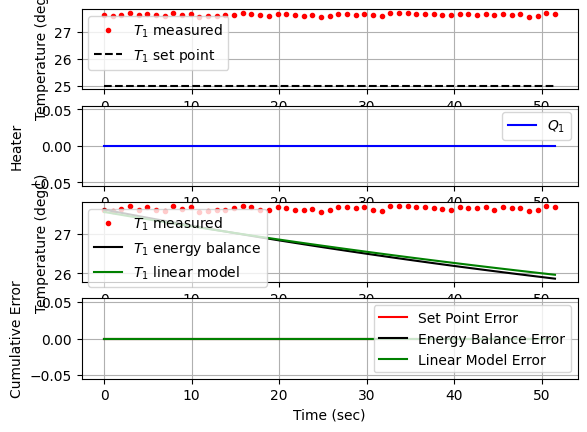

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  53.5  25.00  27.55   0.00  -0.74   0.00   0.00


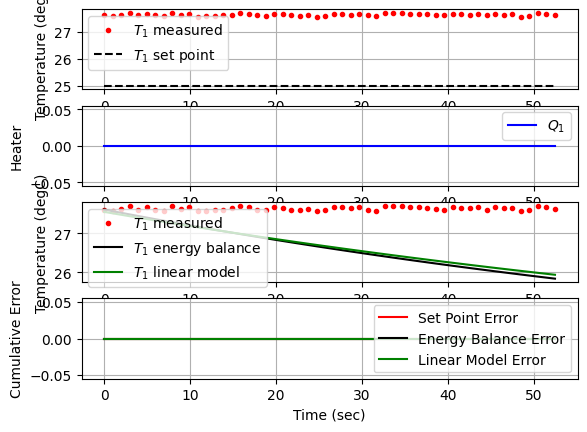

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  54.5  25.00  27.68   0.00  -0.78   0.00  -0.00


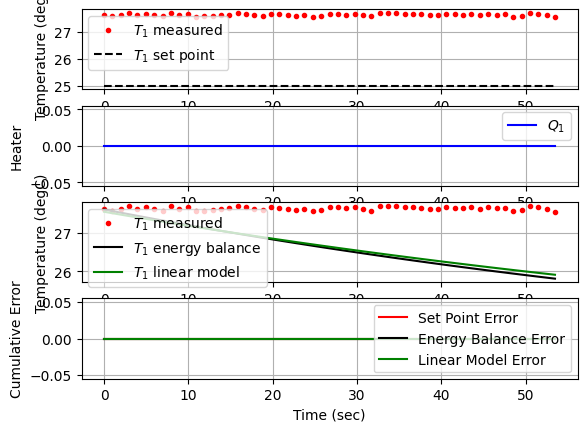

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  55.5  25.00  27.63   0.00  -0.77   0.00   0.00


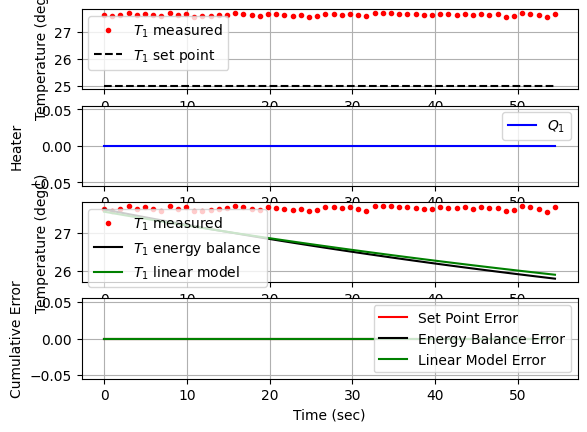

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  56.4  25.00  27.67   0.00  -0.78   0.00  -0.00


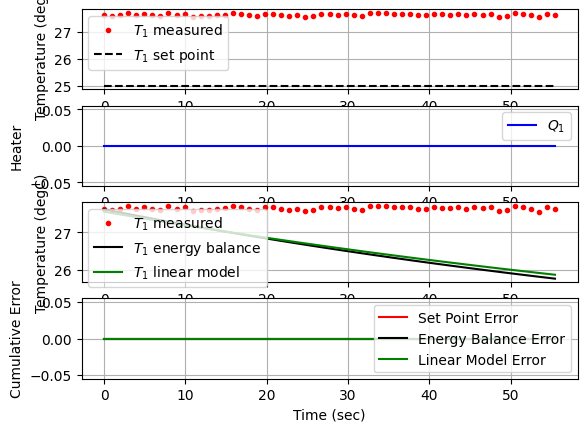

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  57.4  25.00  27.71   0.00  -0.79   0.00  -0.00


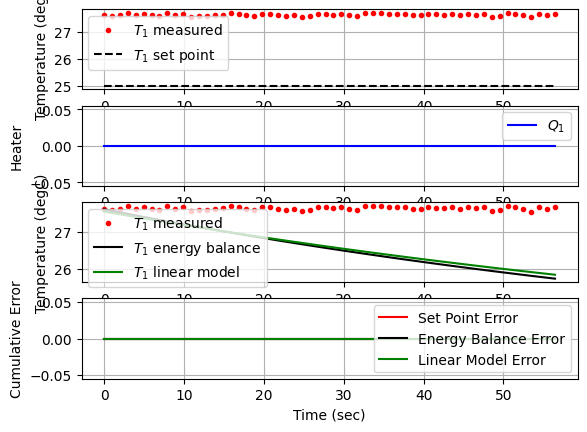

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  58.4  25.00  27.60   0.00  -0.76   0.00   0.00


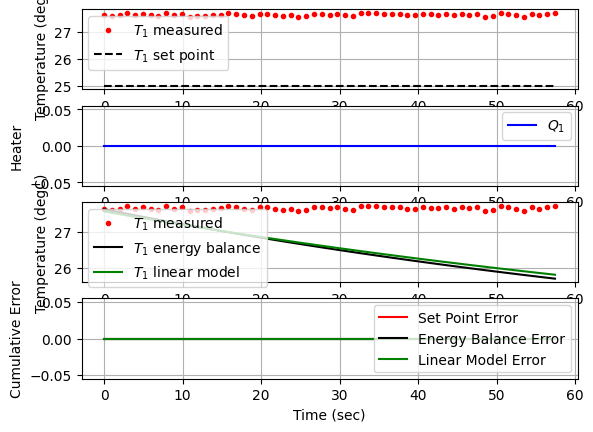

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  59.4  45.00  27.68  13.16   5.80   7.37  -0.00


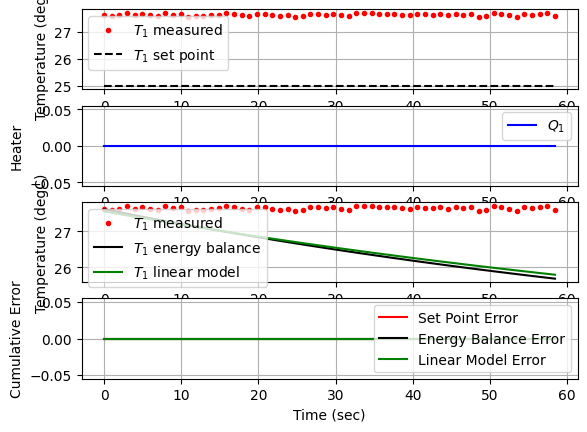

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  60.4  45.00  27.72  20.51   5.78  14.73  -0.00


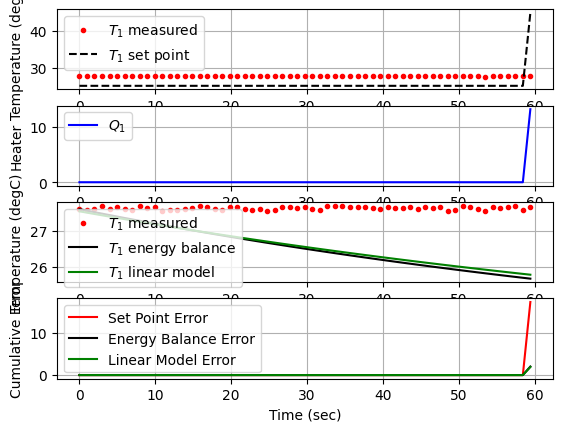

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
  61.4  45.00  27.64  27.93   5.81  22.12   0.00


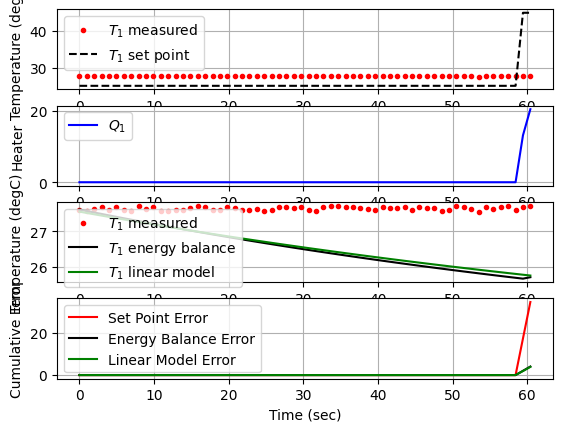

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  62.4  45.00  27.64  35.32   5.81  29.51  -0.00


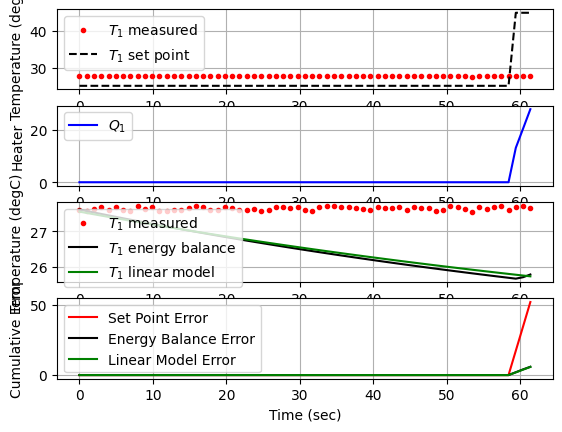

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  63.4  45.00  27.61  42.73   5.82  36.91   0.00


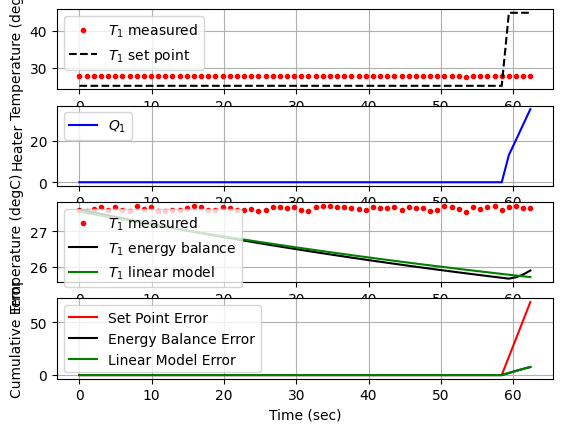

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  64.4  45.00  27.61  50.13   5.82  44.31  -0.00


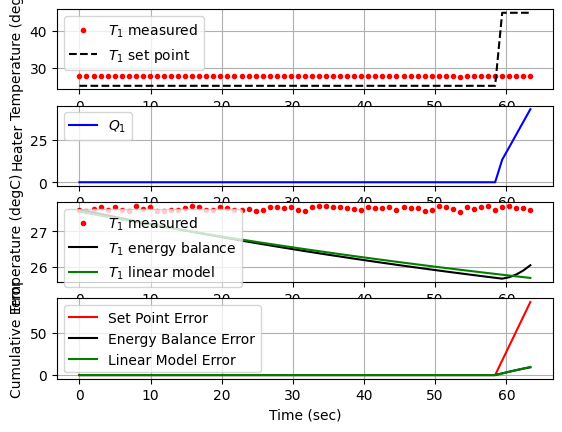

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  65.4  45.00  27.72  57.45   5.78  51.67  -0.01


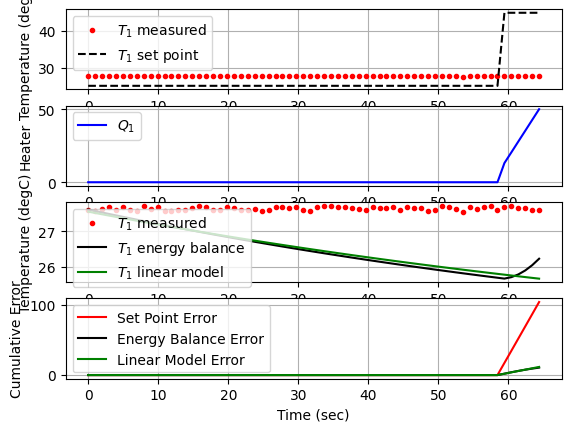

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
  66.4  45.00  27.69  64.83   5.79  59.04   0.00


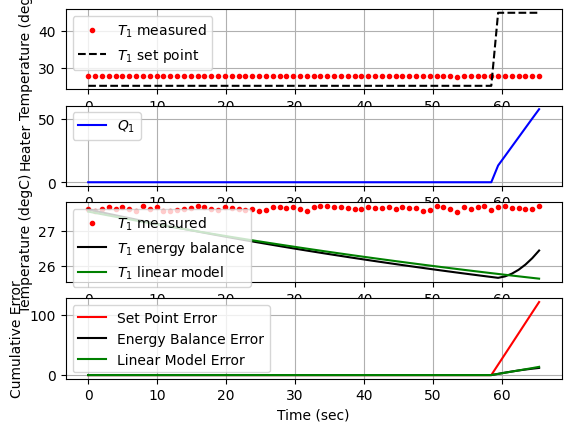

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  67.3  45.00  27.64  72.24   5.81  66.43   0.00


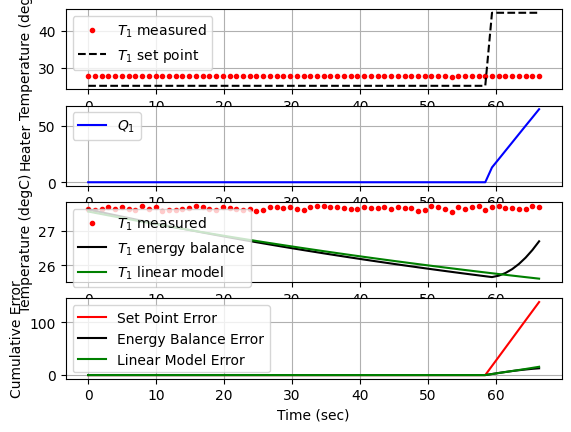

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
  68.3  45.00  27.60  79.66   5.82  73.84   0.00


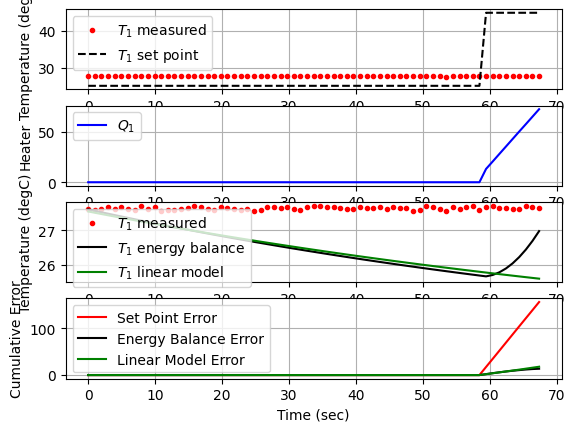

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  69.3  45.00  27.60  87.07   5.82  81.24  -0.00


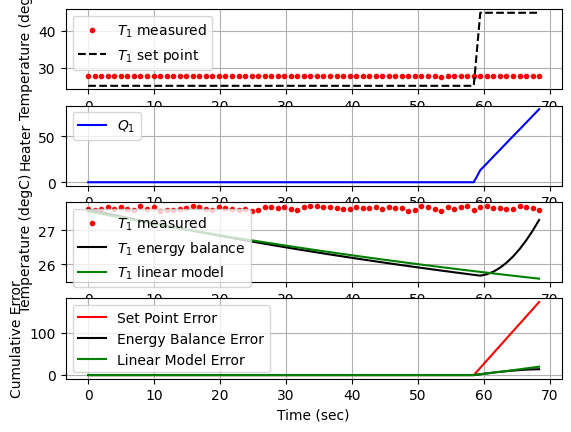

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  70.3  45.00  27.65  94.43   5.81  88.63  -0.00


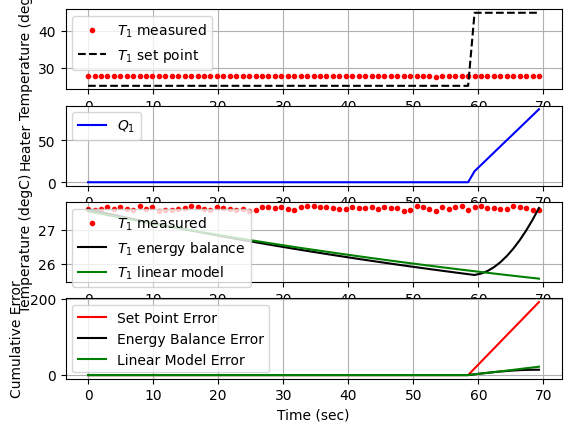

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
  71.3  45.00  27.76 100.00   5.77  88.63  -0.01


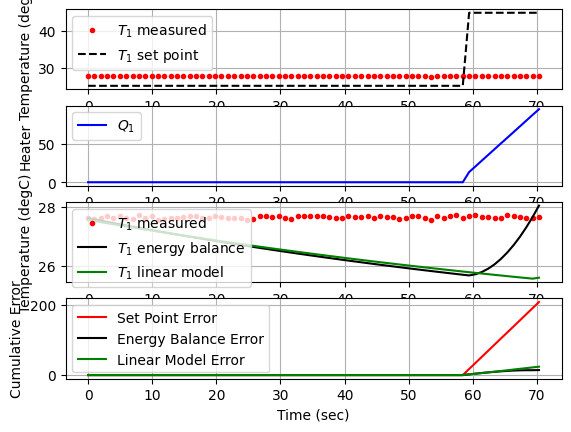

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  72.3  45.00  27.61 100.00   5.82  88.63   0.01


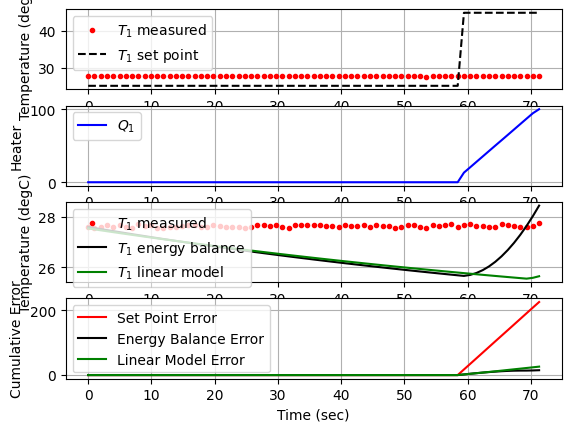

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  73.3  45.00  27.65 100.00   5.81  88.63  -0.00


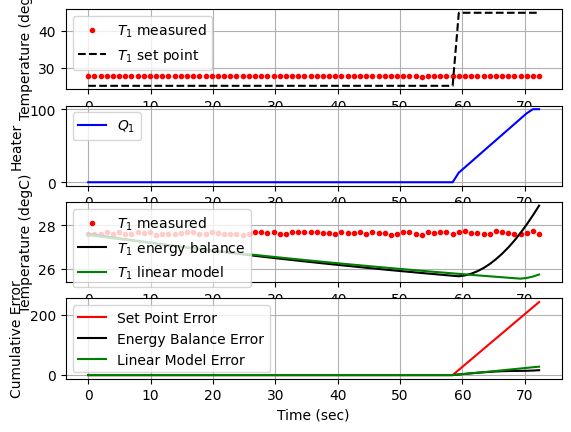

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  74.3  45.00  27.61 100.00   5.82  88.63   0.00


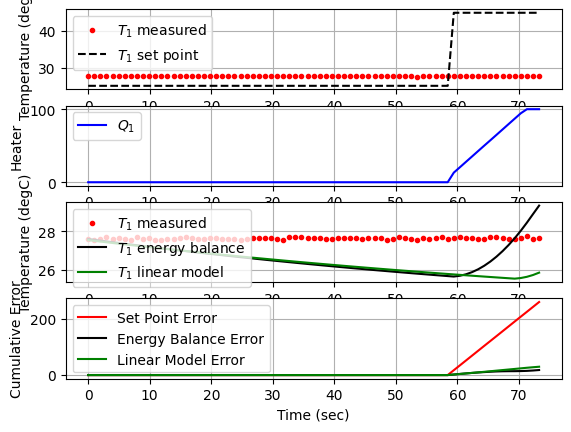

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  75.3  45.00  27.61 100.00   5.82  88.63  -0.00


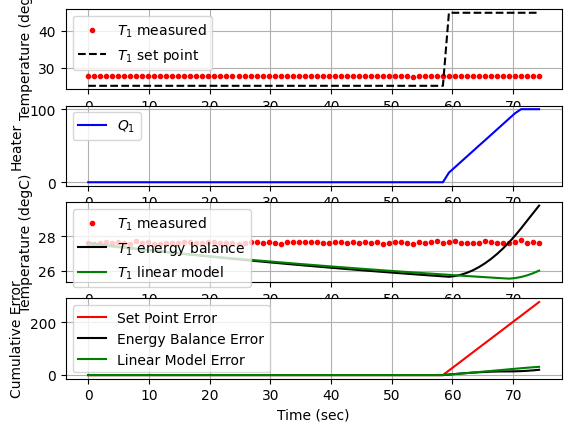

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  76.3  45.00  27.61 100.00   5.82  88.63  -0.00


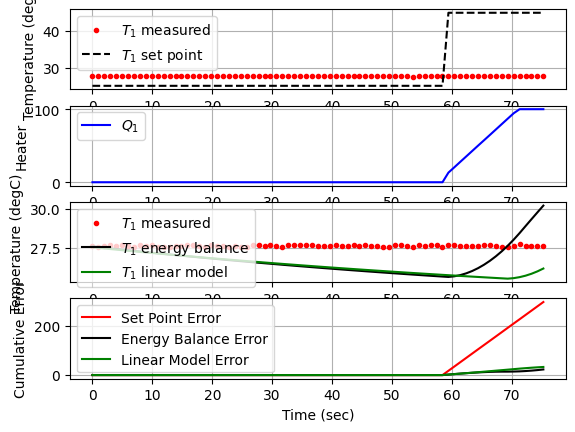

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  77.2  45.00  27.57 100.00   5.83  88.63   0.00


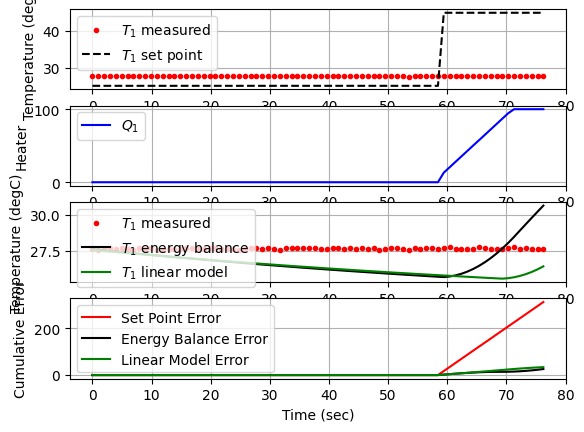

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  78.2  45.00  27.60 100.00   5.82  88.63  -0.00


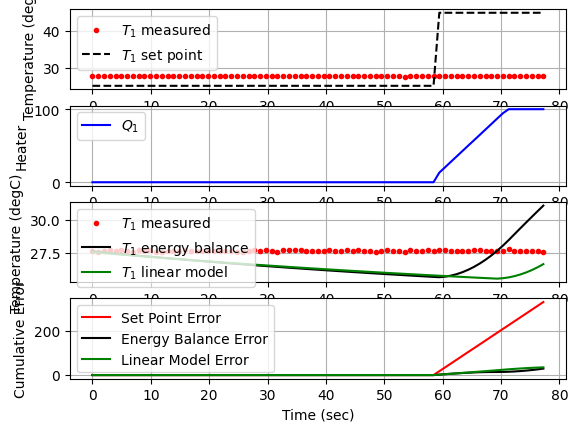

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
  79.2  45.00  27.69 100.00   5.79  88.63  -0.00


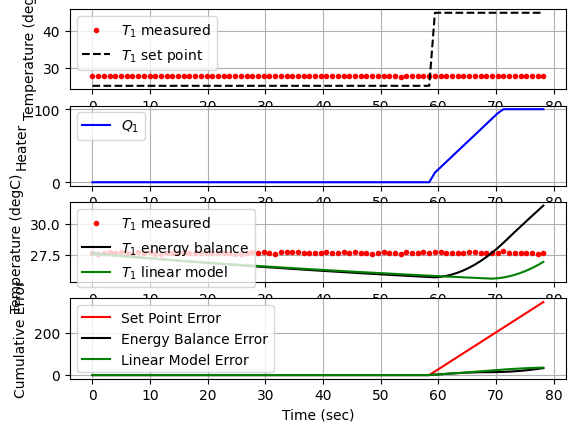

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  80.2  45.00  27.58 100.00   5.83  88.63   0.01


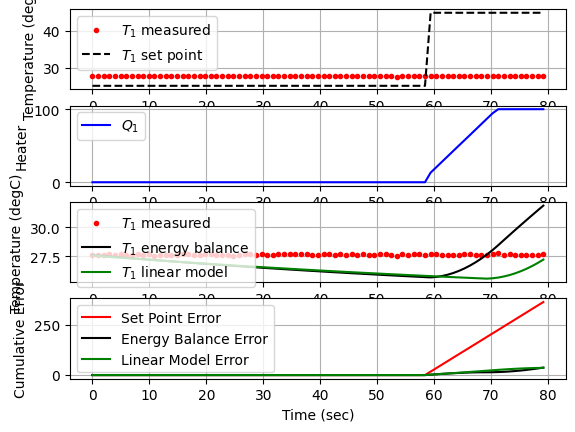

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  81.2  45.00  27.74 100.00   5.78  88.63  -0.01


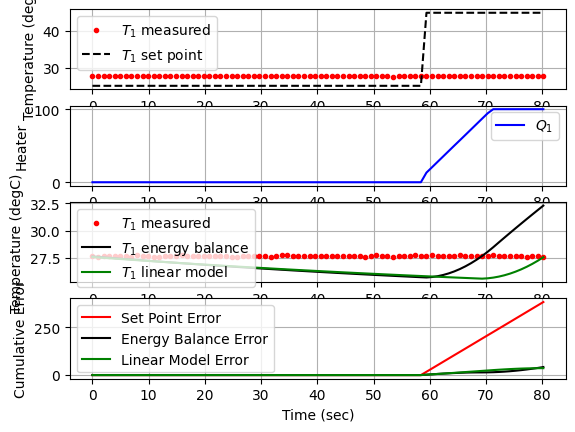

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  82.2  45.00  27.65 100.00   5.81  88.63   0.00


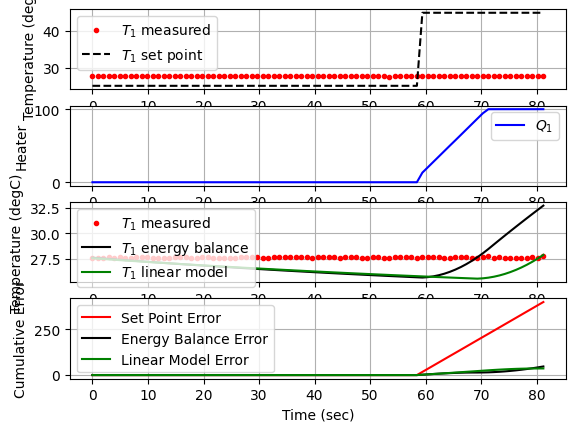

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  83.2  45.00  27.56 100.00   5.84  88.63   0.00


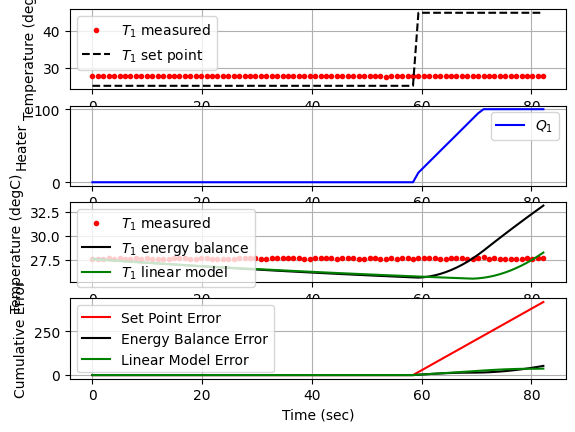

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  84.2  45.00  27.61 100.00   5.82  88.63  -0.00


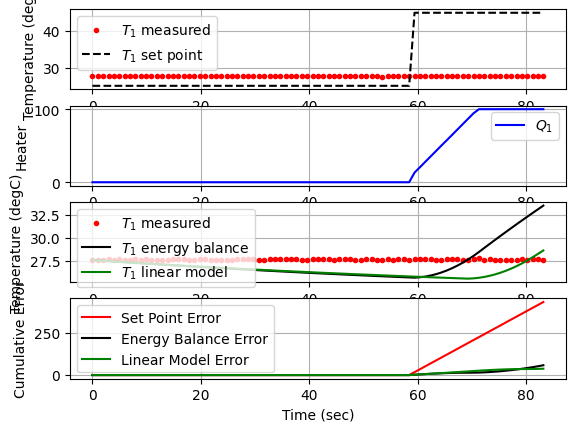

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  85.2  45.00  27.60 100.00   5.82  88.63   0.00


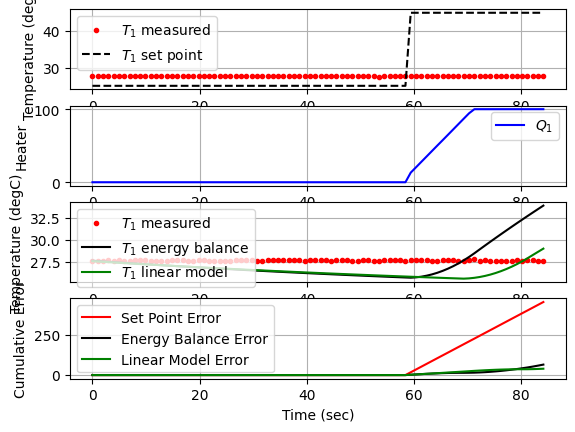

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  86.2  45.00  27.60 100.00   5.82  88.63  -0.00


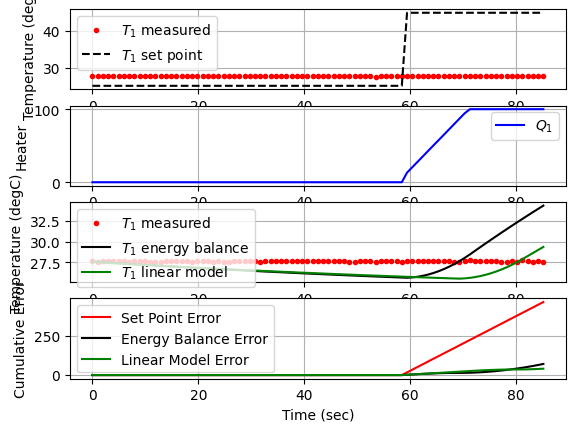

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  87.1  45.00  27.58 100.00   5.83  88.63   0.00


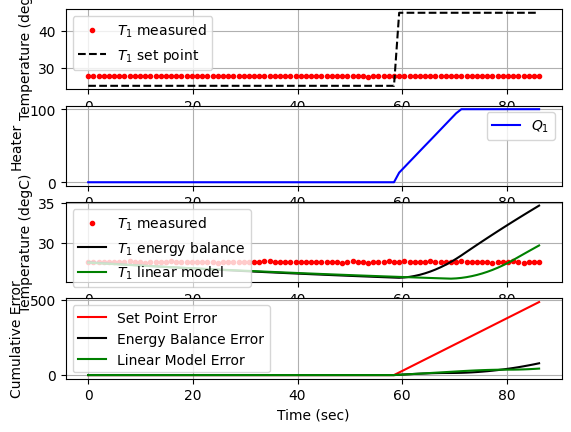

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  88.1  45.00  27.69 100.00   5.79  88.63  -0.01


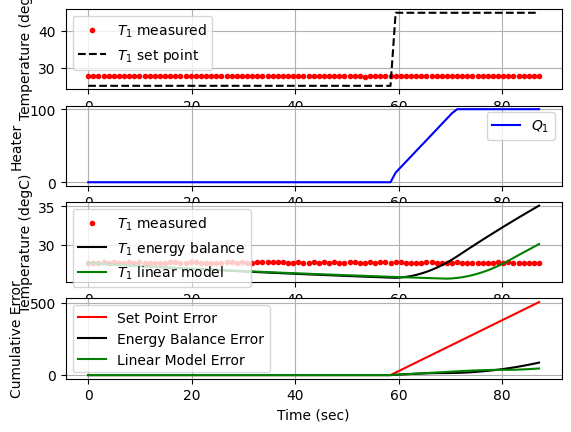

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  89.1  45.00  27.58 100.00   5.83  88.63   0.01


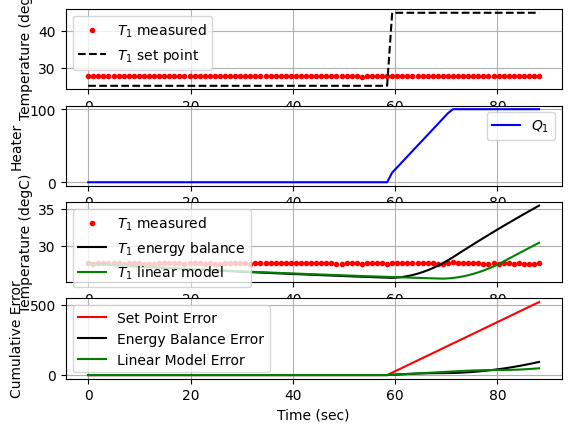

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  90.1  45.00  27.72 100.00   5.78  88.63  -0.01


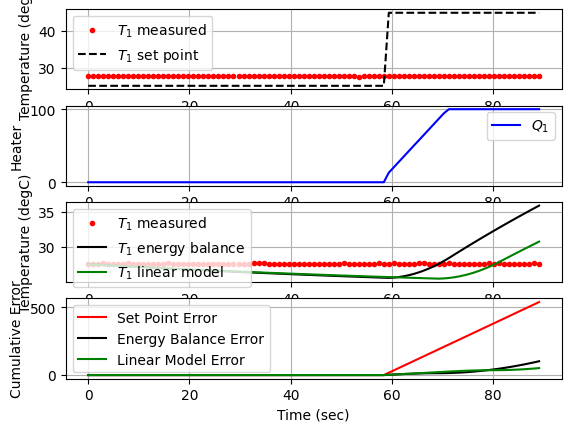

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  91.1  45.00  27.63 100.00   5.81  88.63   0.00


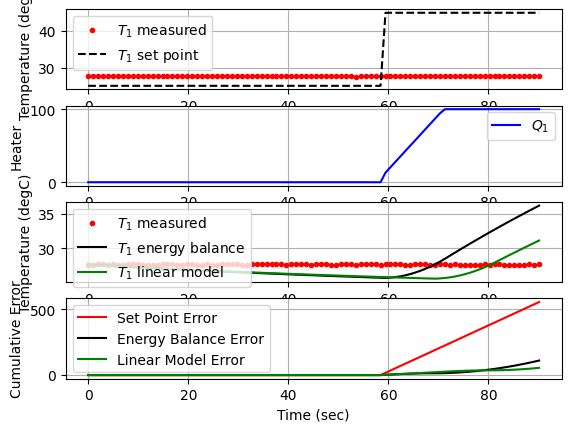

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  92.1  45.00  27.61 100.00   5.82  88.63   0.00


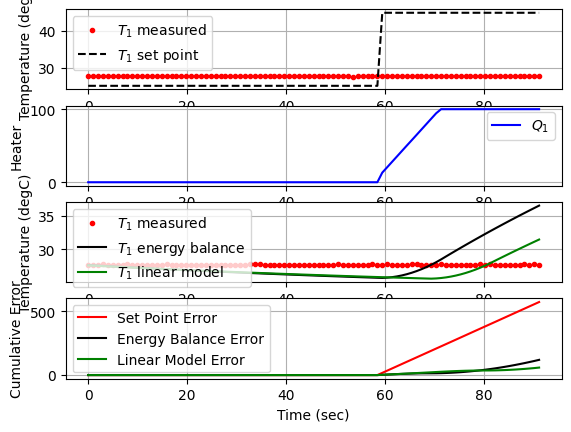

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  93.1  45.00  27.61 100.00   5.82  88.63  -0.00


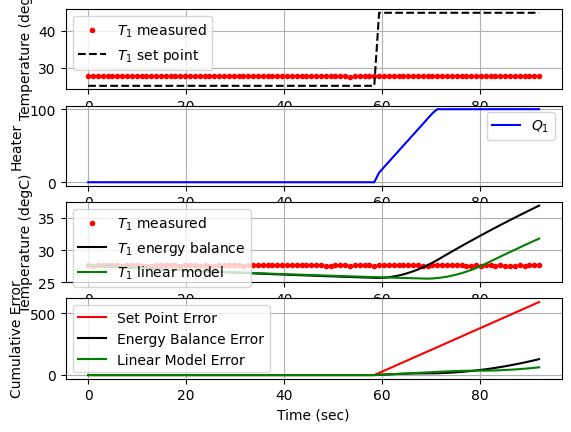

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
  94.1  45.00  27.64 100.00   5.81  88.63  -0.00


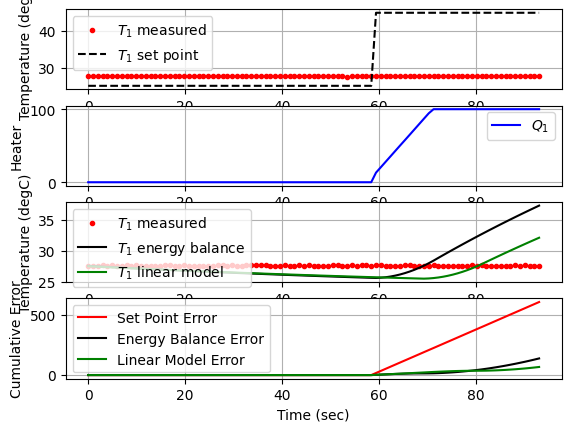

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  95.1  45.00  27.57 100.00   5.83  88.63   0.00


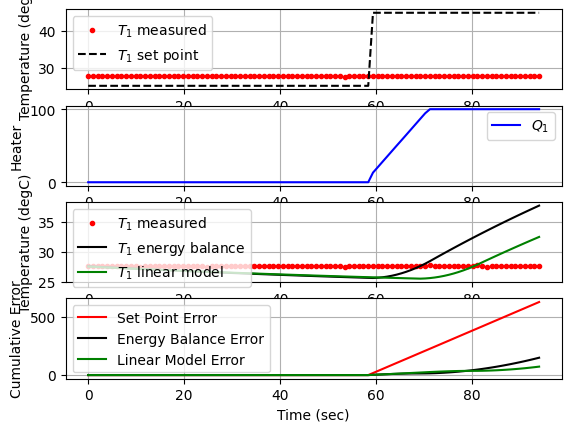

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  96.1  45.00  27.61 100.00   5.82  88.63  -0.00


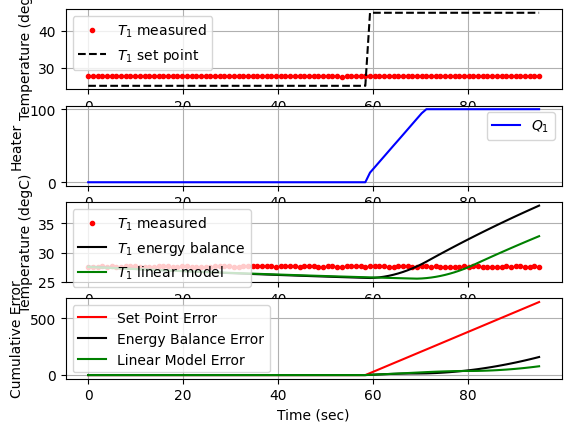

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
  97.0  45.00  27.57 100.00   5.83  88.63   0.00


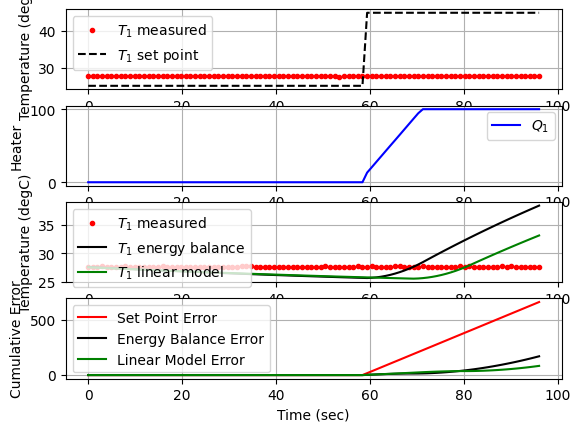

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  98.0  45.00  27.71 100.00   5.79  88.63  -0.01


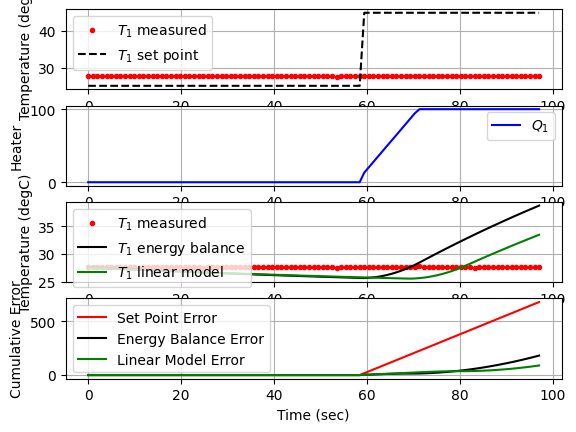

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
  99.0  45.00  27.57 100.00   5.83  88.63   0.01


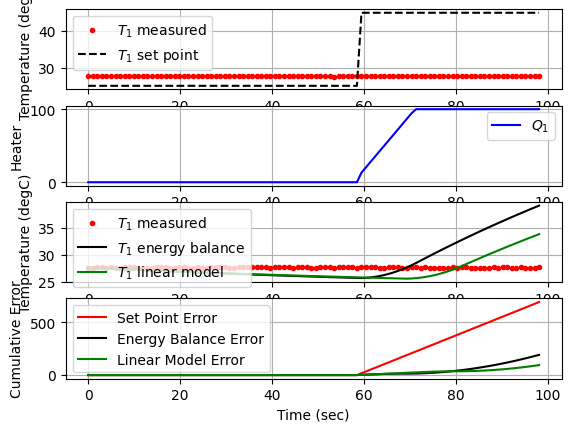

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 100.0  45.00  27.63 100.00   5.81  88.63  -0.00


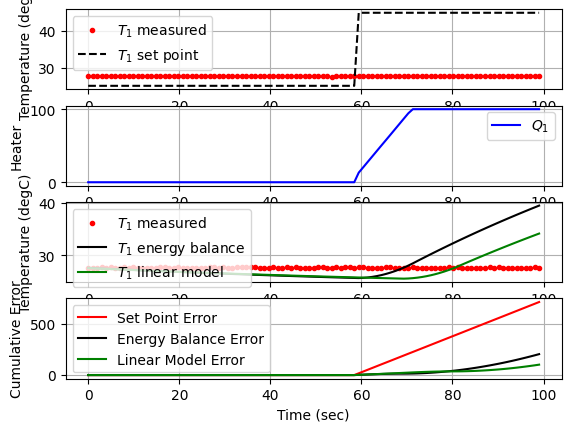

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 101.0  45.00  27.65 100.00   5.81  88.63  -0.00


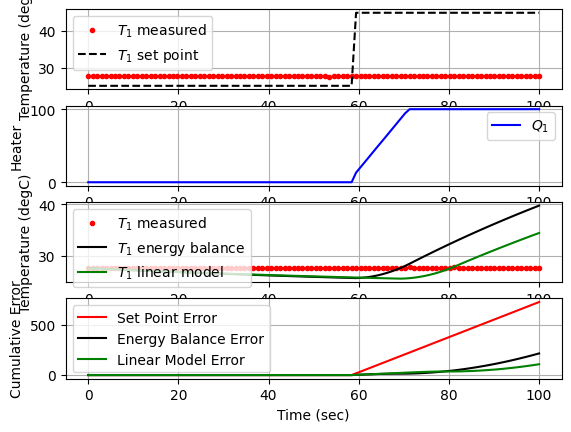

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 102.0  45.00  27.62 100.00   5.82  88.63   0.00


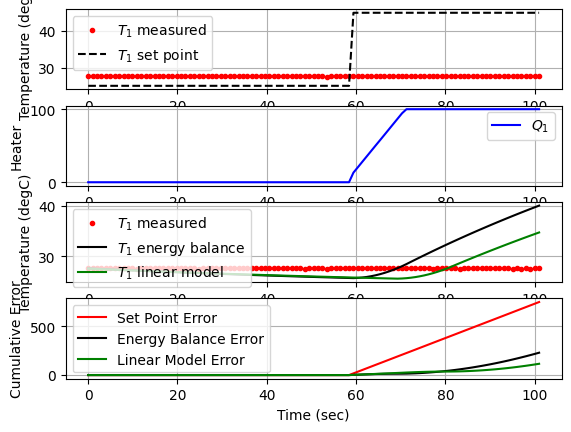

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 103.0  45.00  27.58 100.00   5.83  88.63   0.00


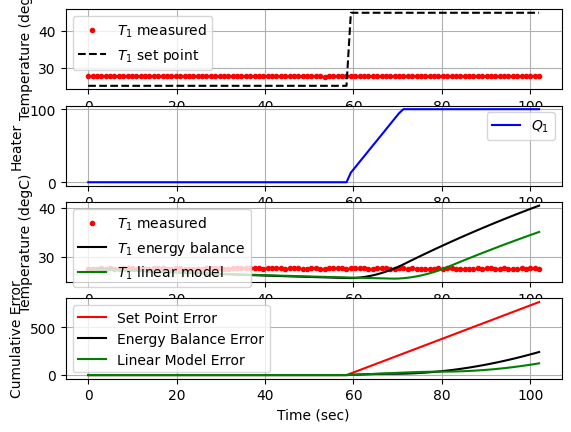

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 104.0  45.00  27.67 100.00   5.80  88.63  -0.00


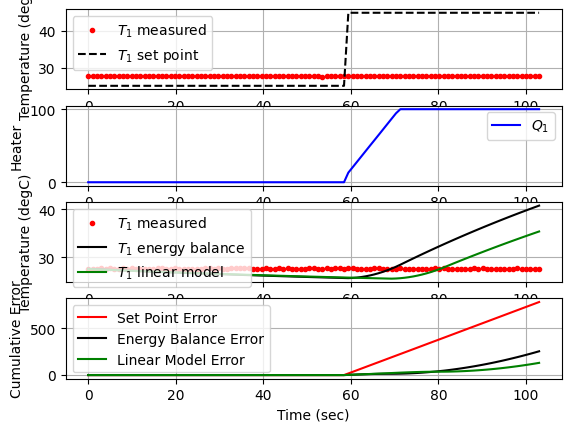

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 105.0  45.00  27.61 100.00   5.82  88.63   0.00


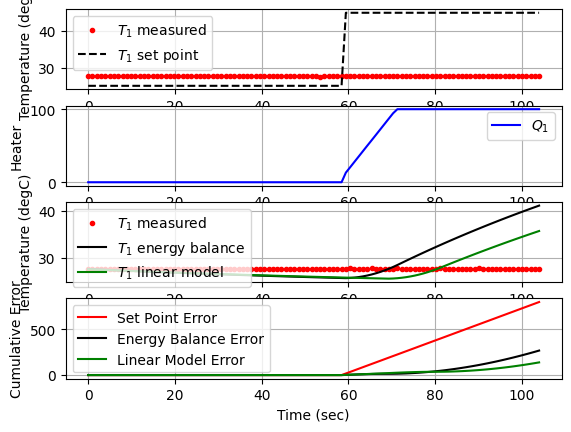

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 106.0  45.00  27.62 100.00   5.82  88.63  -0.00


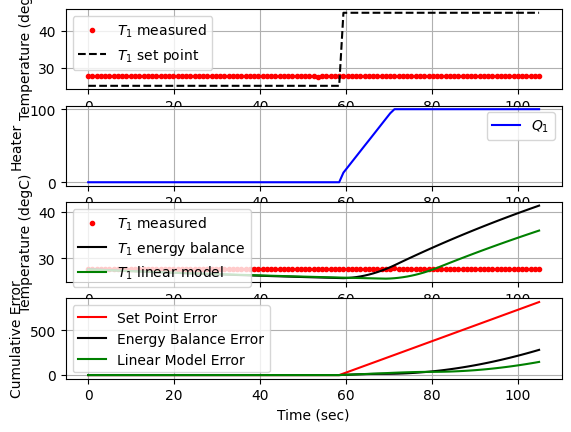

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 107.0  45.00  27.62 100.00   5.82  88.63  -0.00


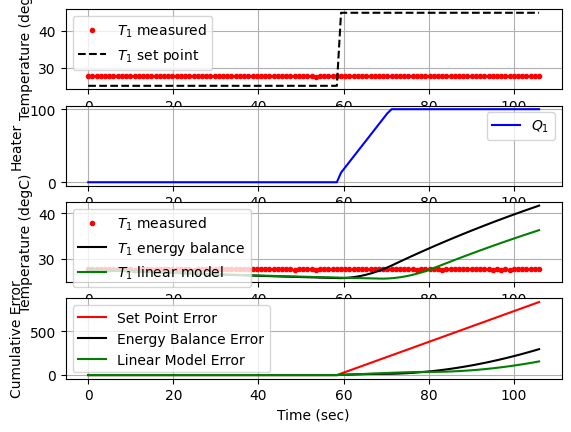

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 107.9  45.00  27.57 100.00   5.83  88.63   0.00


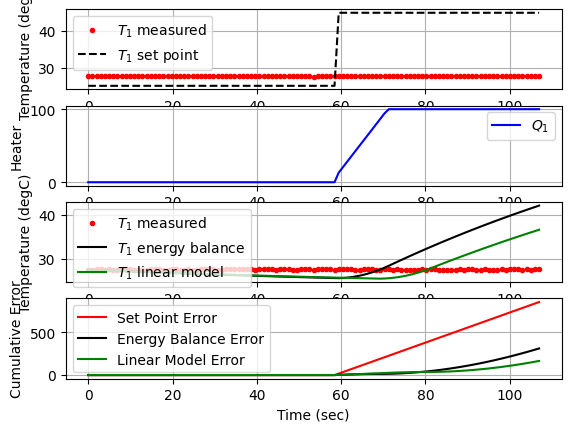

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 108.9  45.00  27.70 100.00   5.79  88.63  -0.01


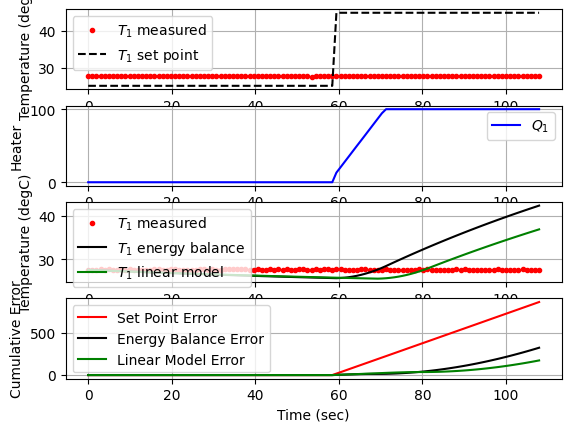

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 109.9  45.00  27.54 100.00   5.84  88.63   0.01


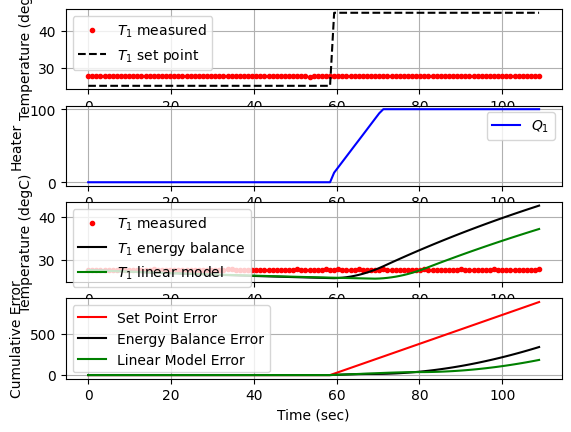

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 110.9  45.00  27.63 100.00   5.81  88.63  -0.00


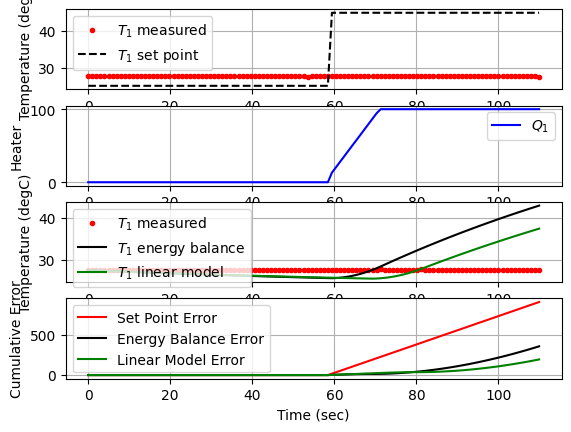

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 111.9  45.00  27.59 100.00   5.83  88.63   0.00


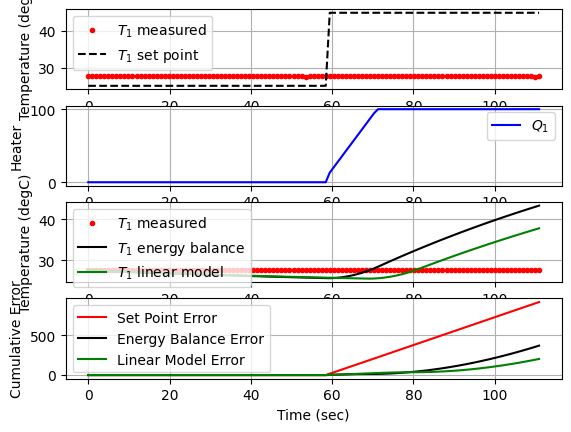

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 112.9  45.00  27.57 100.00   5.83  88.63   0.00


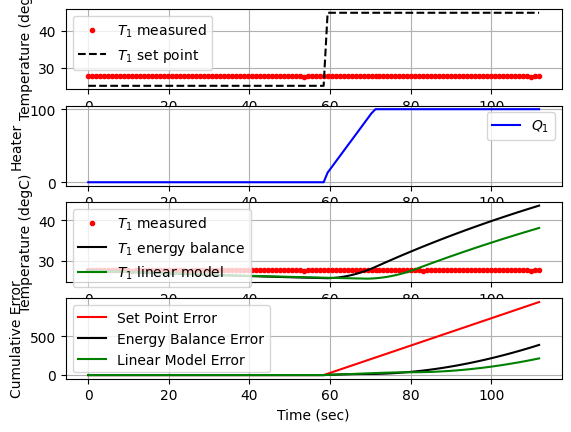

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 113.9  45.00  27.65 100.00   5.81  88.63  -0.00


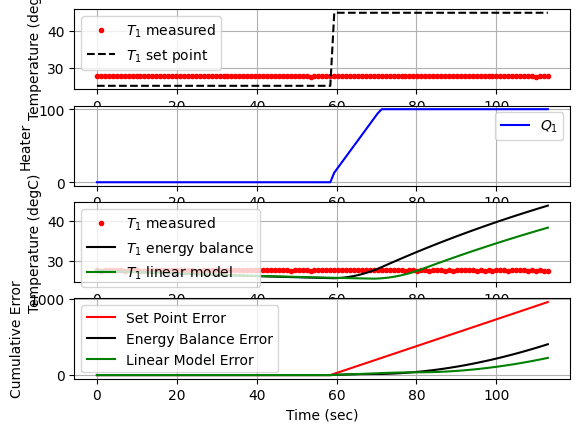

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 114.9  45.00  27.65 100.00   5.81  88.63  -0.00


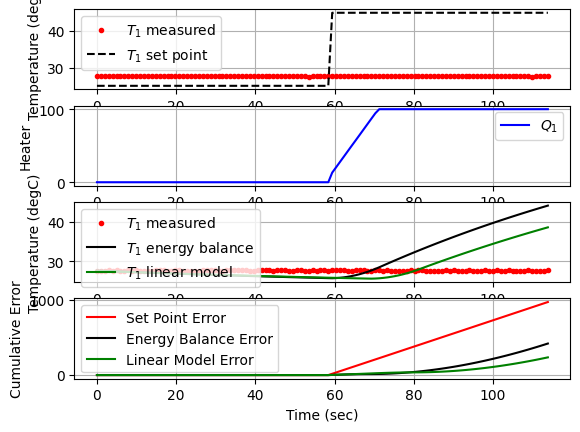

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 115.9  45.00  27.61 100.00   5.82  88.63   0.00


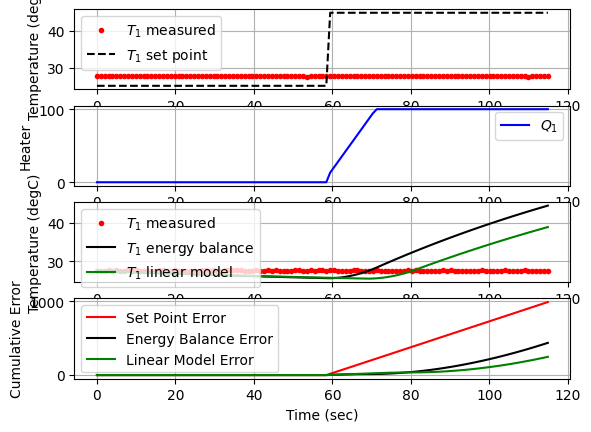

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 116.9  45.00  27.55 100.00   5.84  88.63   0.00


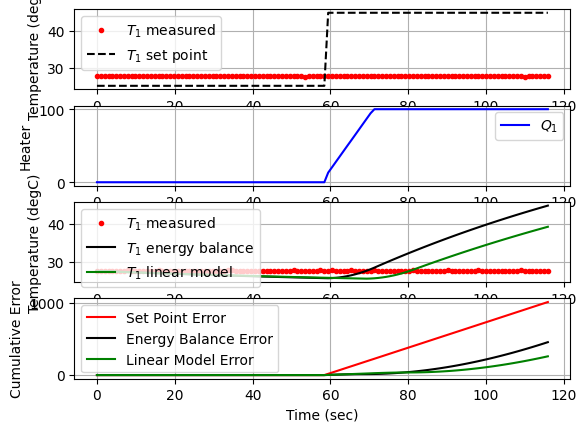

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 117.8  45.00  27.68 100.00   5.80  88.63  -0.01


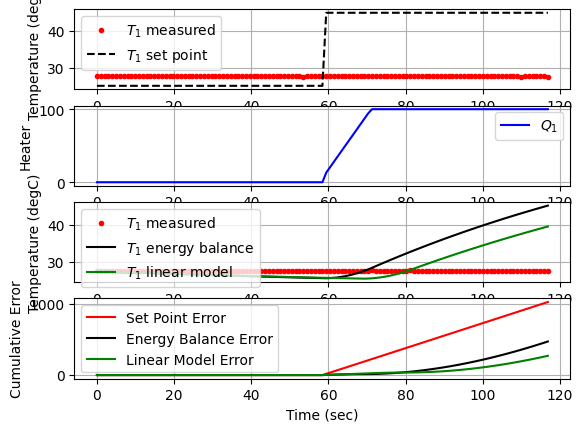

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 118.8  45.00  27.61 100.00   5.82  88.63   0.00


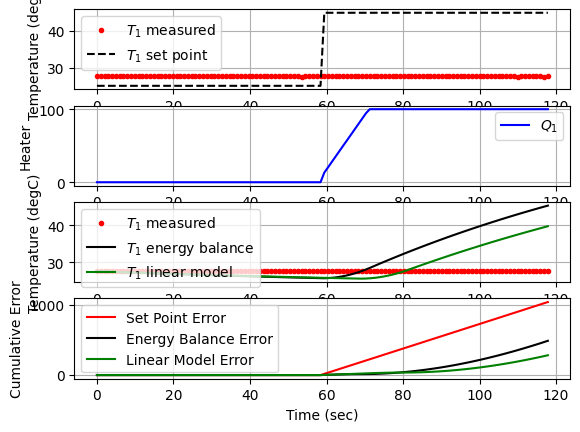

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 119.8  45.00  27.59 100.00   5.83  88.63   0.00


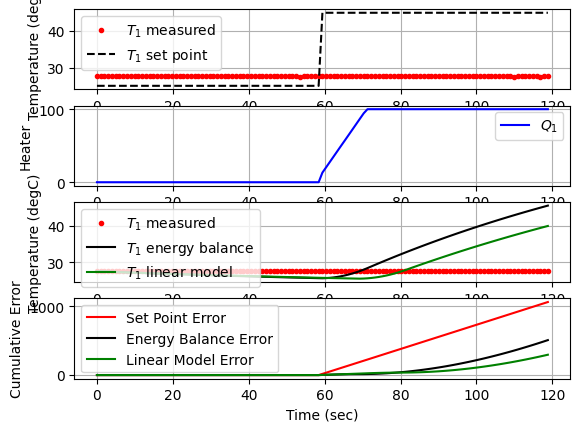

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 120.8  45.00  27.57 100.00   5.83  88.63   0.00


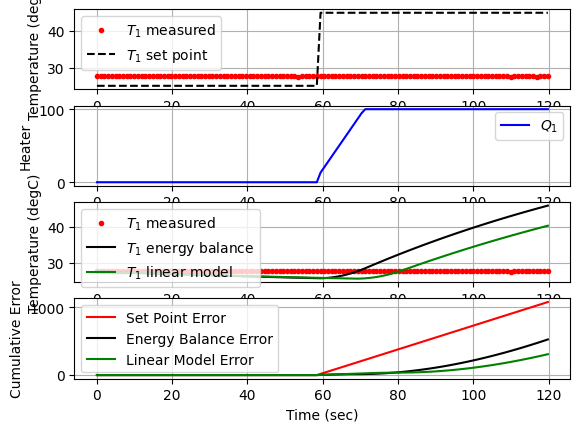

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 121.8  45.00  27.63 100.00   5.81  88.63  -0.00


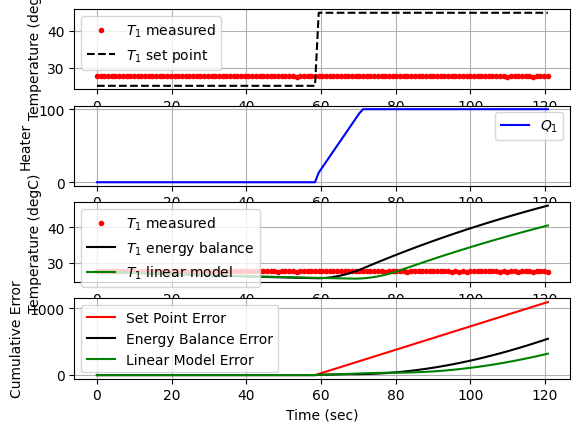

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 122.8  45.00  27.63 100.00   5.81  88.63  -0.00


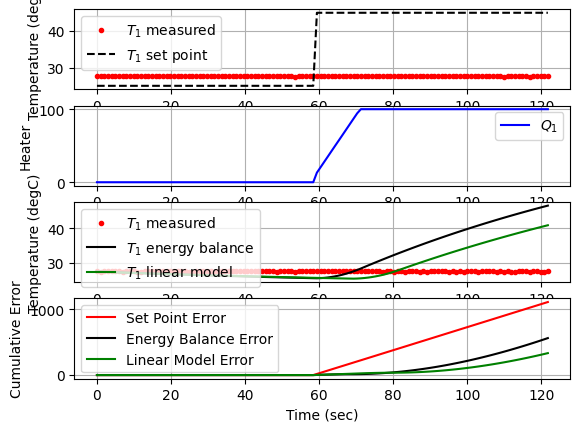

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 123.8  45.00  27.56 100.00   5.84  88.63   0.00


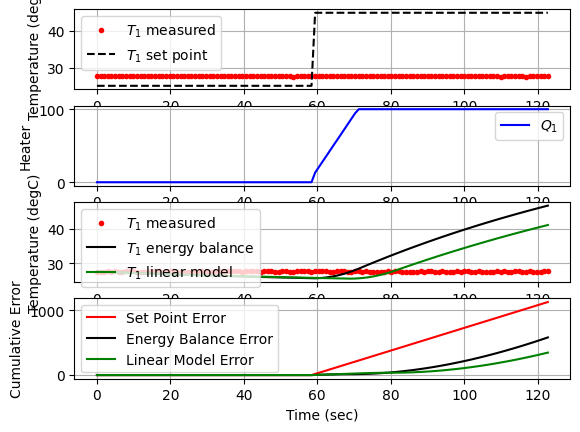

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 124.8  45.00  27.67 100.00   5.80  88.63  -0.01


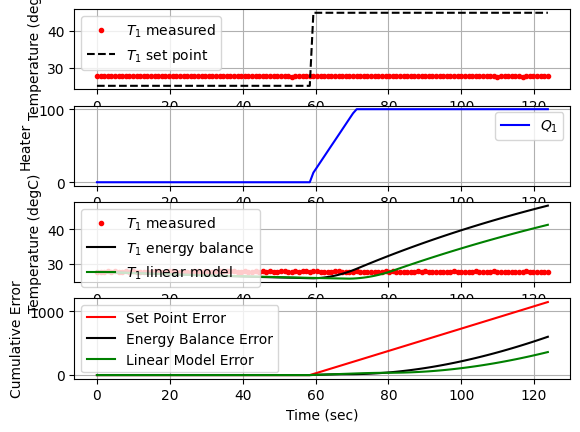

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 125.8  45.00  27.54 100.00   5.84  88.63   0.01


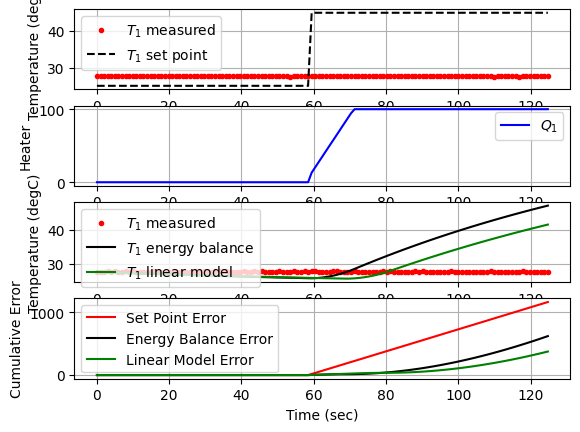

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 126.8  45.00  27.72 100.00   5.78  88.63  -0.01


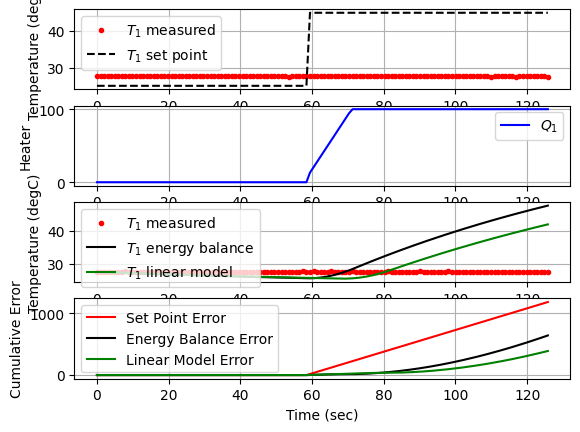

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 127.7  45.00  27.66 100.00   5.80  88.63   0.00


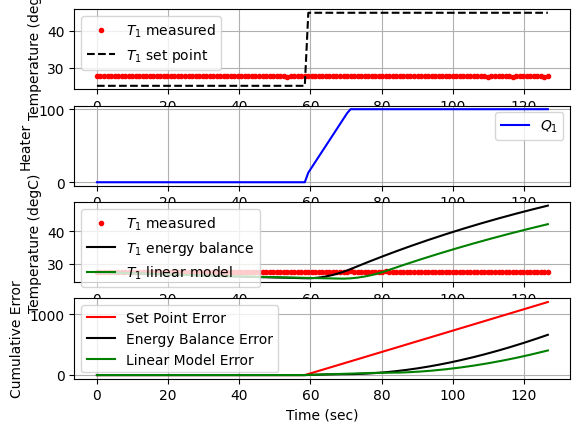

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 128.7  45.00  27.58 100.00   5.83  88.63   0.00


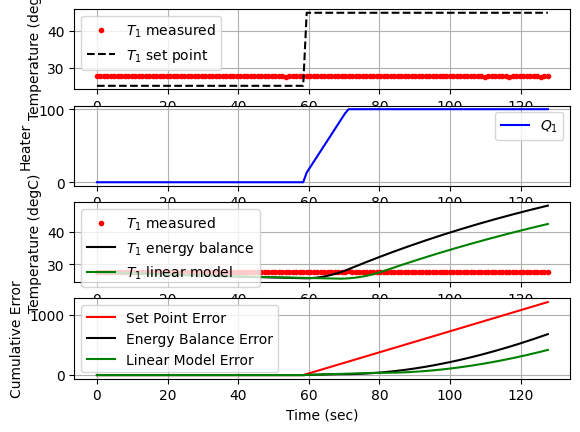

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 129.7  45.00  27.57 100.00   5.83  88.63   0.00


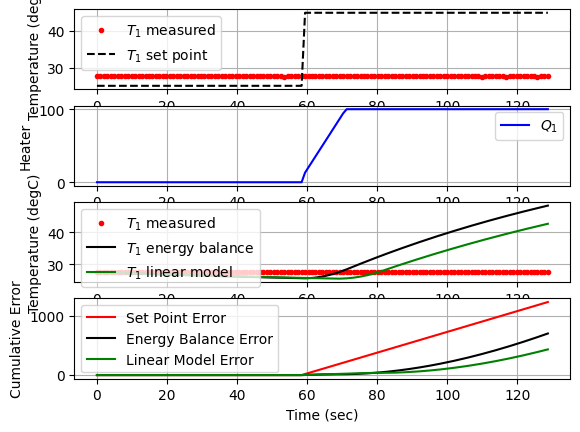

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 130.7  45.00  27.57 100.00   5.83  88.63  -0.00


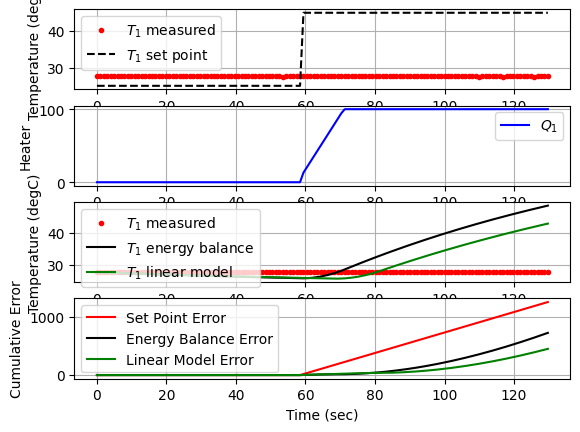

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 131.7  45.00  27.63 100.00   5.81  88.63  -0.00


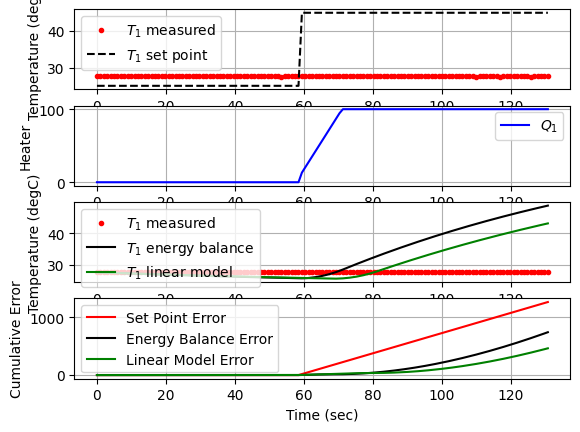

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 132.7  45.00  27.64 100.00   5.81  88.63  -0.00


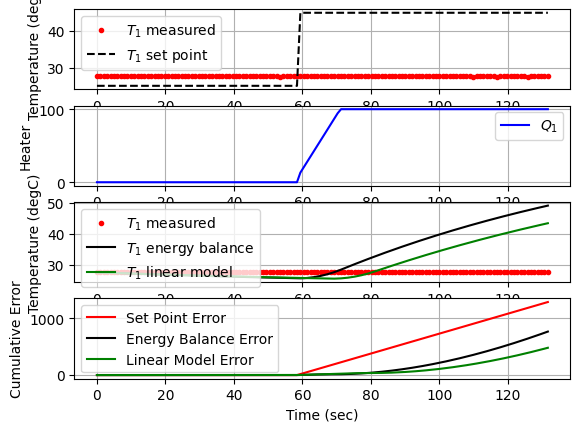

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 133.7  45.00  27.62 100.00   5.82  88.63   0.00


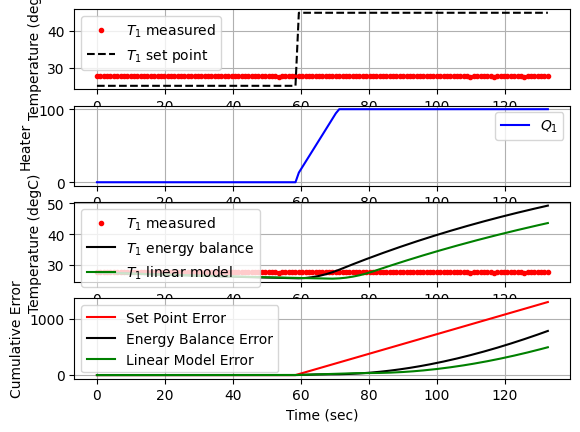

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 134.7  45.00  27.68 100.00   5.80  88.63  -0.00


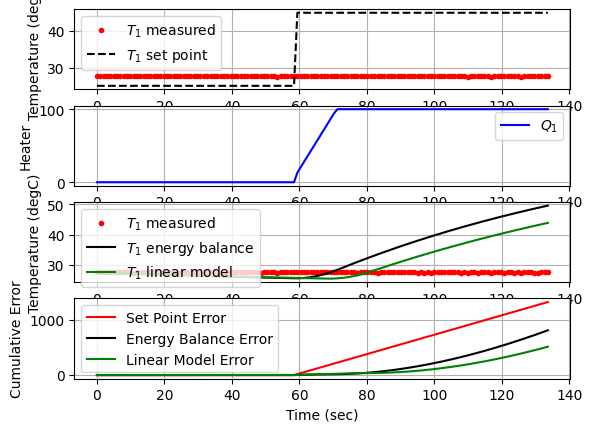

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 135.7  45.00  27.58 100.00   5.83  88.63   0.00


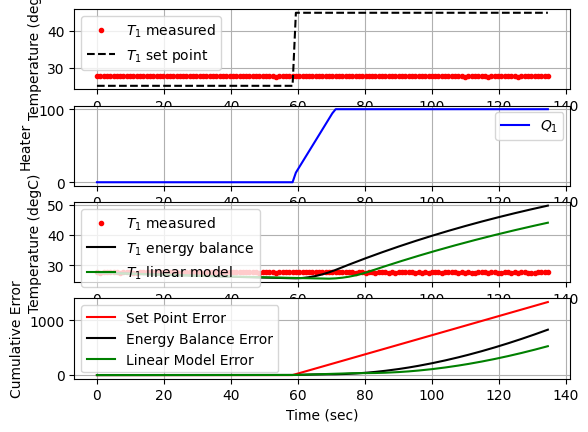

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 136.7  45.00  27.59 100.00   5.83  88.63  -0.00


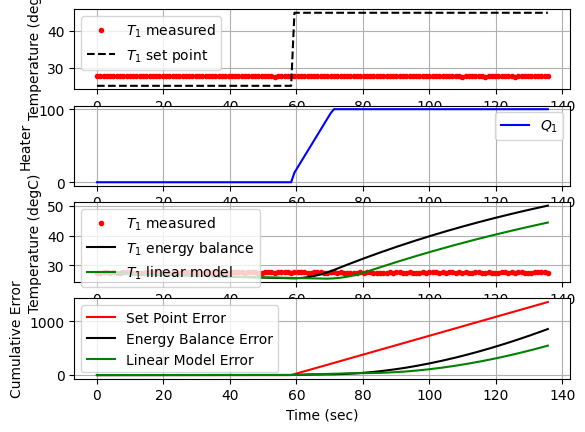

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 137.7  45.00  27.62 100.00   5.82  88.63  -0.00


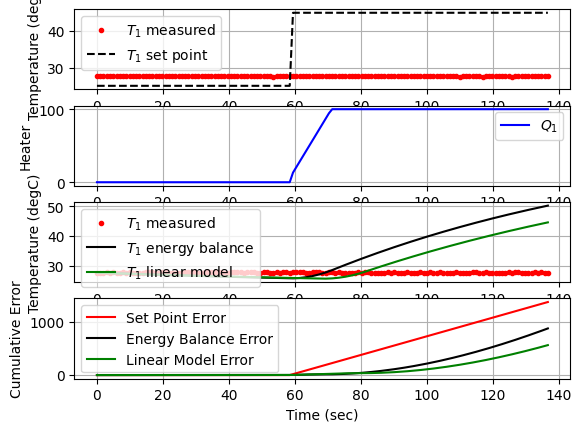

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 138.6  45.00  27.57 100.00   5.83  88.63   0.00


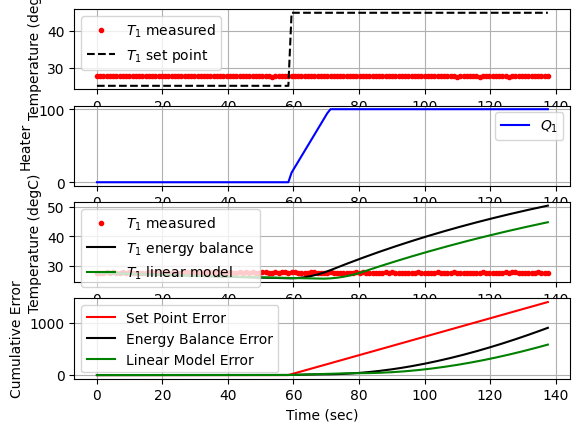

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 139.6  45.00  27.57 100.00   5.83  88.63  -0.00


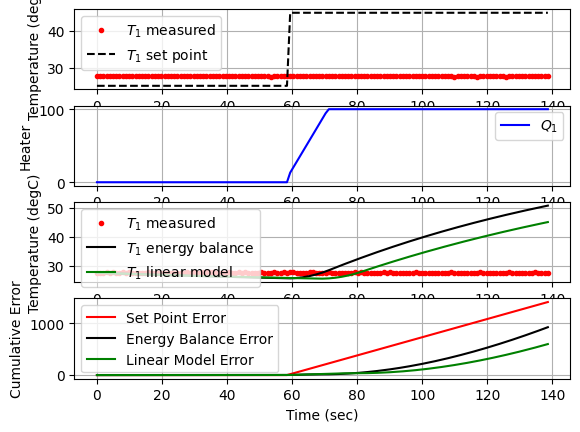

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 140.6  45.00  27.59 100.00   5.83  88.63  -0.00


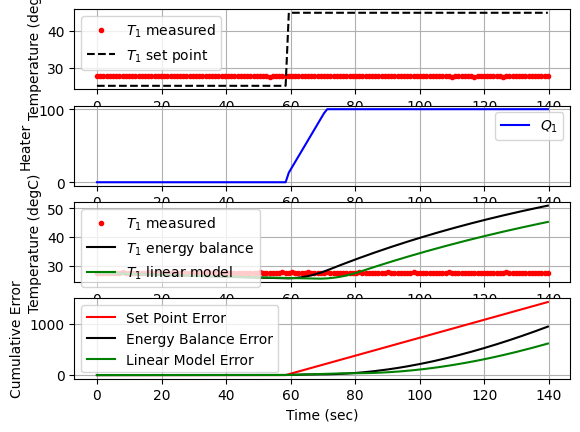

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 141.6  45.00  27.53 100.00   5.85  88.63   0.00


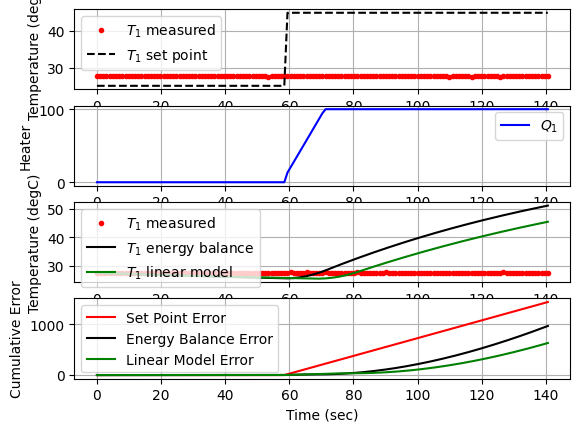

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 142.6  45.00  27.58 100.00   5.83  88.63  -0.00


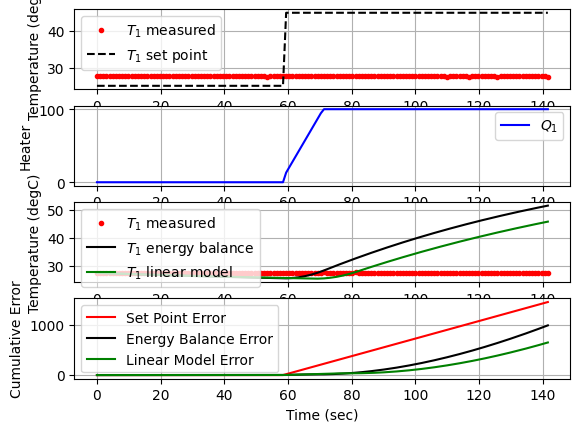

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 143.6  45.00  27.60 100.00   5.82  88.63  -0.00


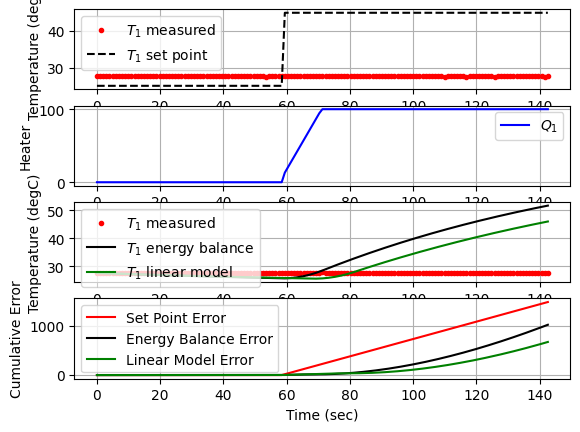

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 144.6  45.00  27.61 100.00   5.82  88.63  -0.00


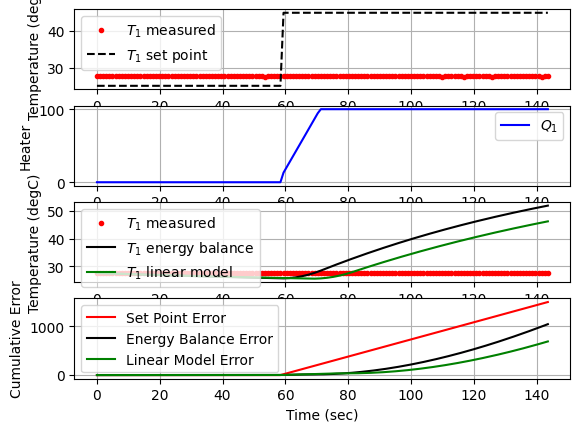

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 145.6  45.00  27.58 100.00   5.83  88.63   0.00


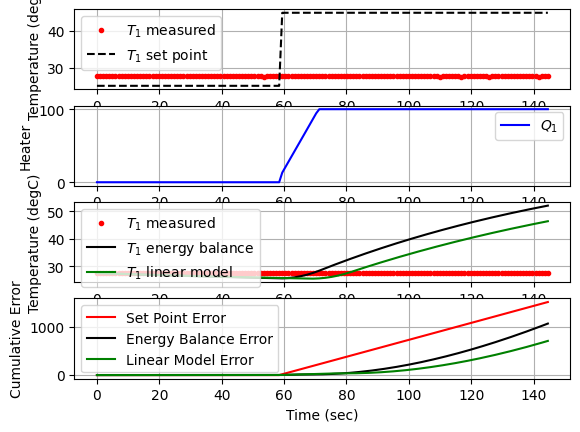

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 146.6  45.00  27.68 100.00   5.80  88.63  -0.00


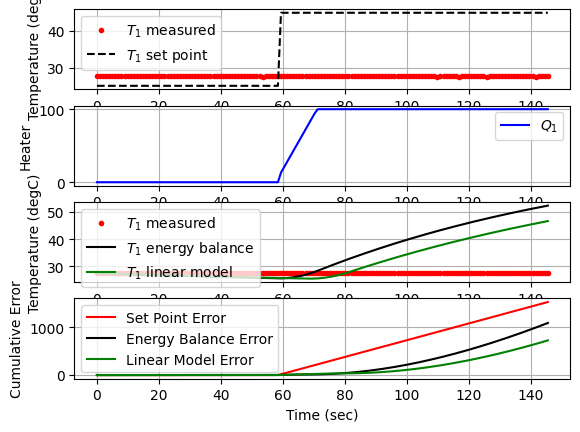

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 147.6  45.00  27.52 100.00   5.85  88.63   0.01


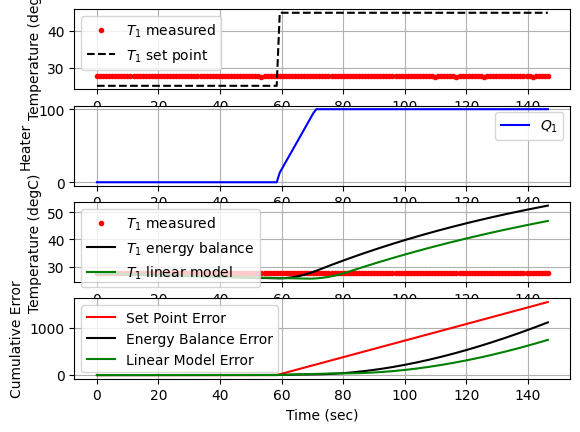

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 148.5  45.00  27.59 100.00   5.83  88.63  -0.00


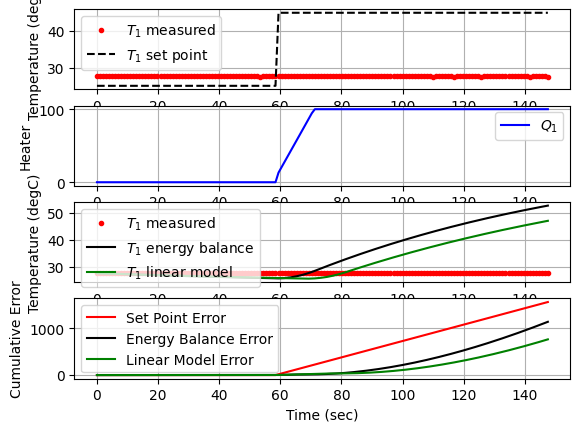

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 149.5  45.00  27.66 100.00   5.80  88.63  -0.00


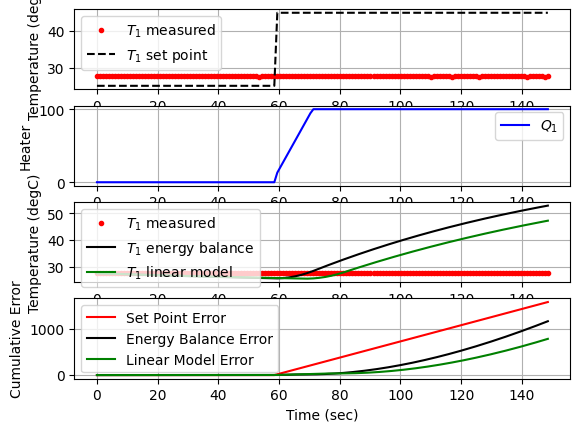

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 150.5  45.00  27.55 100.00   5.84  88.63   0.01


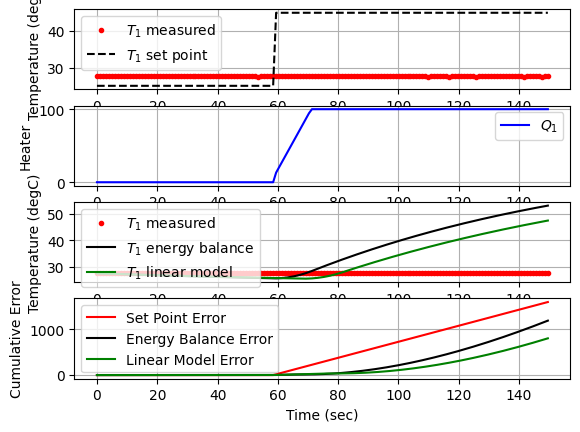

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 151.5  45.00  27.65 100.00   5.81  88.63  -0.00


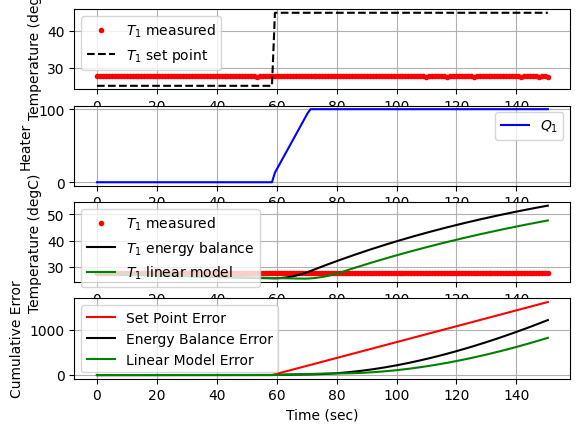

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 152.5  45.00  27.65 100.00   5.81  88.63  -0.00


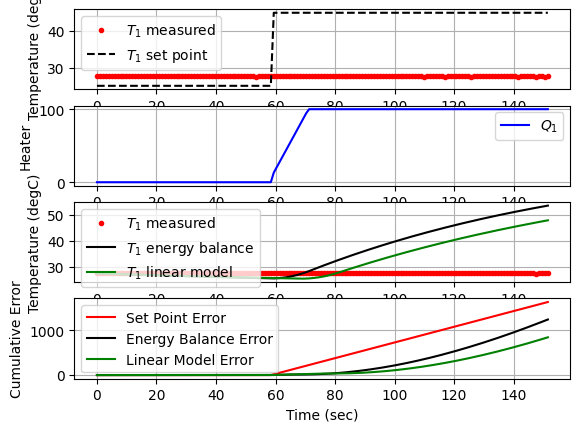

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 153.5  45.00  27.58 100.00   5.83  88.63   0.00


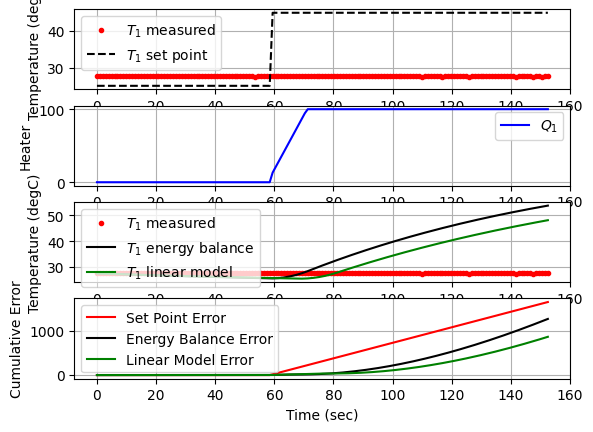

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 154.5  45.00  27.60 100.00   5.82  88.63  -0.00


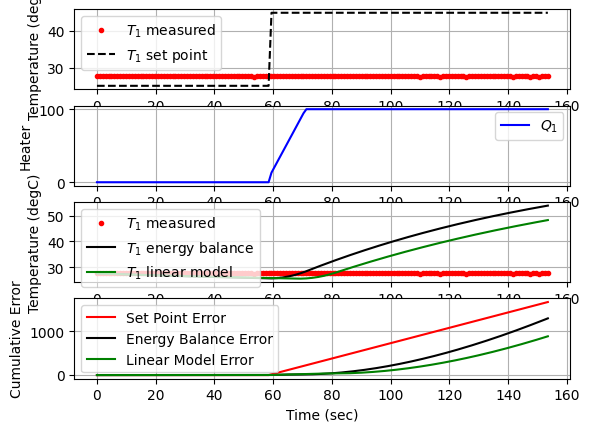

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 155.5  45.00  27.59 100.00   5.83  88.63   0.00


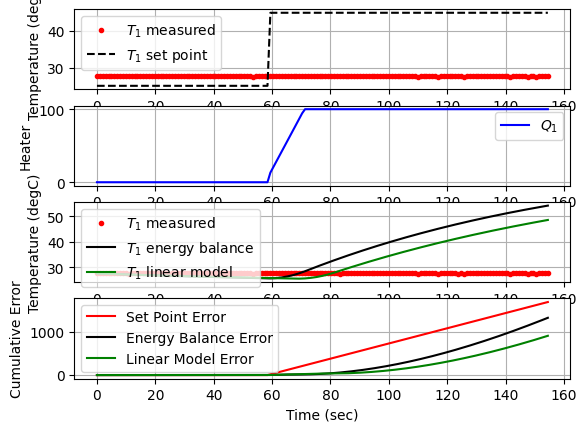

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 156.5  45.00  27.63 100.00   5.81  88.63  -0.00


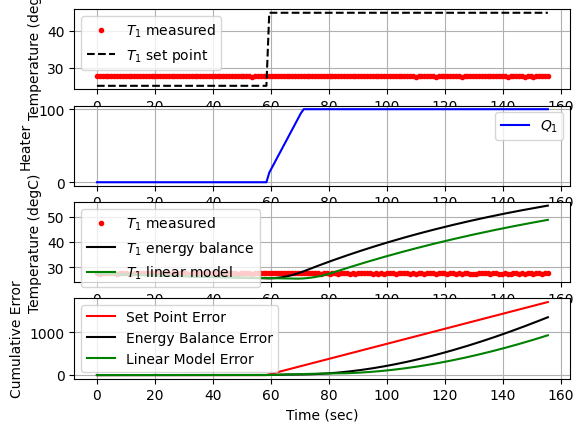

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 157.5  45.00  27.68 100.00   5.80  88.63  -0.00


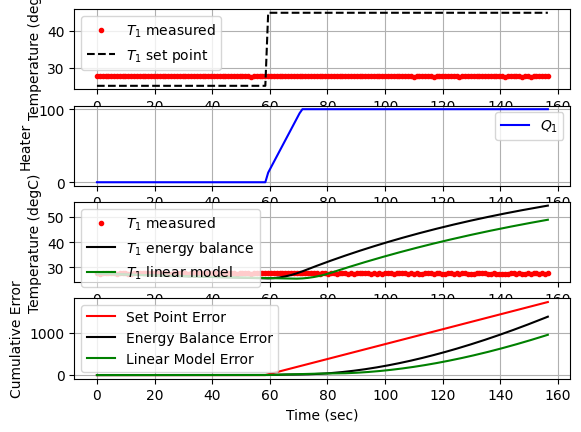

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 158.4  45.00  27.56 100.00   5.84  88.63   0.01


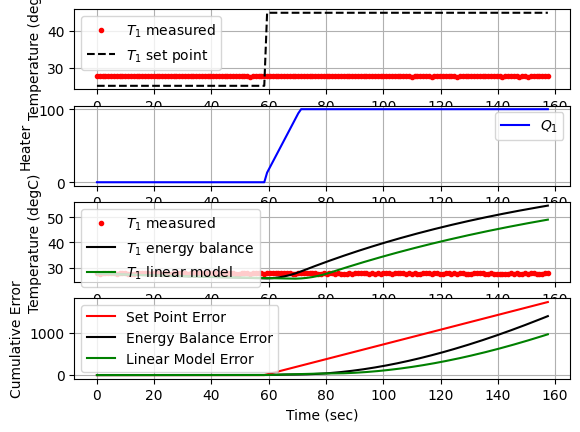

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 159.4  45.00  27.61 100.00   5.82  88.63  -0.00


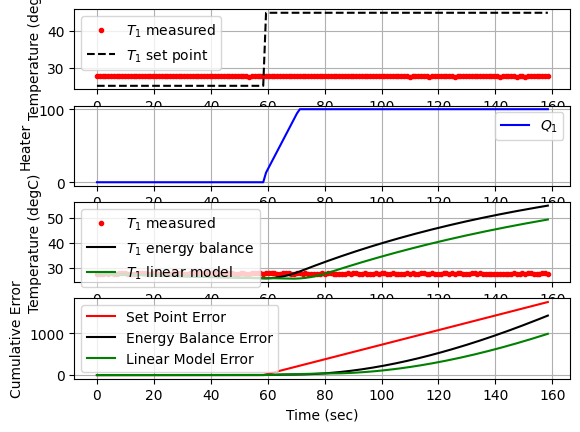

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 160.4  45.00  27.61 100.00   5.82  88.63  -0.00


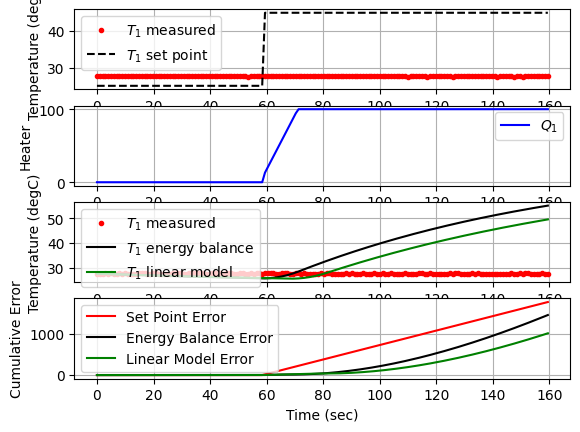

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 161.4  45.00  27.65 100.00   5.81  88.63  -0.00


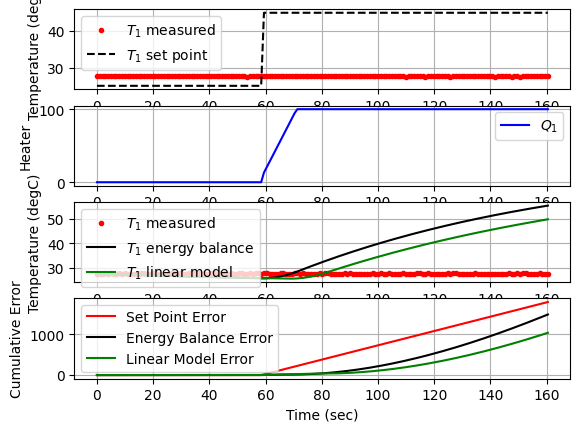

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 162.4  45.00  27.57 100.00   5.83  88.63   0.00


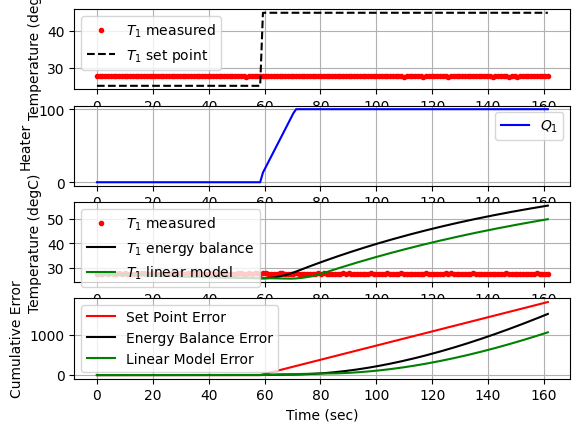

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 163.4  45.00  27.57 100.00   5.83  88.63  -0.00


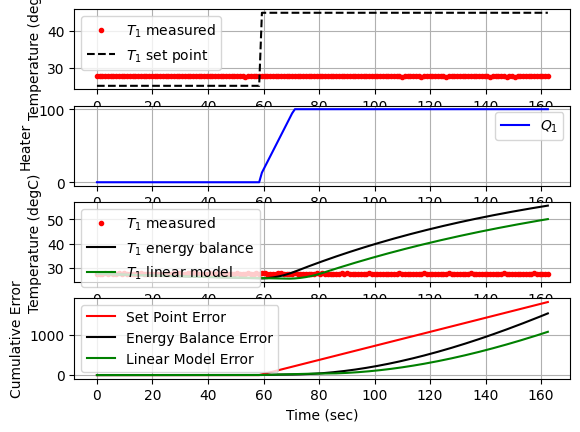

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 164.4  45.00  27.59 100.00   5.83  88.63  -0.00


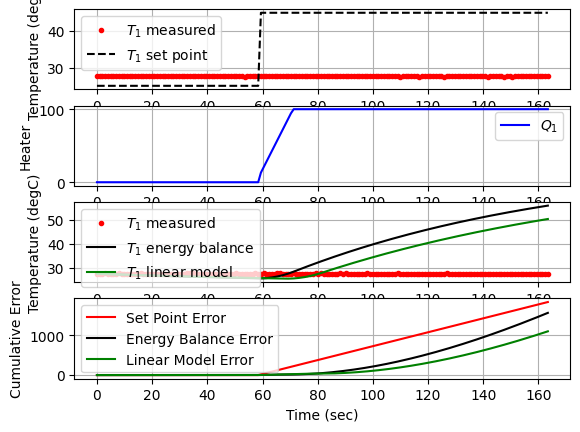

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 165.4  45.00  27.63 100.00   5.81  88.63  -0.00


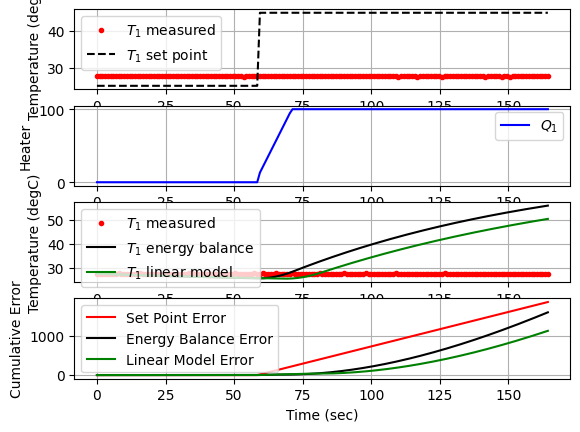

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 166.4  45.00  27.56 100.00   5.84  88.63   0.00


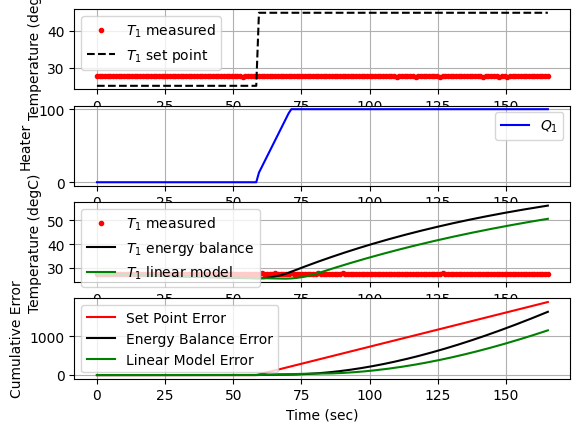

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 167.4  45.00  27.63 100.00   5.81  88.63  -0.00


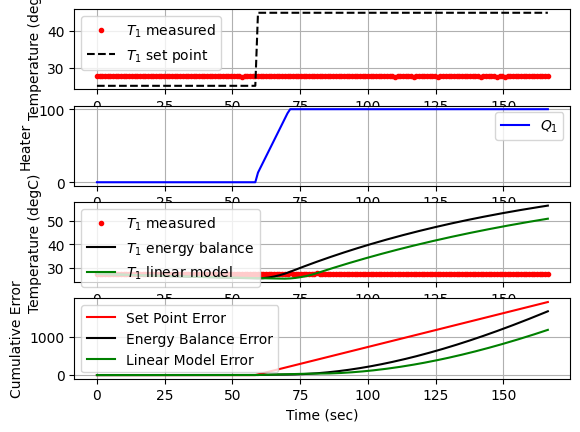

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 168.4  45.00  27.60 100.00   5.82  88.63   0.00


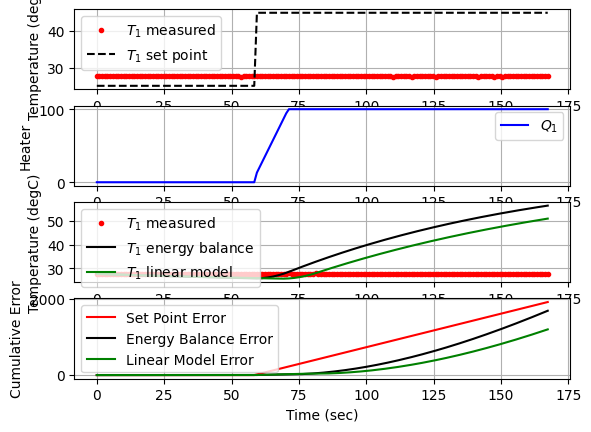

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 169.3  45.00  27.59 100.00   5.83  88.63   0.00


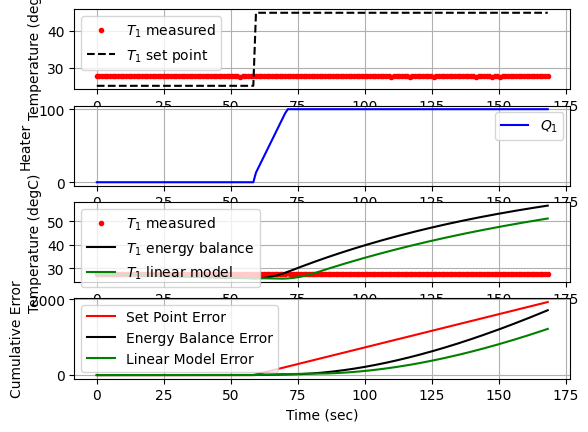

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 170.3  45.00  27.62 100.00   5.82  88.63  -0.00


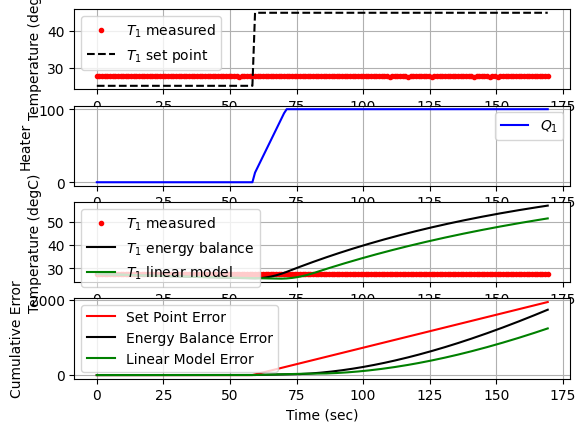

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 171.3  45.00  27.52 100.00   5.85  88.63   0.00


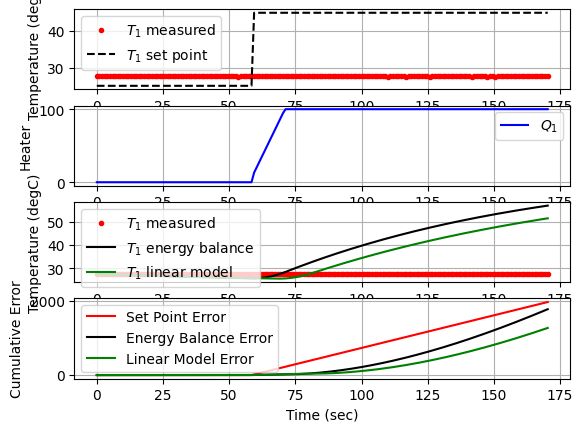

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 172.3  45.00  27.61 100.00   5.82  88.63  -0.00


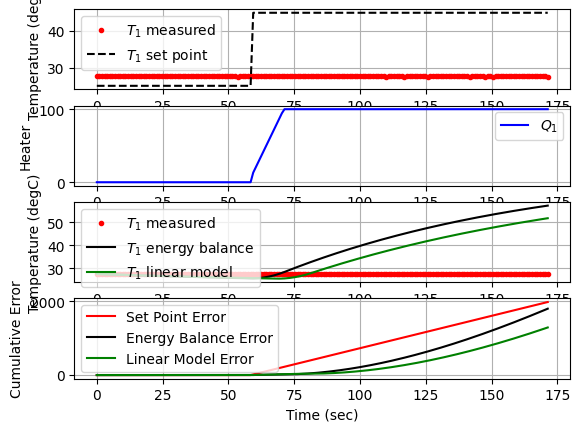

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 173.3  45.00  27.61 100.00   5.82  88.63  -0.00


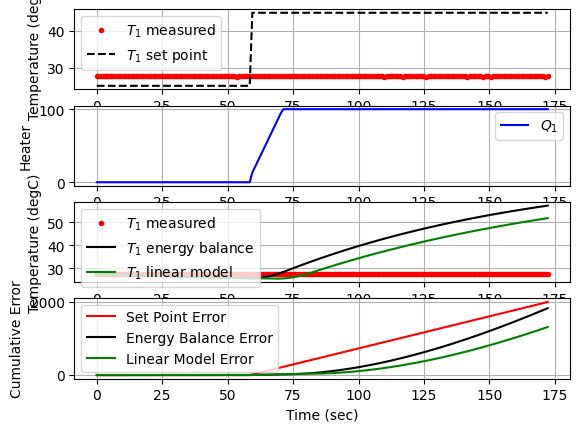

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 174.3  45.00  27.56 100.00   5.84  88.63   0.00


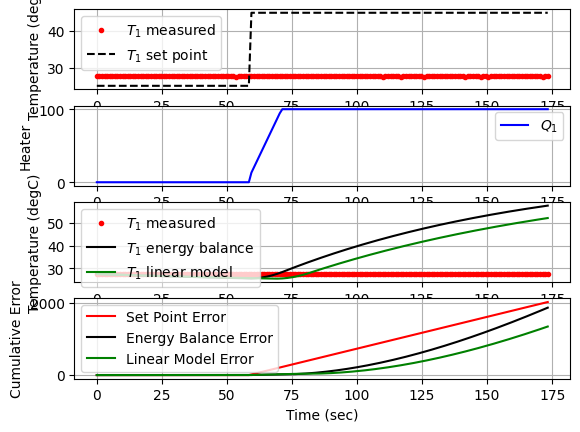

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 175.3  45.00  27.61 100.00   5.82  88.63  -0.00


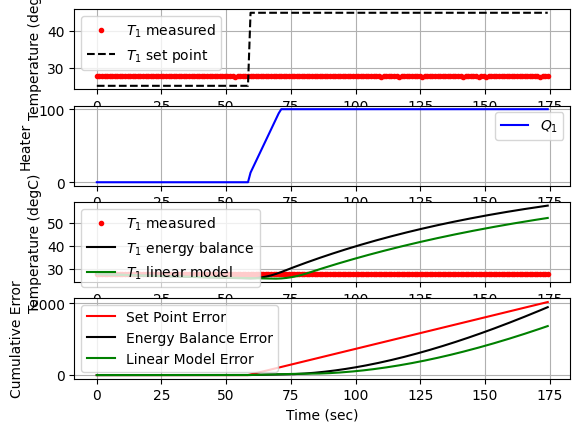

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 176.3  45.00  27.66 100.00   5.80  88.63  -0.00


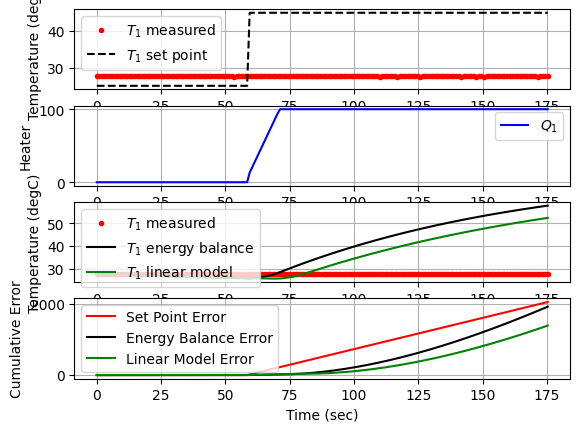

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 177.3  45.00  27.63 100.00   5.81  88.63   0.00


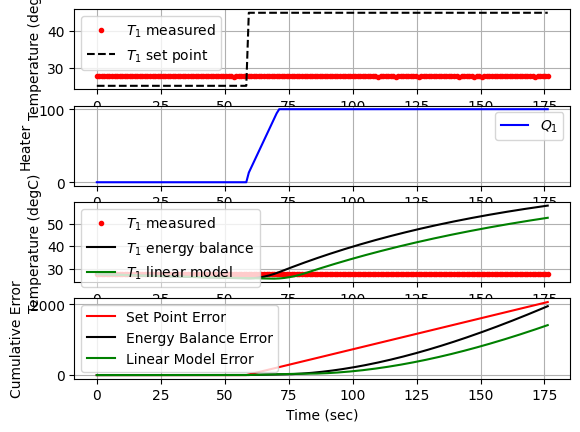

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 178.3  45.00  27.57 100.00   5.83  88.63   0.00


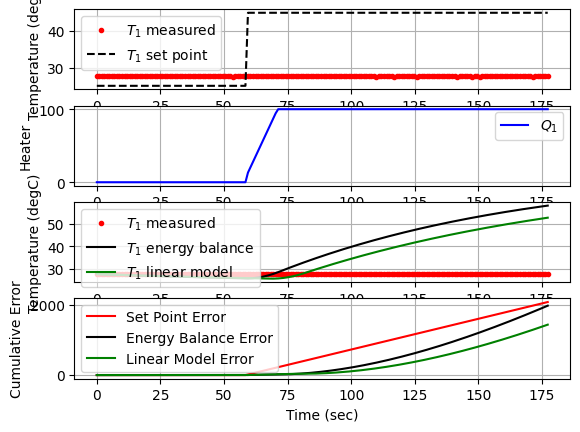

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 179.2  45.00  27.63 100.00   5.81  88.63  -0.00


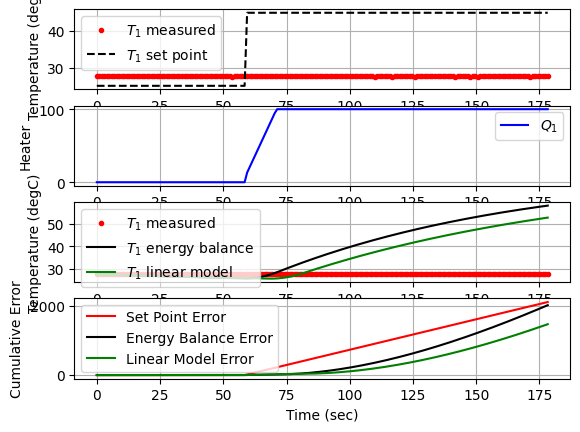

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 180.2  45.00  27.59 100.00   5.83  88.63   0.00


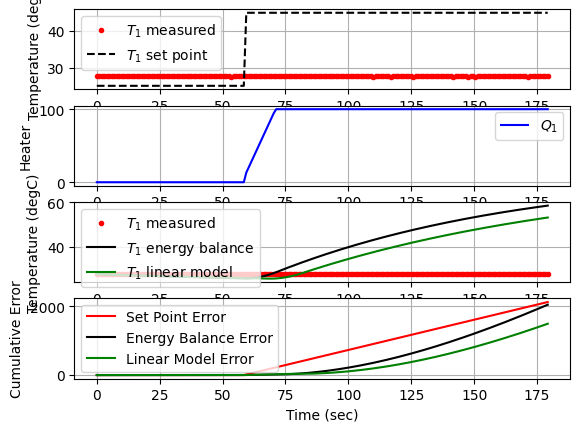

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 181.2  45.00  27.53 100.00   5.85  88.63   0.00


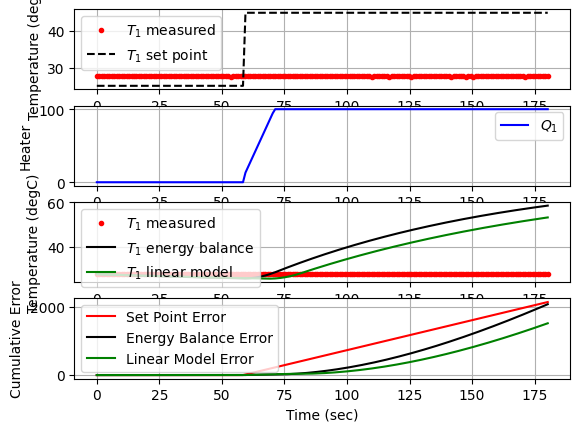

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 182.2  45.00  27.66 100.00   5.80  88.63  -0.01


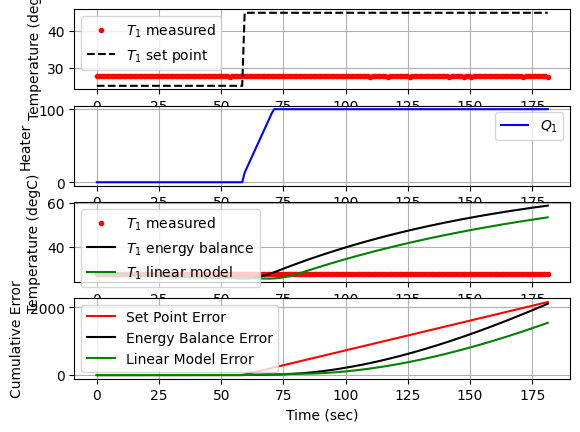

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 183.2  45.00  27.60 100.00   5.82  88.63   0.00


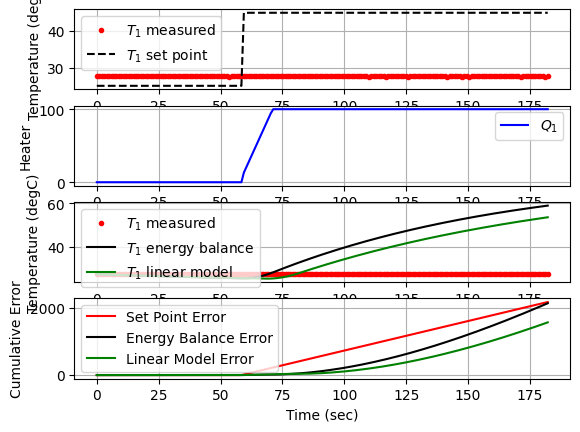

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 184.2  45.00  27.67 100.00   5.80  88.63  -0.00


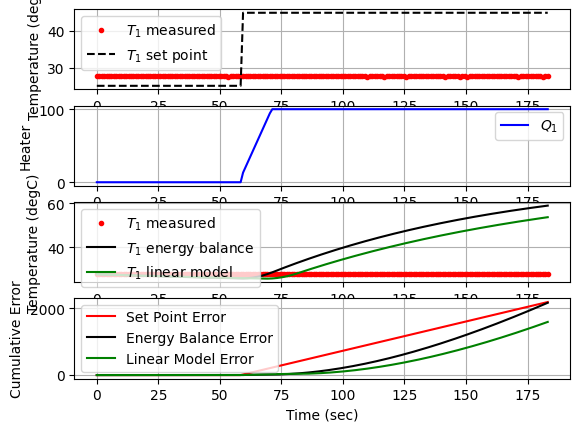

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 185.2  45.00  27.52 100.00   5.85  88.63   0.01


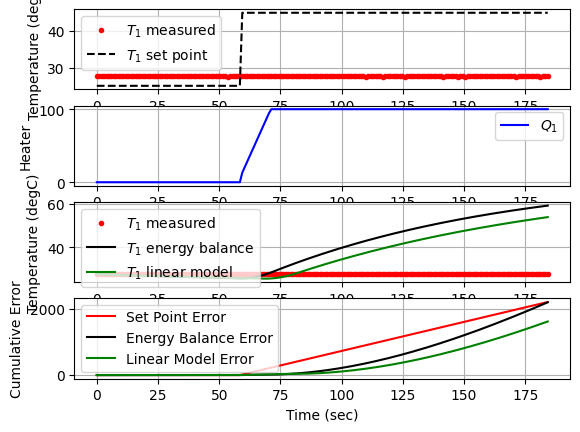

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 186.2  45.00  27.56 100.00   5.84  88.63  -0.00


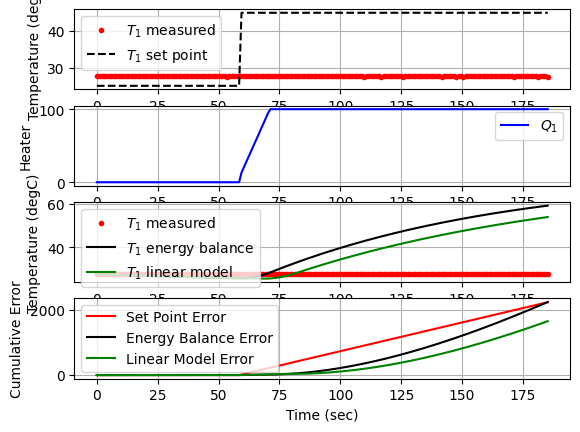

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 187.2  45.00  27.62 100.00   5.82  88.63  -0.00


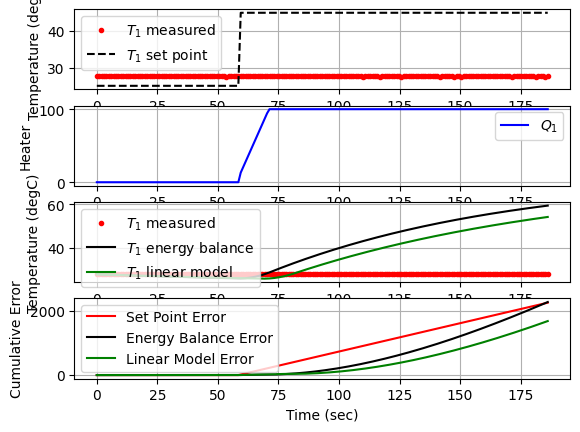

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 188.2  45.00  27.52 100.00   5.85  88.63   0.00


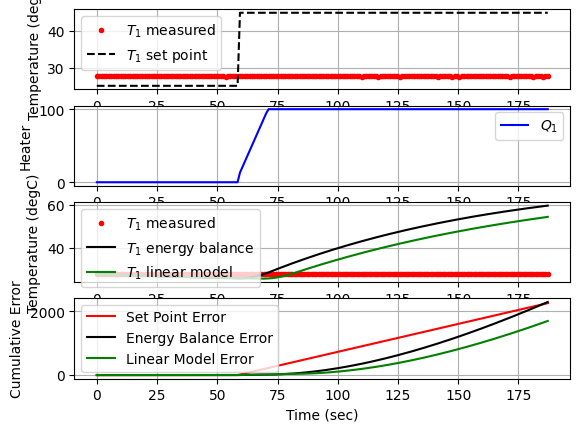

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 189.1  45.00  27.60 100.00   5.82  88.63  -0.00


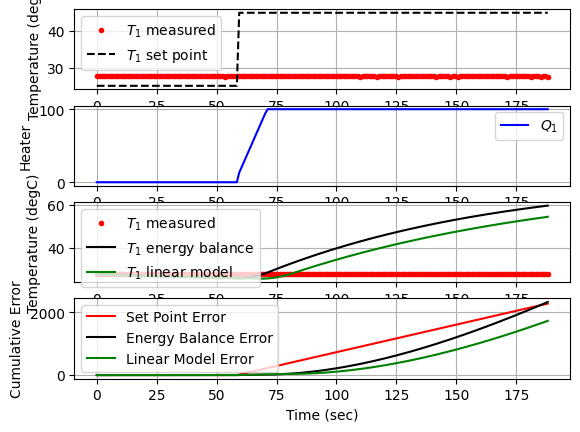

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 190.1  45.00  27.66 100.00   5.80  88.63  -0.00


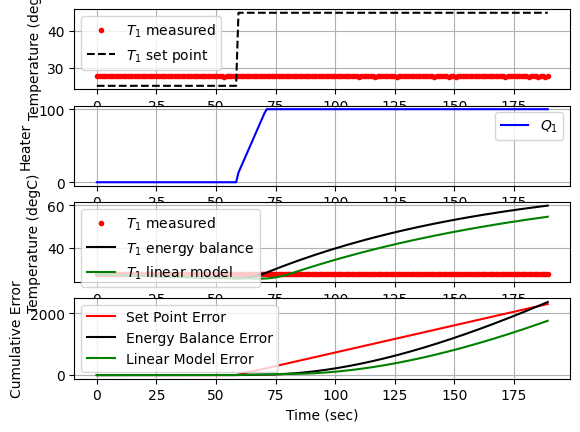

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 191.1  45.00  27.61 100.00   5.82  88.63   0.00


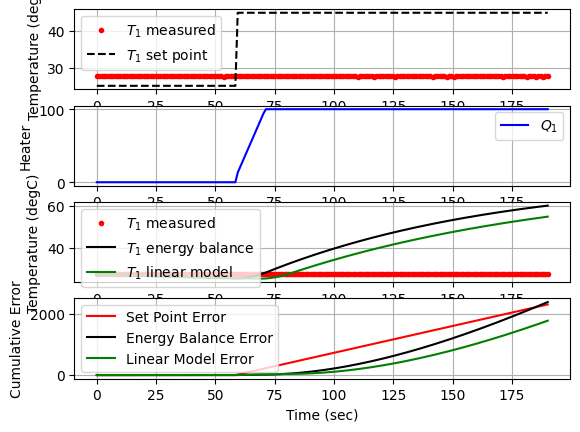

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 192.1  45.00  27.51 100.00   5.85  88.63   0.00


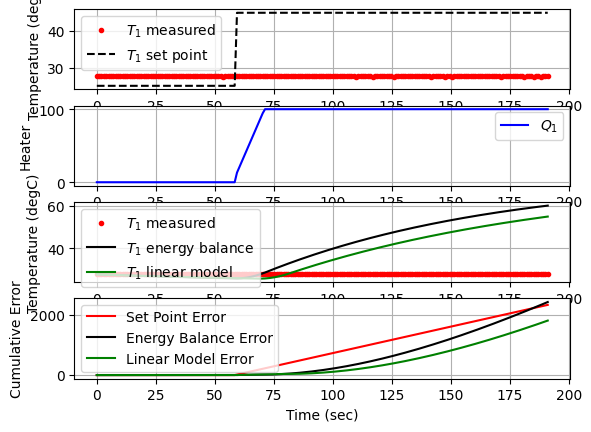

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
 193.1  45.00  27.61 100.00   5.82  88.63  -0.00


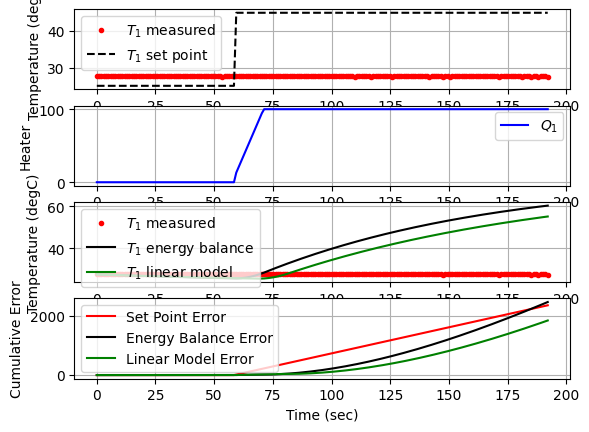

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 194.1  45.00  27.63 100.00   5.81  88.63  -0.00


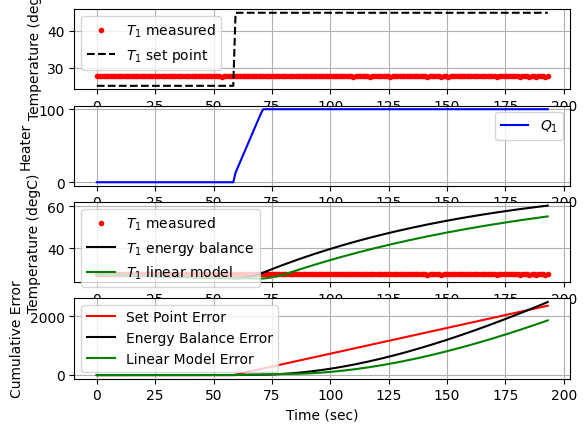

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 195.1  45.00  27.60 100.00   5.82  88.63   0.00


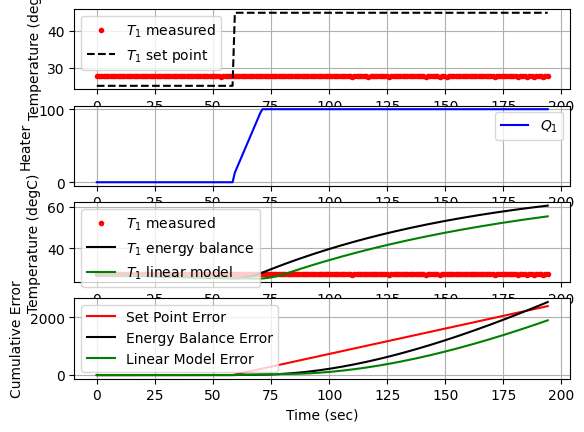

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 196.1  45.00  27.64 100.00   5.81  88.63  -0.00


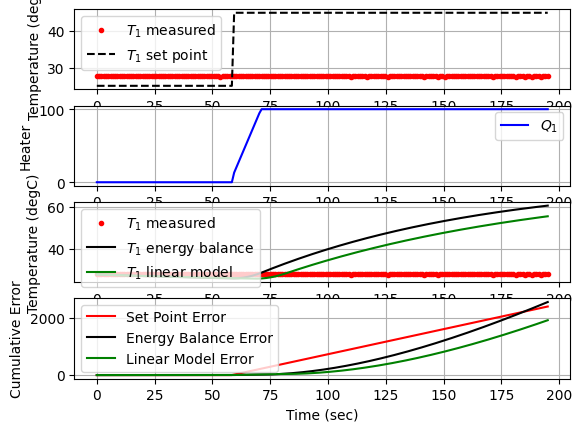

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 197.1  45.00  27.62 100.00   5.82  88.63   0.00


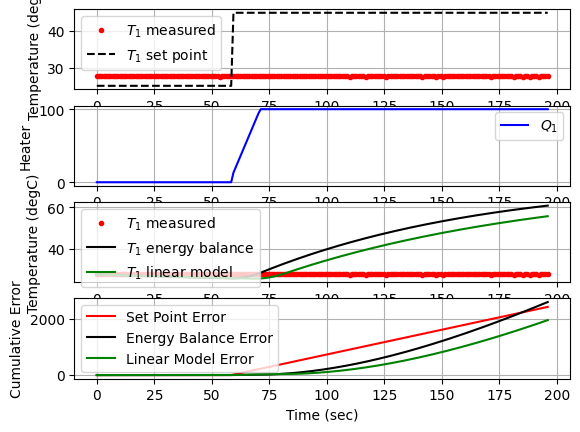

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 198.1  45.00  27.65 100.00   5.81  88.63  -0.00


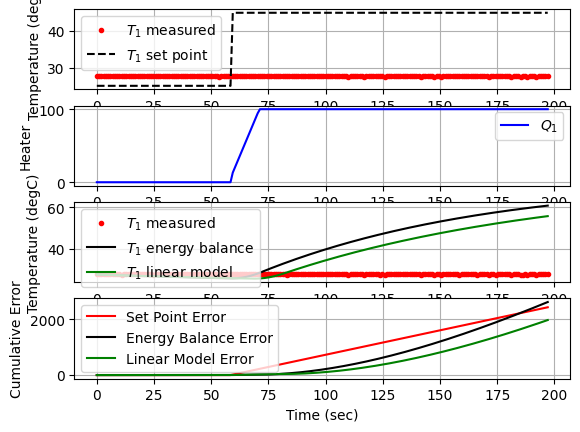

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 199.1  45.00  27.57 100.00   5.83  88.63   0.00


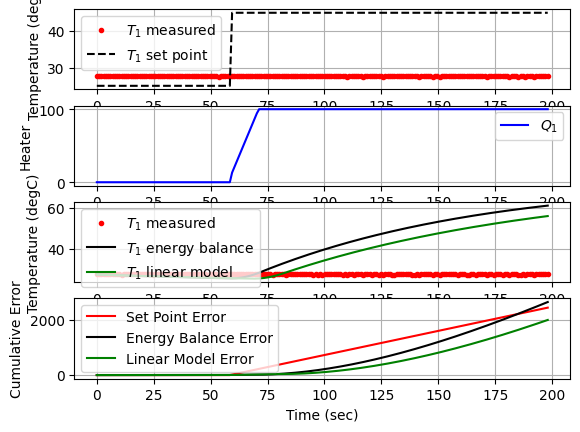

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 200.0  45.00  27.63 100.00   5.81  88.63  -0.00


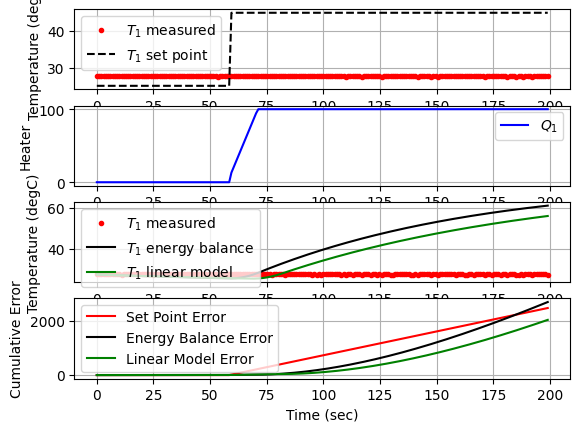

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 201.0  45.00  27.62 100.00   5.82  88.63   0.00


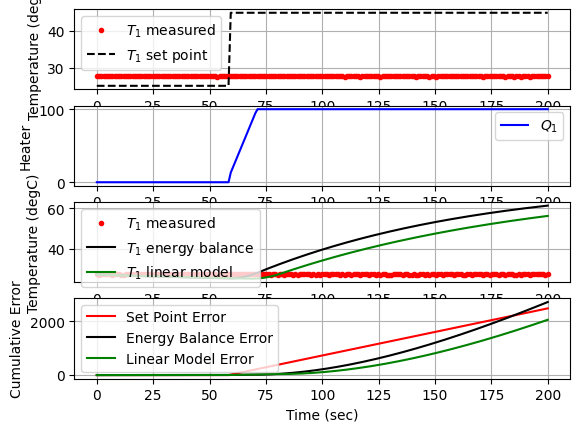

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 202.0  45.00  27.59 100.00   5.83  88.63   0.00


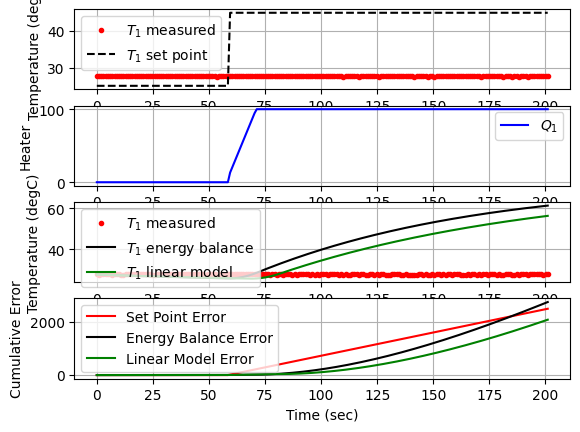

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 203.0  45.00  27.60 100.00   5.82  88.63  -0.00


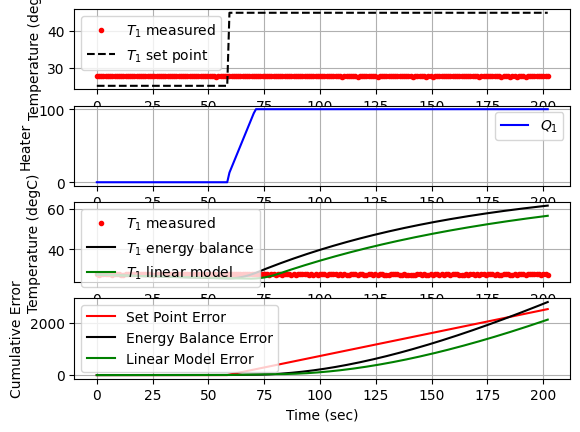

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 204.0  45.00  27.59 100.00   5.83  88.63   0.00


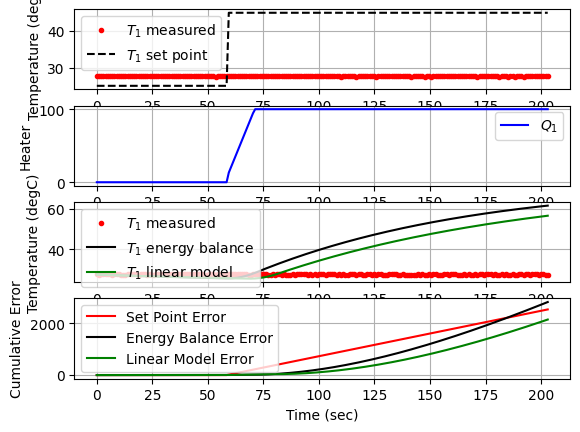

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 205.0  45.00  27.61 100.00   5.82  88.63  -0.00


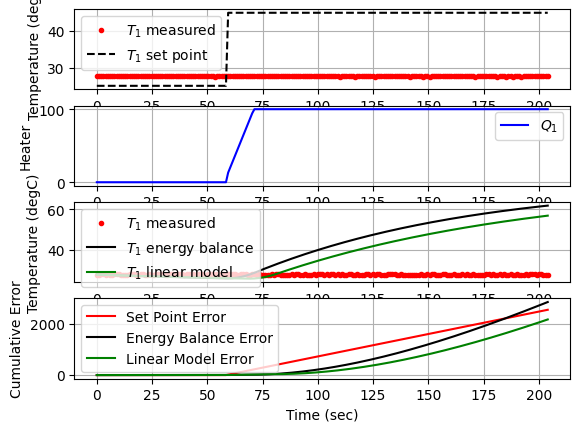

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 206.0  45.00  27.61 100.00   5.82  88.63  -0.00


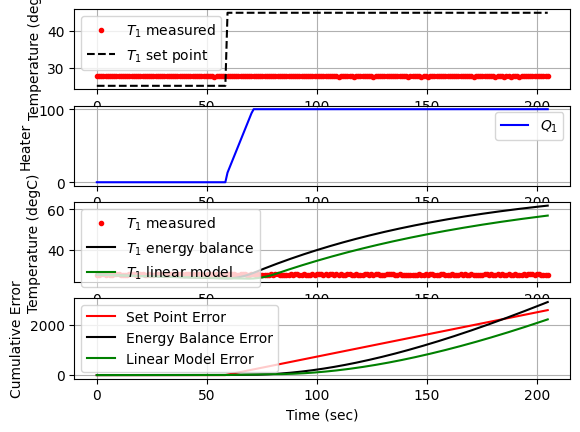

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 207.0  45.00  27.58 100.00   5.83  88.63   0.00


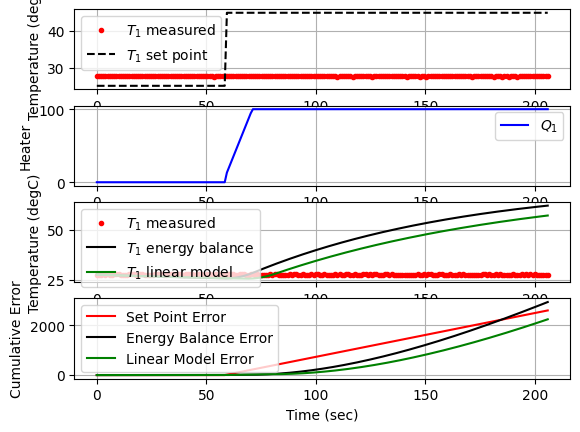

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 208.0  45.00  27.58 100.00   5.83  88.63  -0.00


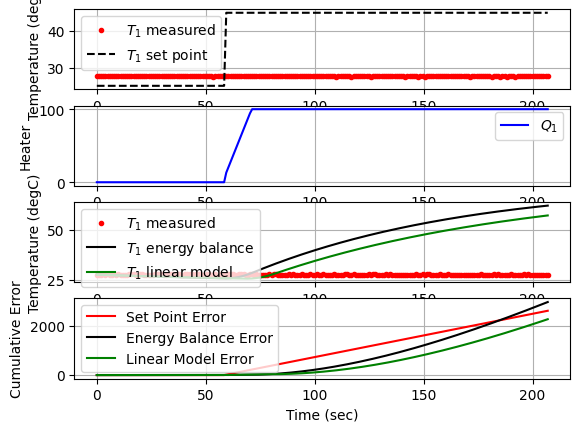

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 209.0  45.00  27.56 100.00   5.84  88.63   0.00


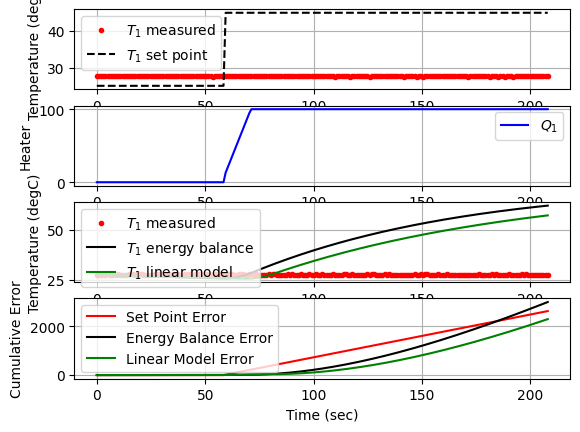

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 209.9  45.00  27.60 100.00   5.82  88.63  -0.00


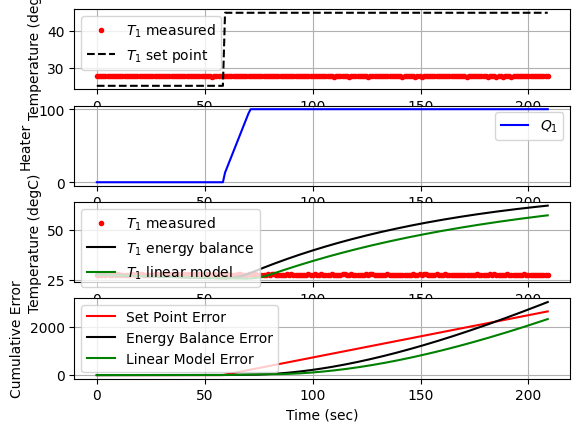

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 210.9  45.00  27.62 100.00   5.82  88.63  -0.00


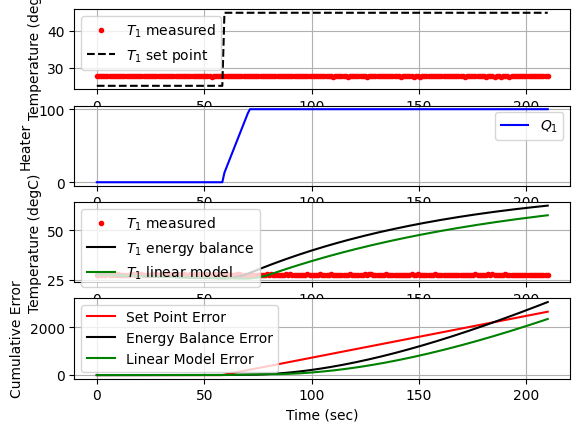

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 211.9  45.00  27.54 100.00   5.84  88.63   0.00


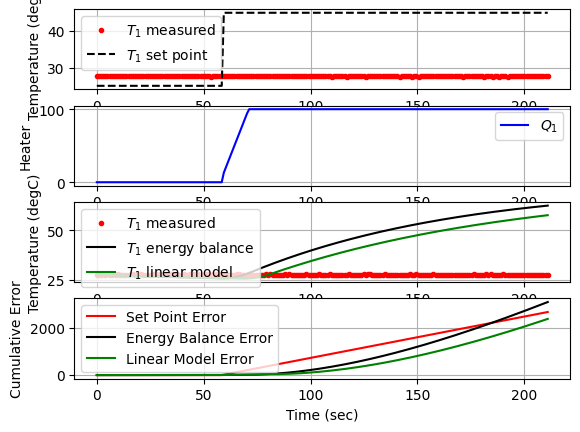

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 212.9  45.00  27.58 100.00   5.83  88.63  -0.00


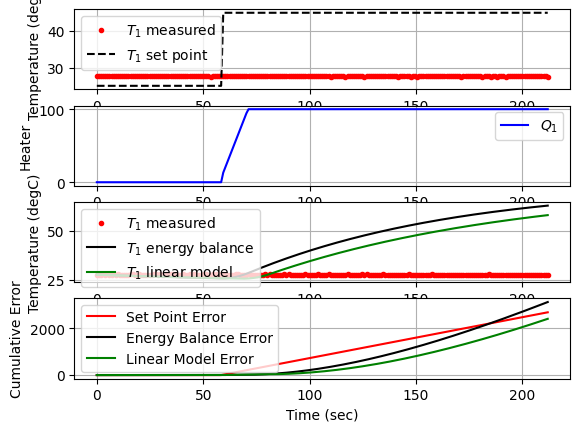

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 213.9  45.00  27.65 100.00   5.81  88.63  -0.00


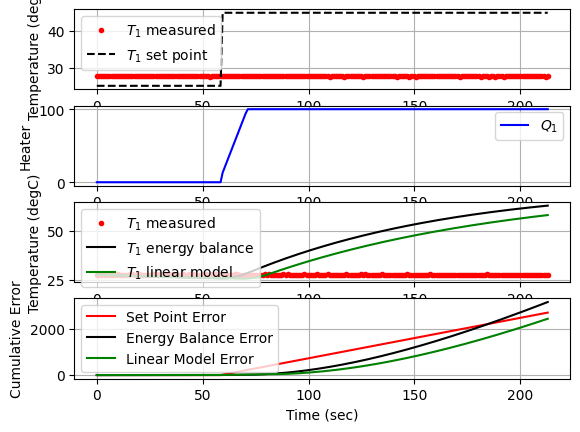

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 214.9  45.00  27.58 100.00   5.83  88.63   0.00


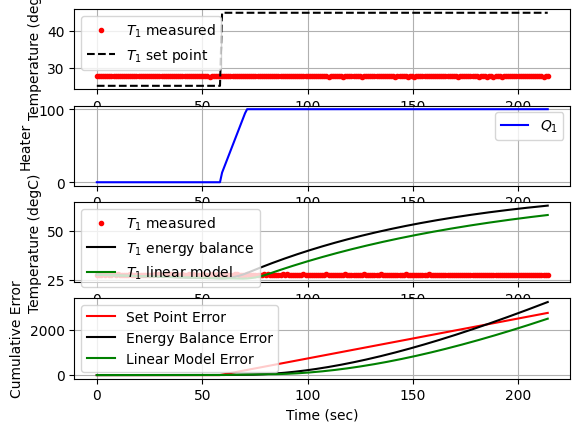

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 215.9  45.00  27.67 100.00   5.80  88.63  -0.00


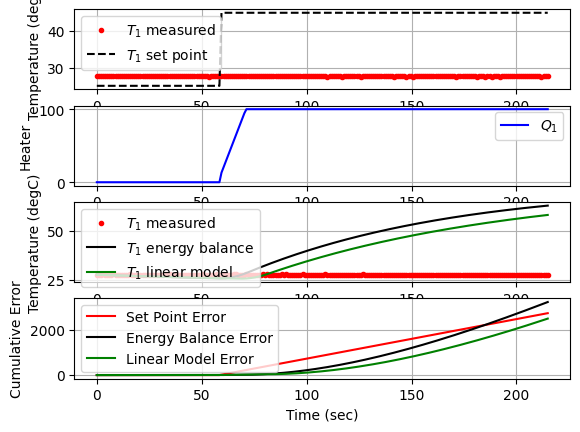

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 216.9  45.00  27.57 100.00   5.83  88.63   0.00


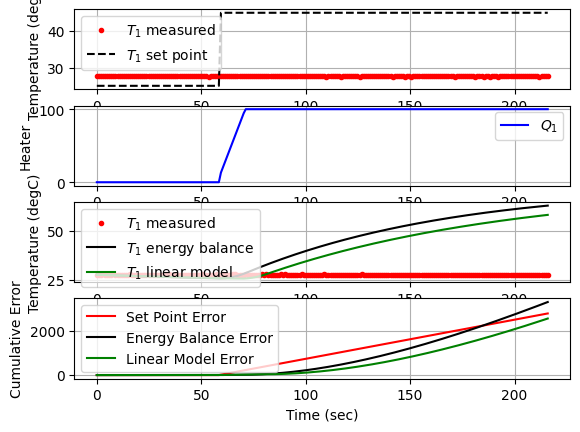

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 217.9  45.00  27.56 100.00   5.84  88.63   0.00


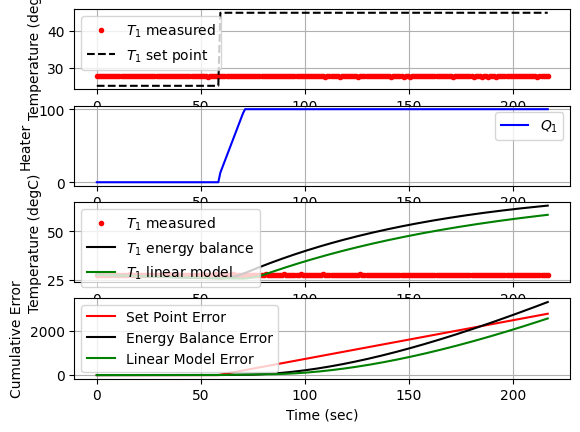

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 218.9  45.00  27.64 100.00   5.81  88.63  -0.00


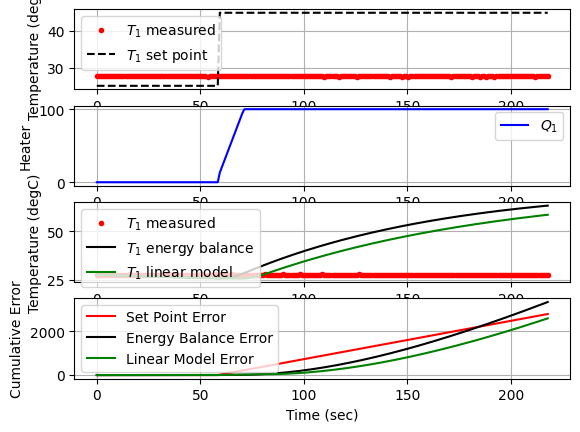

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 219.8  45.00  27.78 100.00   5.76  88.63  -0.01


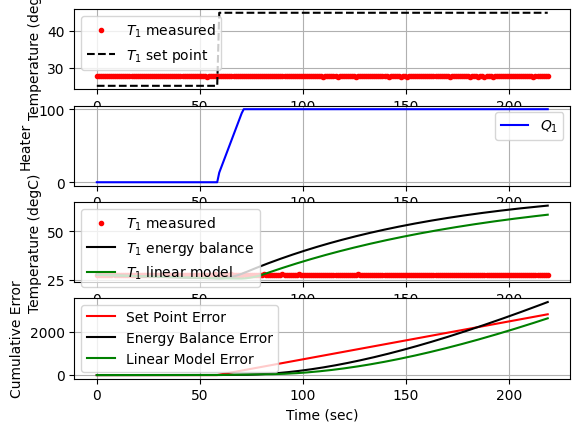

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 220.8  45.00  27.70 100.00   5.79  88.63   0.00


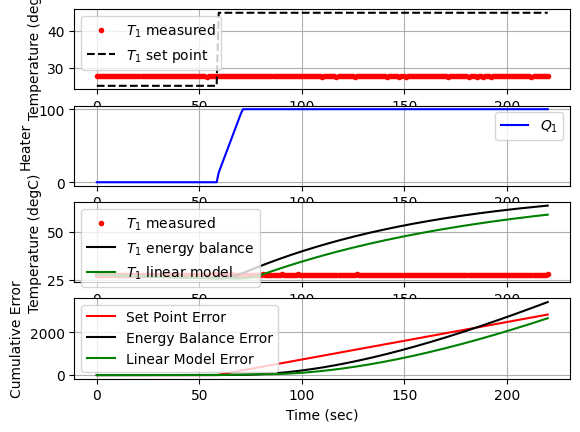

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 221.8  45.00  27.86 100.00   5.74  88.63  -0.01


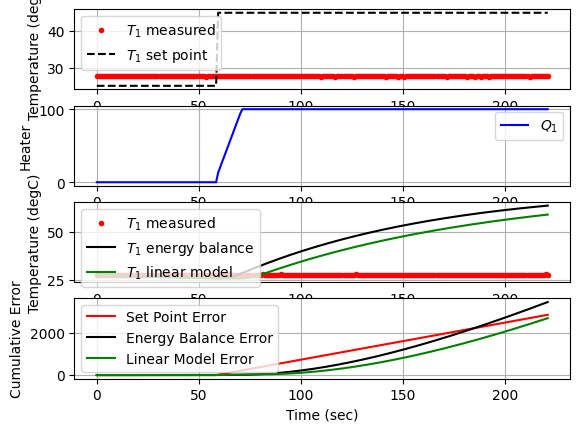

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 222.8  45.00  27.62 100.00   5.82  88.63   0.01


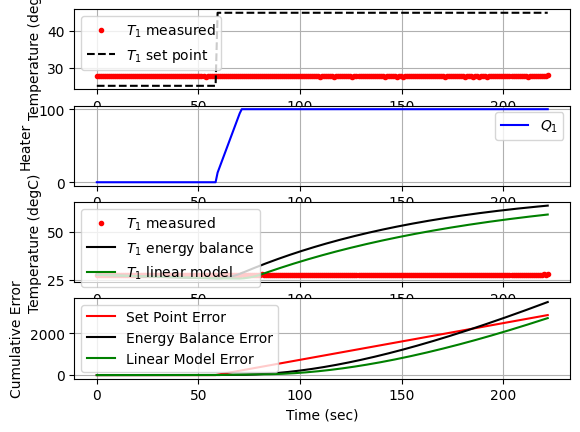

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 223.8  45.00  27.58 100.00   5.83  88.63   0.00


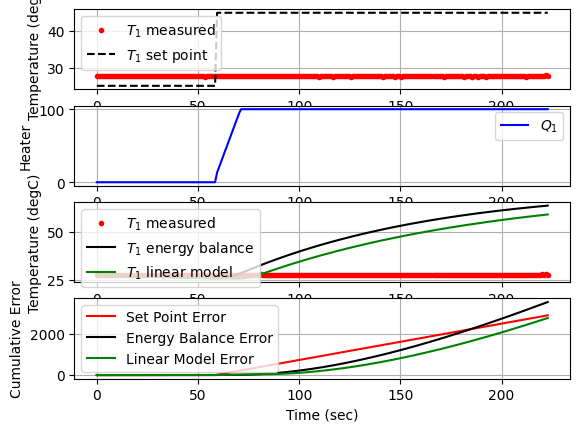

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 224.8  45.00  27.66 100.00   5.80  88.63  -0.00


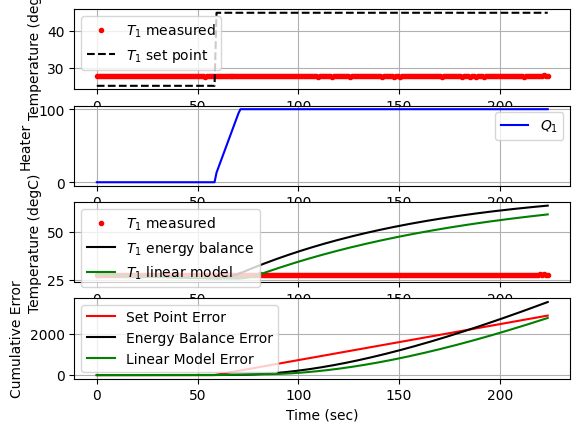

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 225.8  45.00  27.68 100.00   5.80  88.63  -0.00


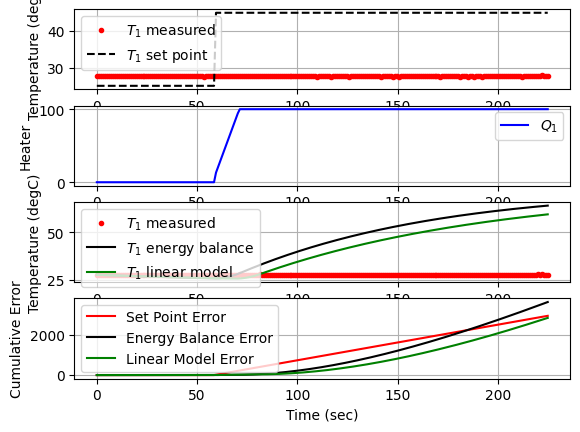

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 226.8  45.00  27.60 100.00   5.82  88.63   0.00


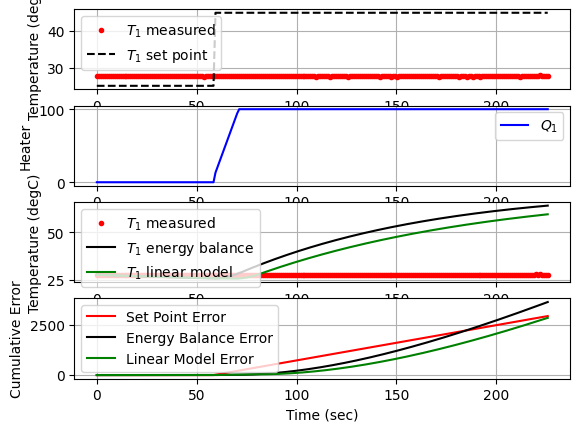

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 227.8  45.00  27.62 100.00   5.82  88.63  -0.00


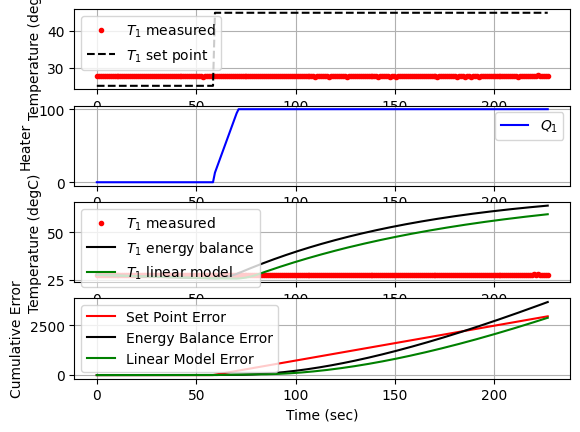

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 228.8  45.00  27.63 100.00   5.81  88.63  -0.00


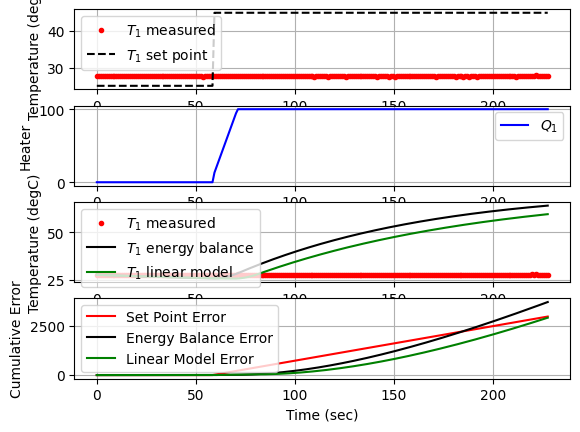

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 229.7  45.00  27.45 100.00   5.87  88.63   0.01


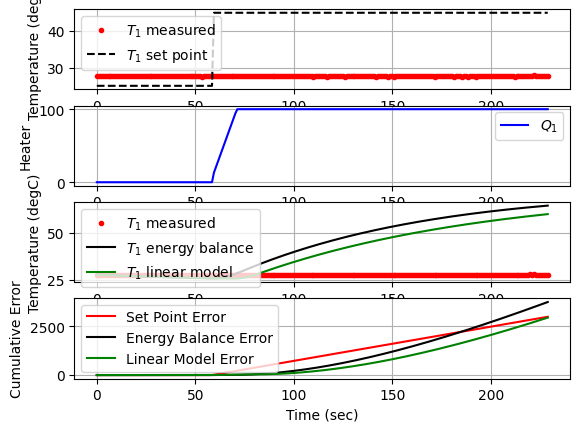

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 230.7  45.00  27.62 100.00   5.82  88.63  -0.01


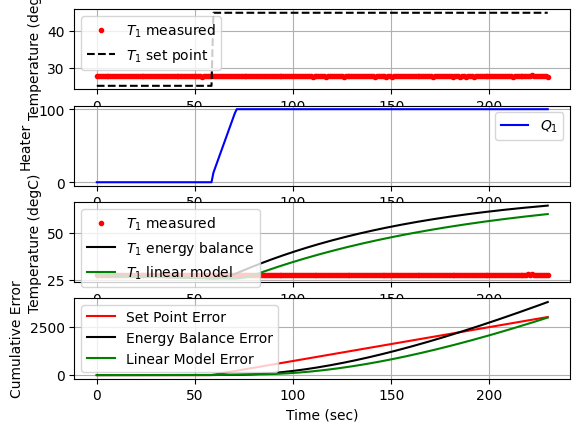

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 231.7  45.00  27.66 100.00   5.80  88.63  -0.00


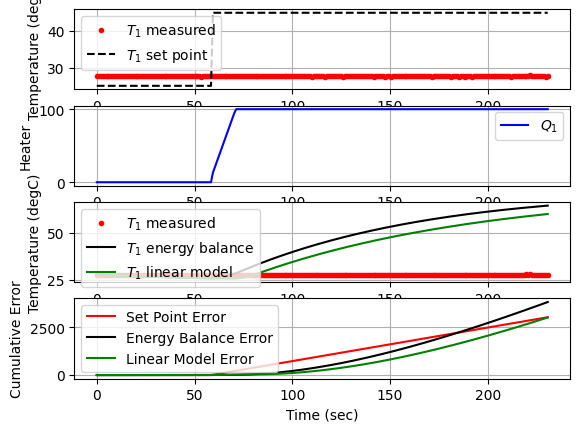

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 232.7  45.00  27.70 100.00   5.79  88.63  -0.00


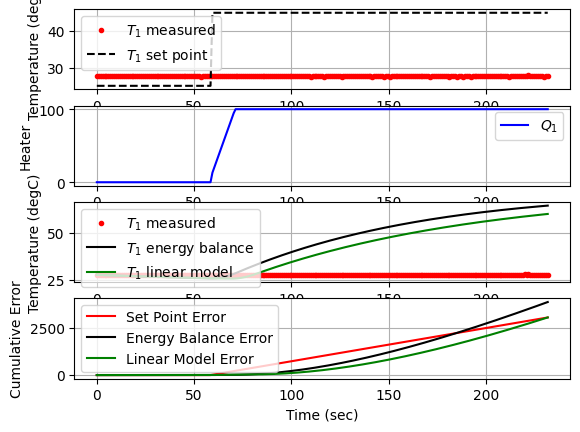

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 233.7  45.00  27.60 100.00   5.82  88.63   0.00


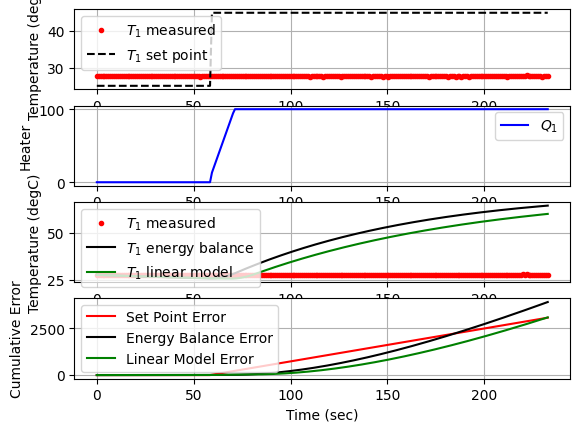

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 234.7  45.00  27.56 100.00   5.84  88.63   0.00


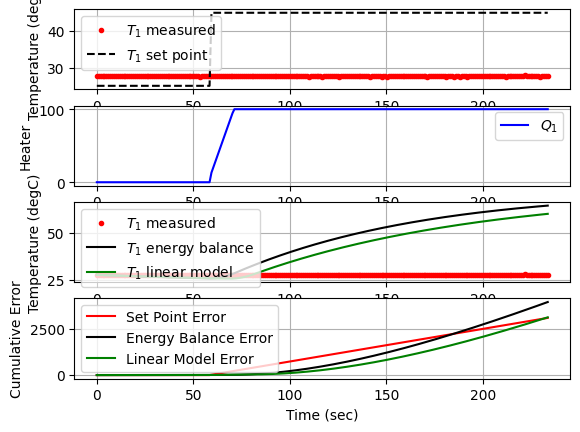

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 235.7  45.00  27.61 100.00   5.82  88.63  -0.00


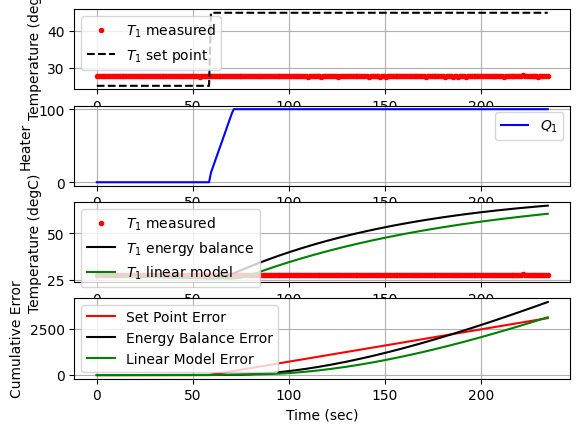

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 236.7  45.00  27.57 100.00   5.83  88.63   0.00


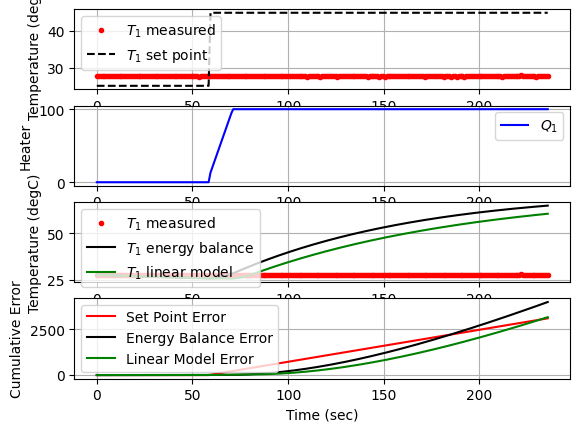

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 237.7  45.00  27.63 100.00   5.81  88.63  -0.00


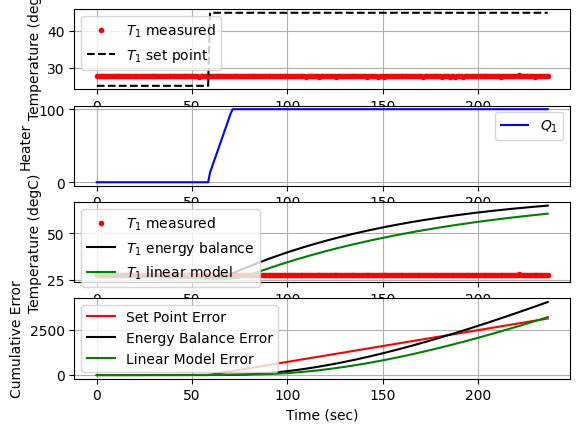

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 238.7  45.00  27.60 100.00   5.82  88.63   0.00


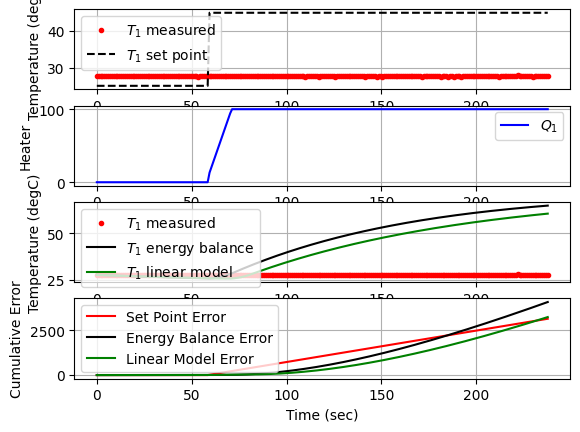

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 239.7  45.00  27.68 100.00   5.80  88.63  -0.00


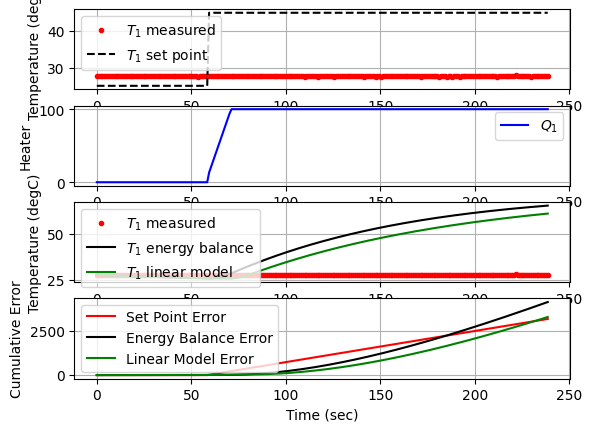

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 240.6  45.00  27.55 100.00   5.84  88.63   0.01


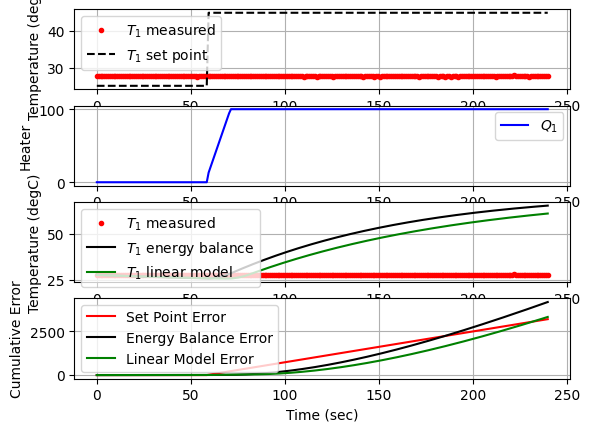

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 241.6  45.00  27.59 100.00   5.83  88.63  -0.00


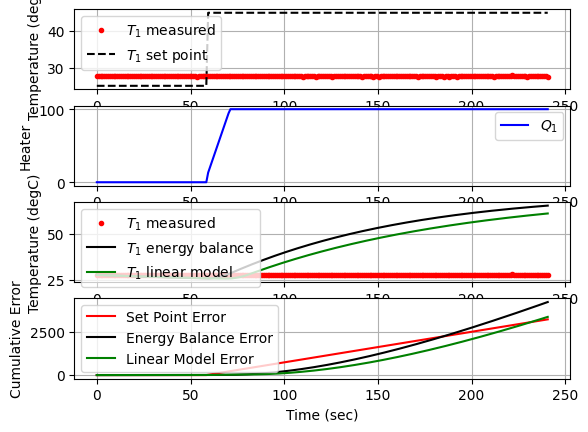

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 242.6  45.00  27.55 100.00   5.84  88.63   0.00


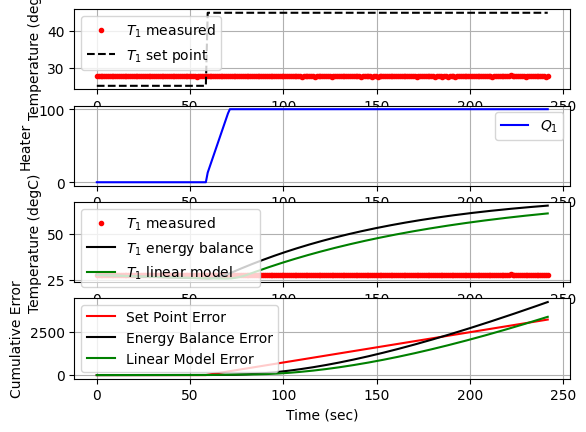

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 243.6  45.00  27.64 100.00   5.81  88.63  -0.00


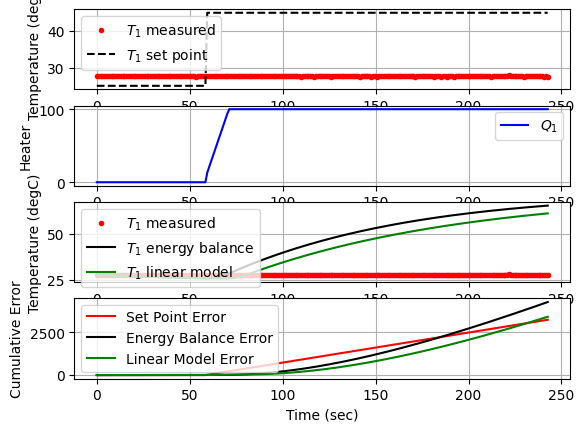

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 244.6  45.00  27.62 100.00   5.82  88.63   0.00


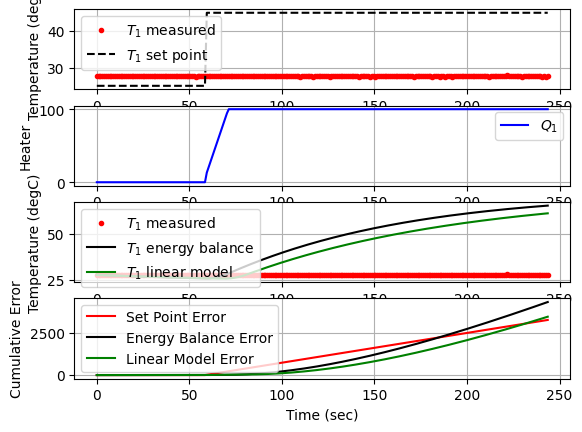

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 245.6  45.00  27.59 100.00   5.83  88.63   0.00


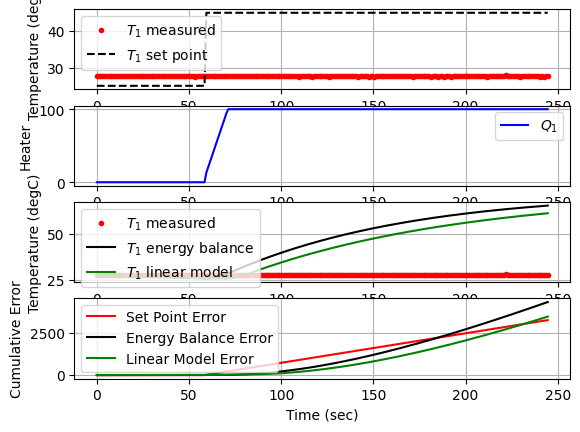

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 246.6  45.00  27.58 100.00   5.83  88.63   0.00


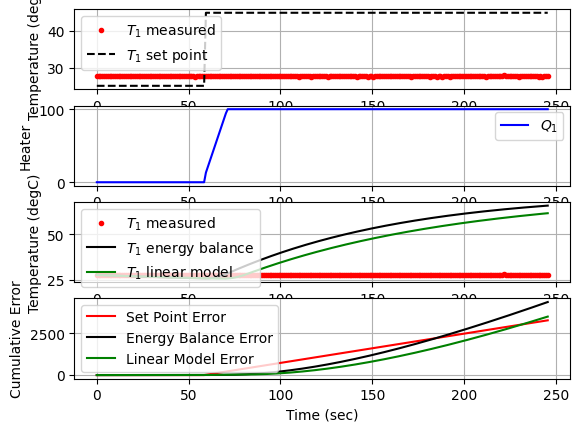

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 247.6  45.00  27.59 100.00   5.83  88.63  -0.00


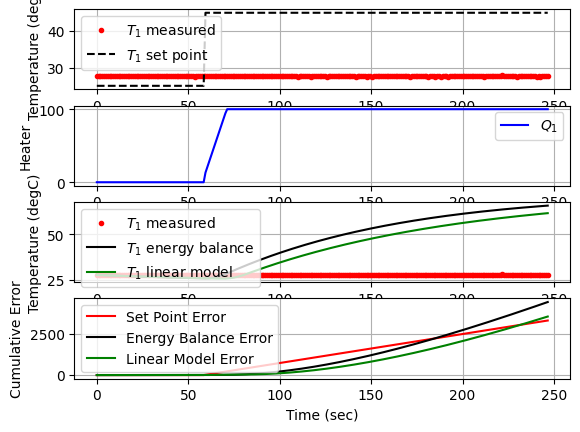

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 248.6  45.00  27.56 100.00   5.84  88.63   0.00


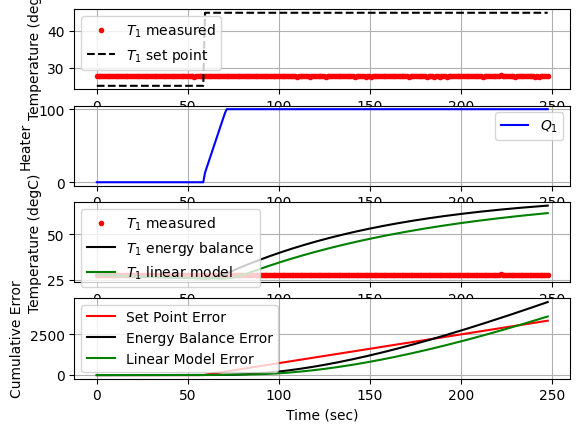

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 249.6  45.00  27.58 100.00   5.83  88.63  -0.00


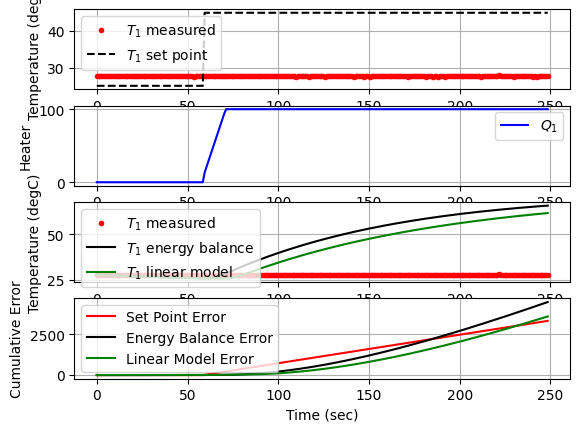

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 250.5  45.00  27.63 100.00   5.81  88.63  -0.00


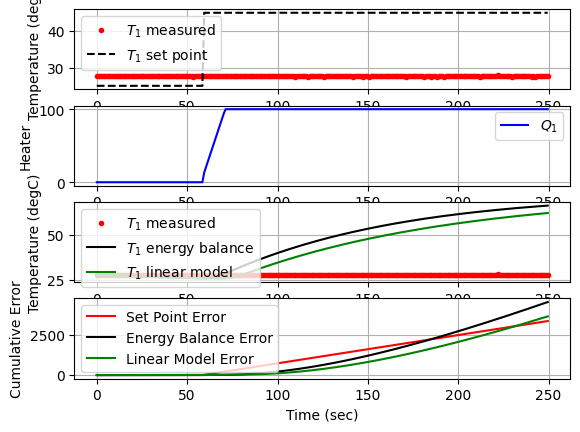

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 251.5  45.00  27.64 100.00   5.81  88.63  -0.00


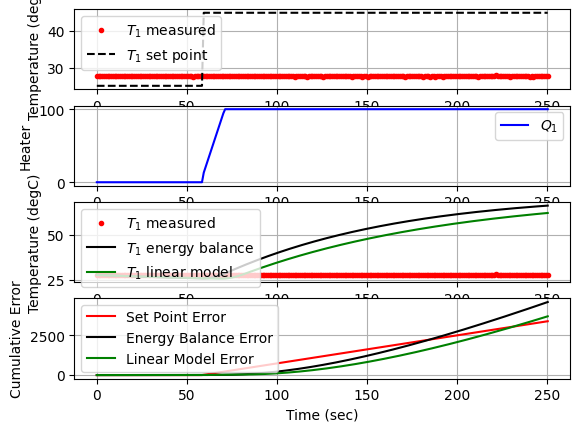

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 252.5  45.00  27.58 100.00   5.83  88.63   0.00


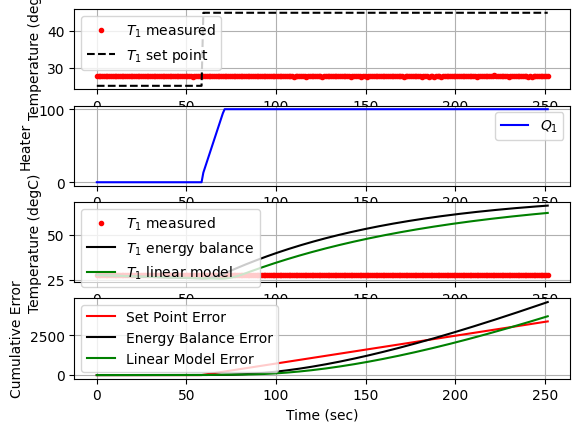

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 253.5  45.00  27.61 100.00   5.82  88.63  -0.00


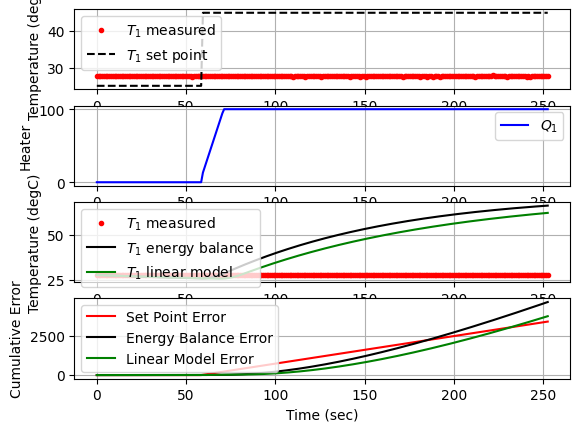

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 254.5  45.00  27.57 100.00   5.83  88.63   0.00


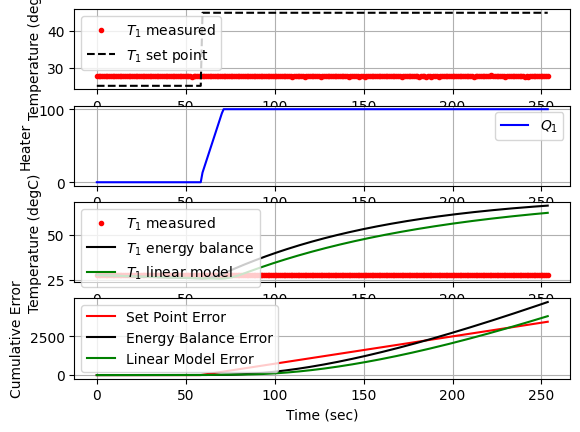

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 255.5  45.00  27.51 100.00   5.85  88.63   0.00


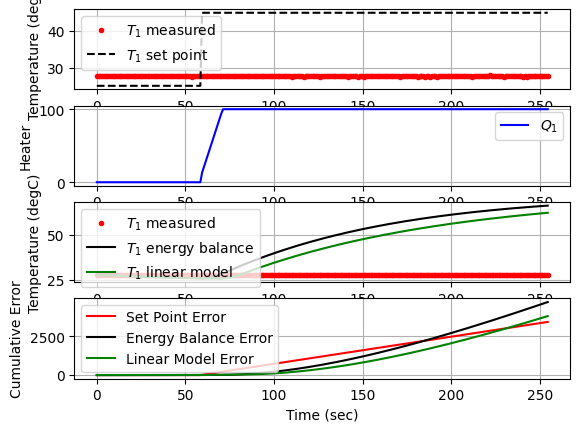

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 256.5  45.00  27.61 100.00   5.82  88.63  -0.00


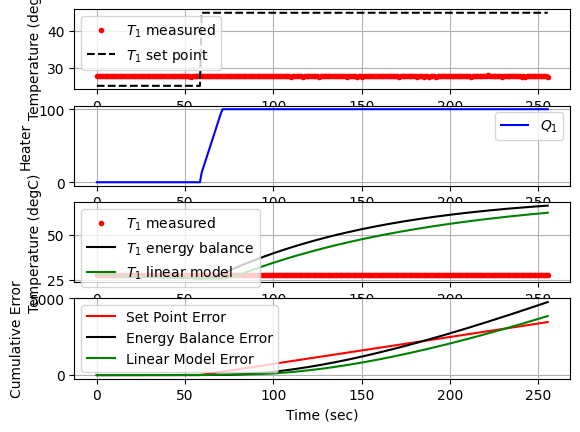

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 257.5  45.00  27.58 100.00   5.83  88.63   0.00


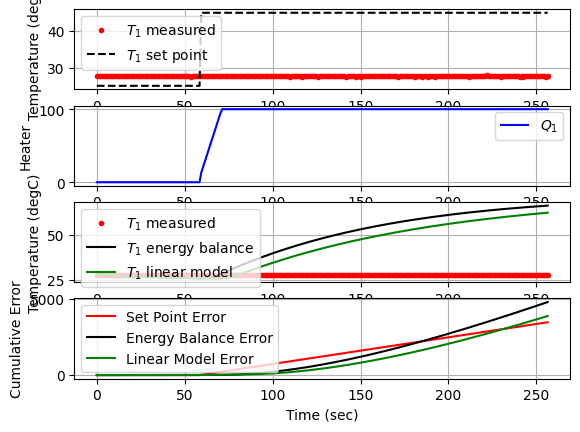

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 258.5  45.00  27.64 100.00   5.81  88.63  -0.00


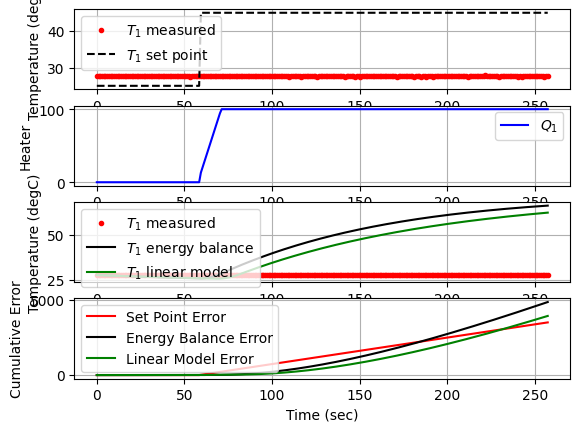

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 259.5  45.00  27.60 100.00   5.82  88.63   0.00


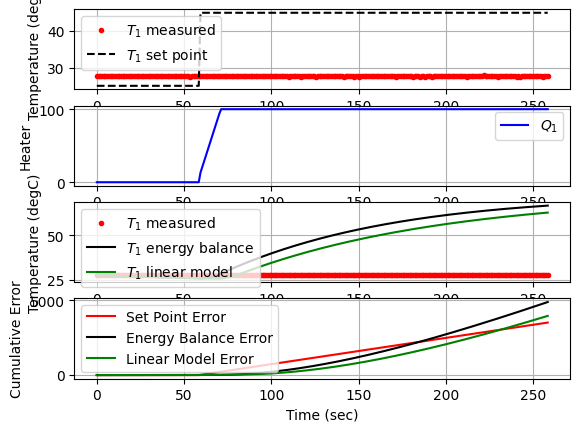

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 260.5  45.00  27.63 100.00   5.81  88.63  -0.00


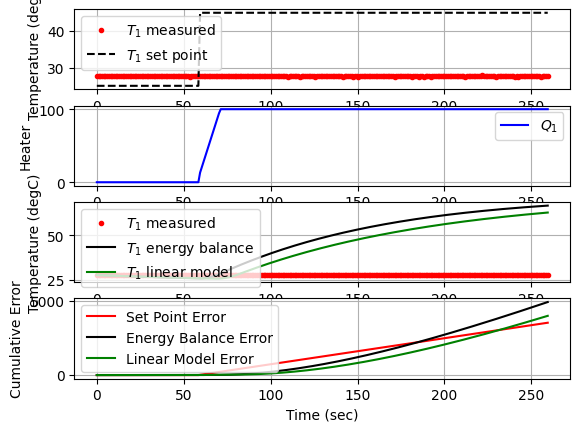

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 261.4  45.00  27.56 100.00   5.84  88.63   0.00


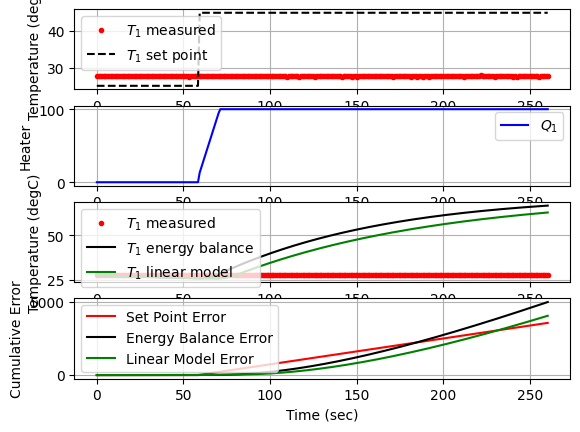

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 262.4  45.00  27.63 100.00   5.81  88.63  -0.00


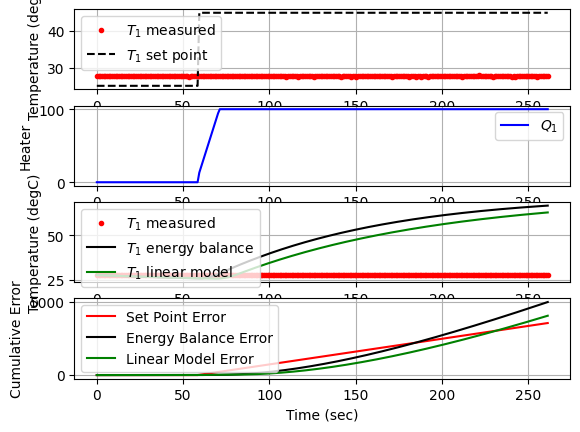

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 263.4  45.00  27.64 100.00   5.81  88.63  -0.00


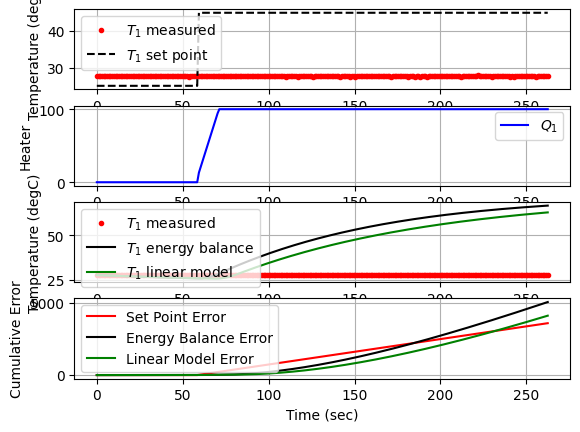

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 264.4  45.00  27.59 100.00   5.83  88.63   0.00


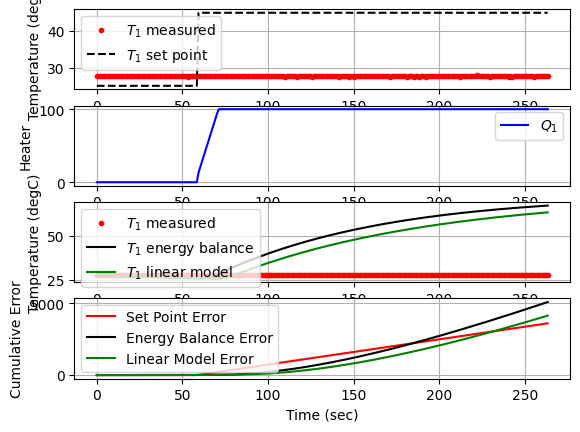

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 265.4  45.00  27.54 100.00   5.84  88.63   0.00


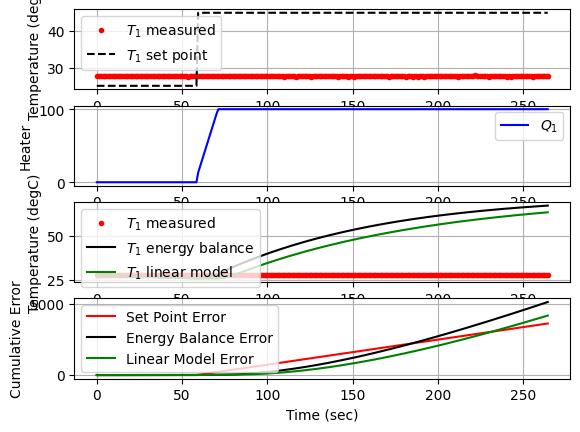

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 266.4  45.00  27.60 100.00   5.82  88.63  -0.00


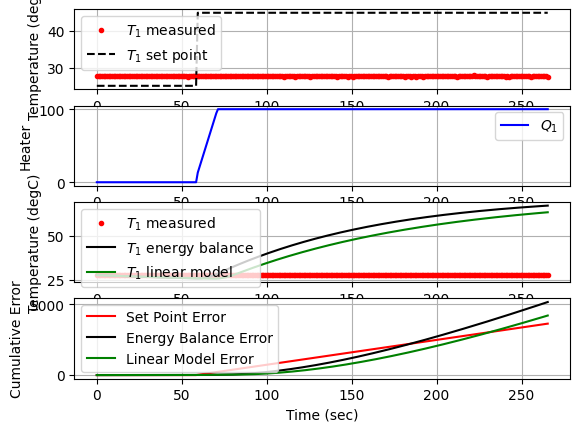

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 267.4  45.00  27.48 100.00   5.86  88.63   0.01


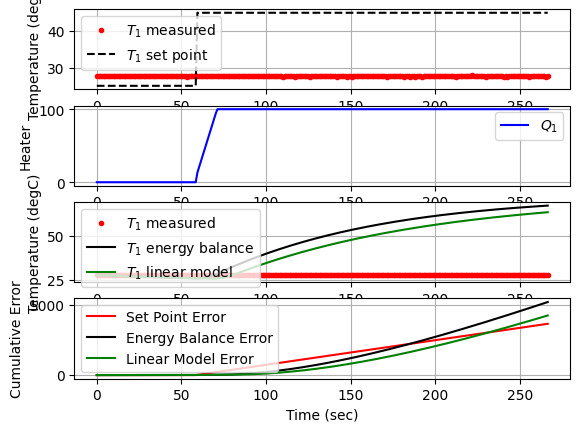

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 268.4  45.00  27.61 100.00   5.82  88.63  -0.01


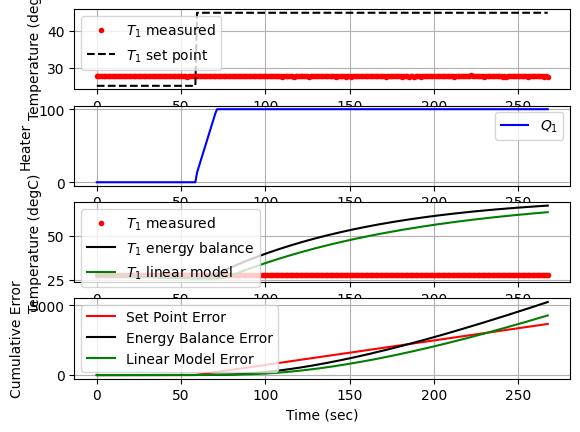

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 269.4  45.00  27.53 100.00   5.85  88.63   0.00


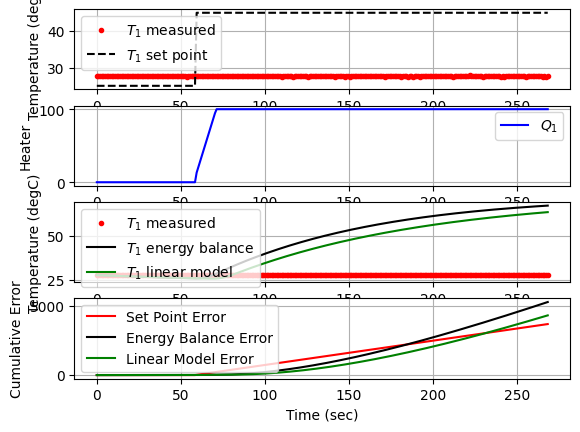

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 270.4  45.00  27.63 100.00   5.81  88.63  -0.00


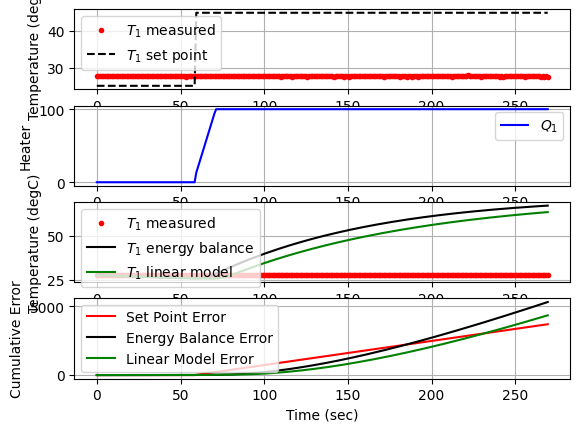

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 271.3  45.00  27.63 100.00   5.81  88.63  -0.00


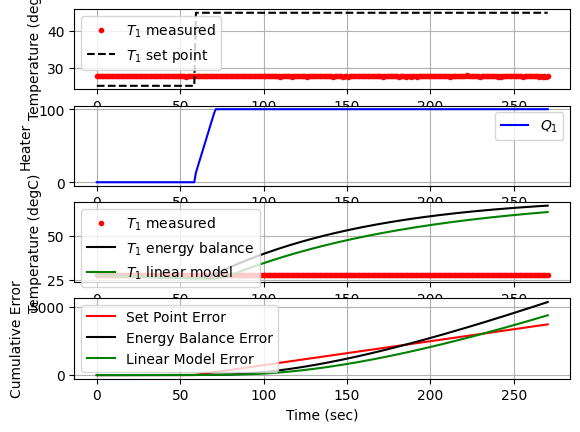

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 272.3  45.00  27.59 100.00   5.83  88.63   0.00


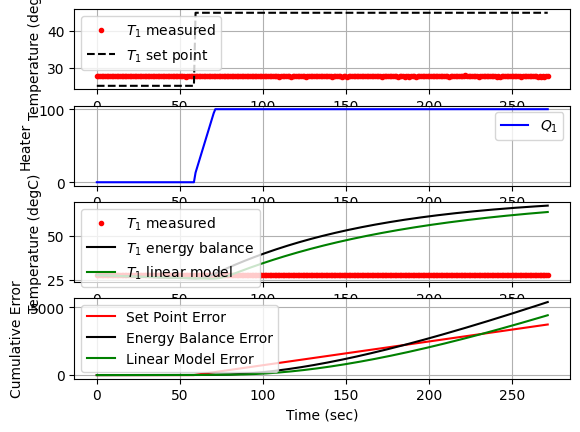

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 273.3  45.00  27.62 100.00   5.82  88.63  -0.00


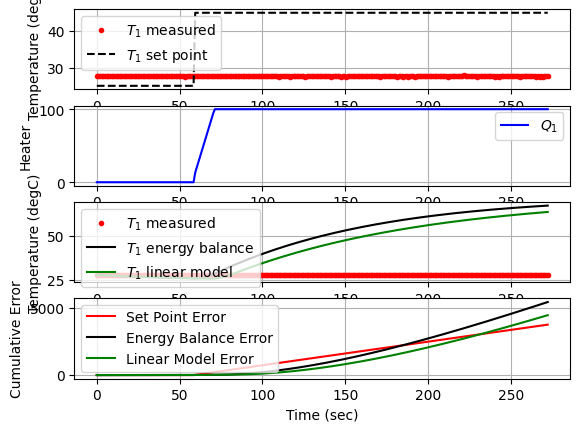

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 274.3  45.00  27.61 100.00   5.82  88.63   0.00


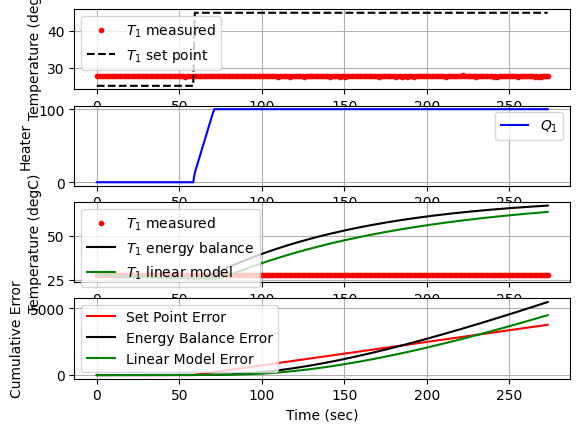

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 275.3  45.00  27.63 100.00   5.81  88.63  -0.00


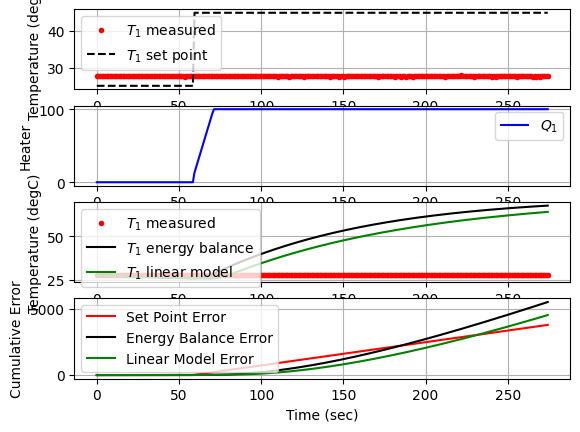

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 276.3  45.00  27.56 100.00   5.84  88.63   0.00


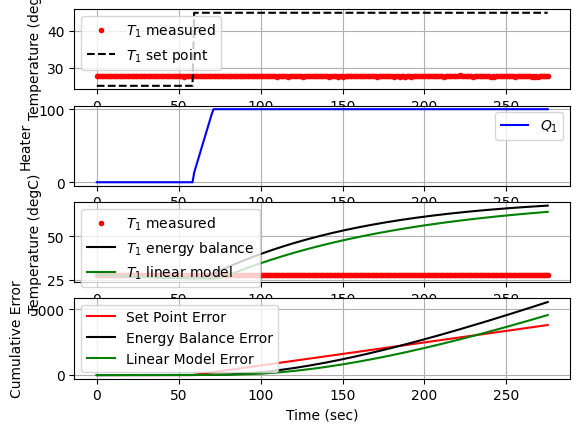

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 277.3  45.00  27.61 100.00   5.82  88.63  -0.00


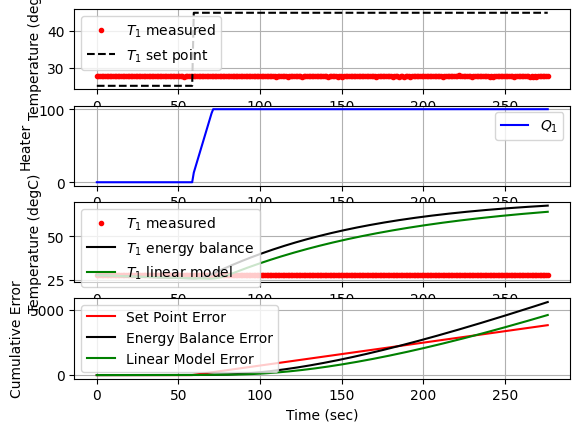

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 278.3  45.00  27.65 100.00   5.81  88.63  -0.00


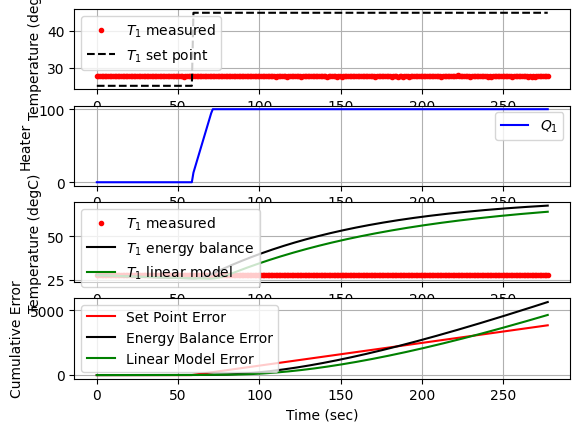

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 279.3  45.00  27.59 100.00   5.83  88.63   0.00


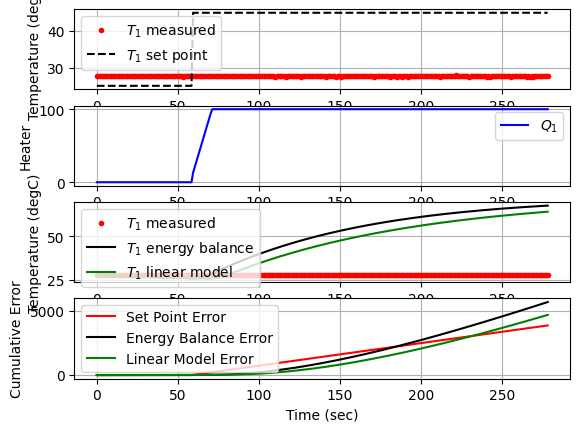

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 280.3  45.00  27.60 100.00   5.82  88.63  -0.00


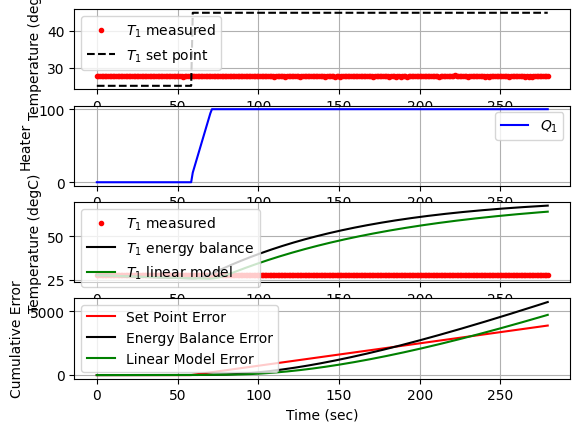

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 281.2  45.00  27.58 100.00   5.83  88.63   0.00


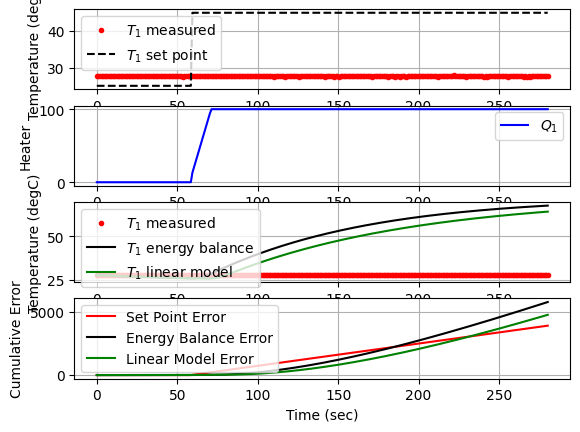

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 282.2  45.00  27.58 100.00   5.83  88.63  -0.00


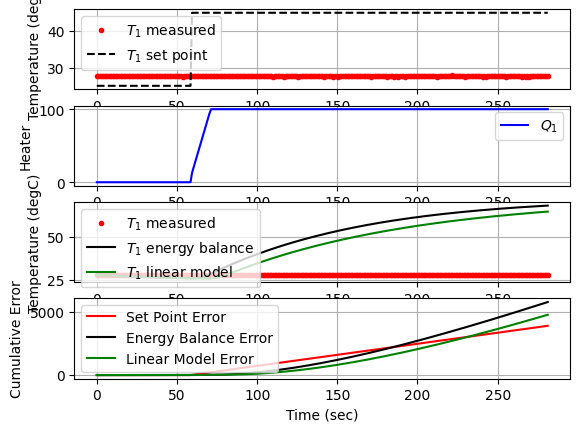

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 283.2  45.00  27.65 100.00   5.81  88.63  -0.00


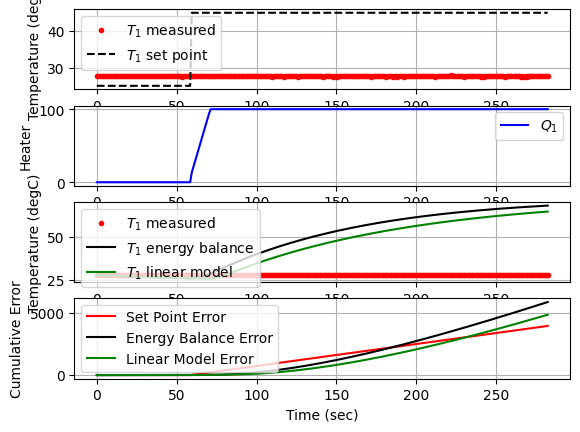

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 284.2  45.00  27.63 100.00   5.81  88.63   0.00


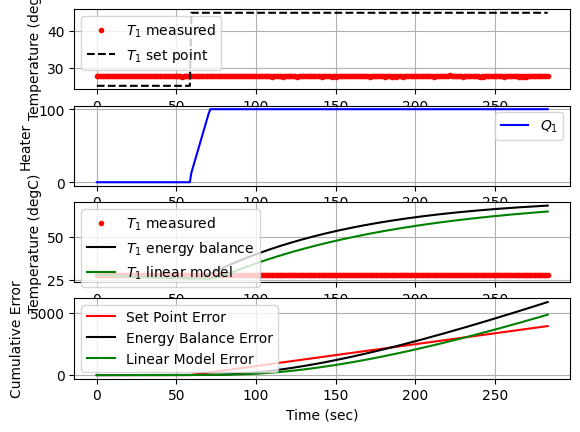

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 285.2  45.00  27.54 100.00   5.84  88.63   0.00


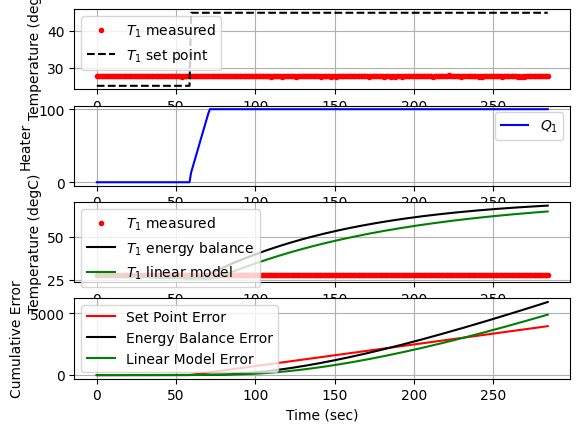

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 286.2  45.00  27.58 100.00   5.83  88.63  -0.00


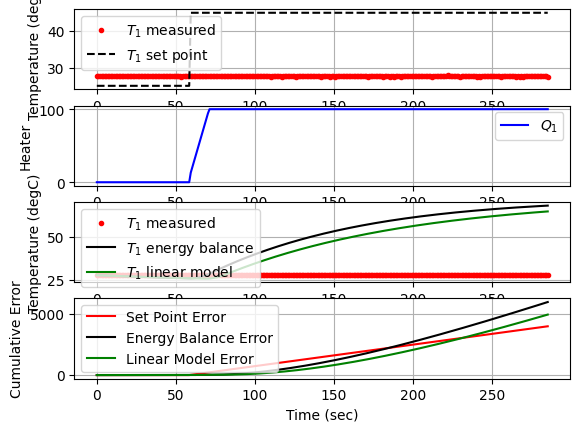

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 287.2  45.00  27.56 100.00   5.84  88.63   0.00


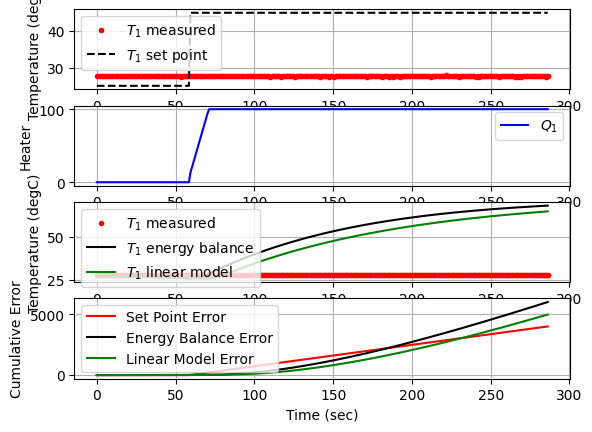

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 288.2  45.00  27.53 100.00   5.85  88.63   0.00


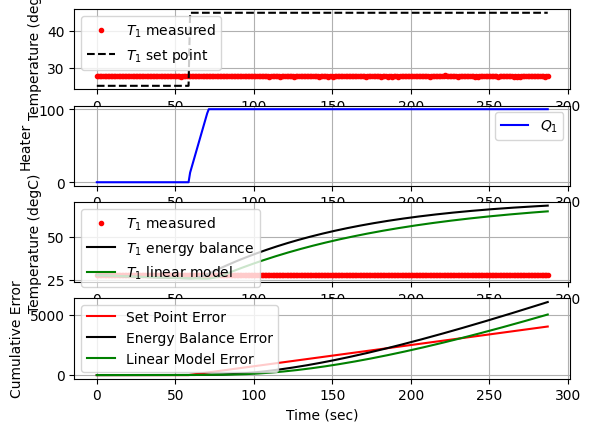

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 289.2  45.00  27.58 100.00   5.83  88.63  -0.00


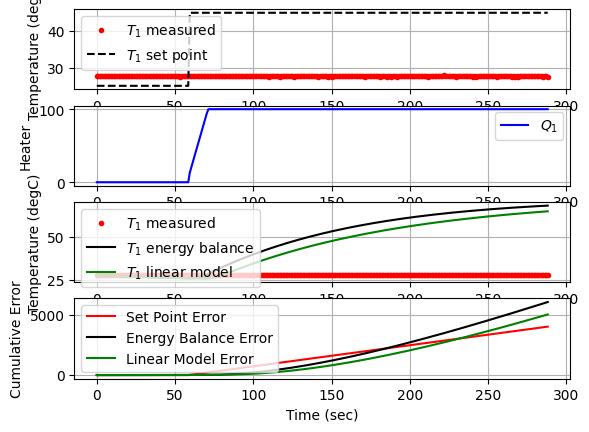

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 290.2  45.00  27.61 100.00   5.82  88.63  -0.00


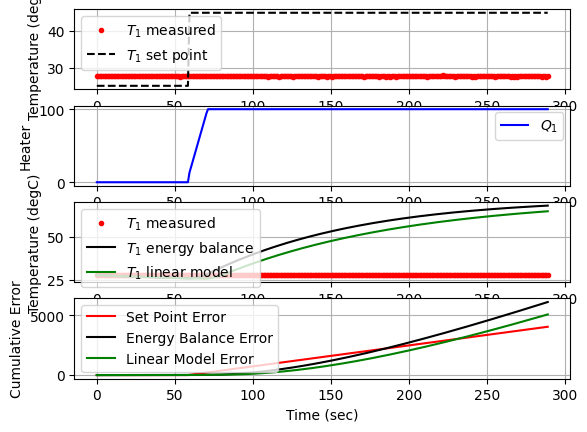

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 291.2  45.00  27.61 100.00   5.82  88.63  -0.00


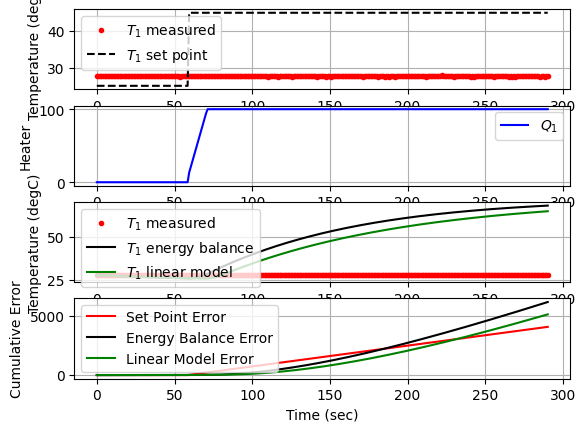

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 292.1  45.00  27.59 100.00   5.83  88.63   0.00


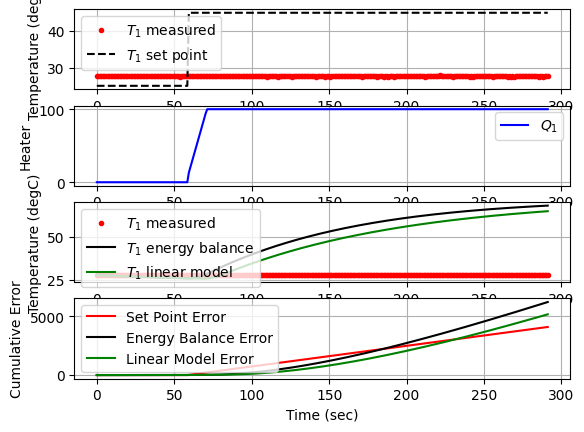

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 293.1  45.00  27.66 100.00   5.80  88.63  -0.00


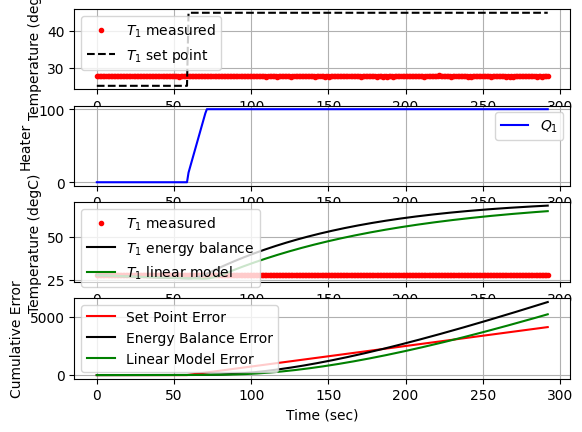

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 294.1  45.00  27.68 100.00   5.80  88.63  -0.00


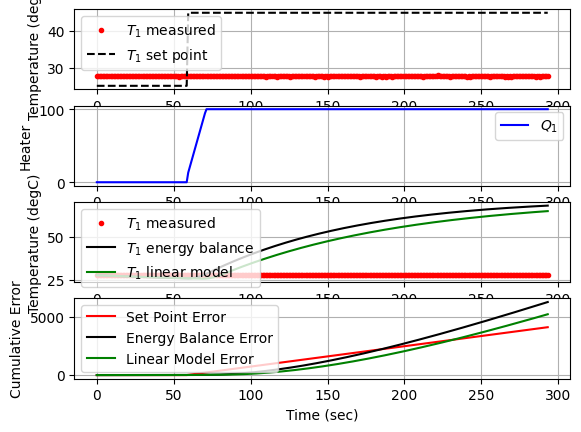

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 295.1  45.00  27.65 100.00   5.81  88.63   0.00


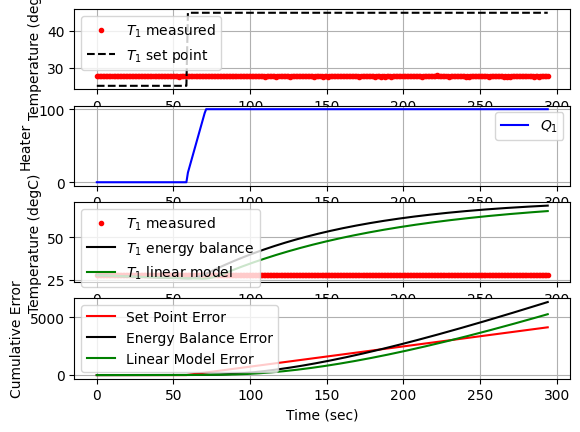

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 296.1  45.00  27.65 100.00   5.81  88.63  -0.00


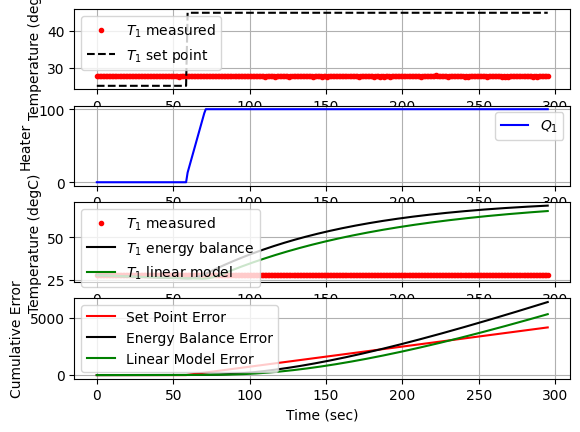

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 297.1  45.00  27.56 100.00   5.84  88.63   0.00


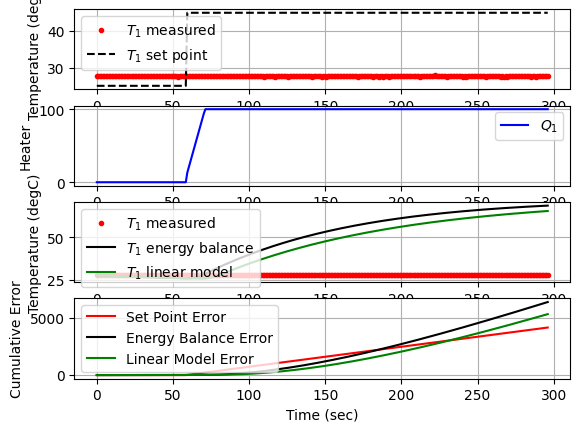

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 298.1  45.00  27.65 100.00   5.81  88.63  -0.00


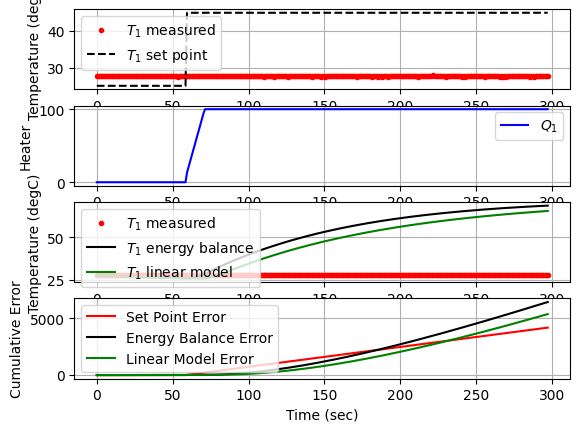

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 299.1  45.00  27.59 100.00   5.83  88.63   0.00


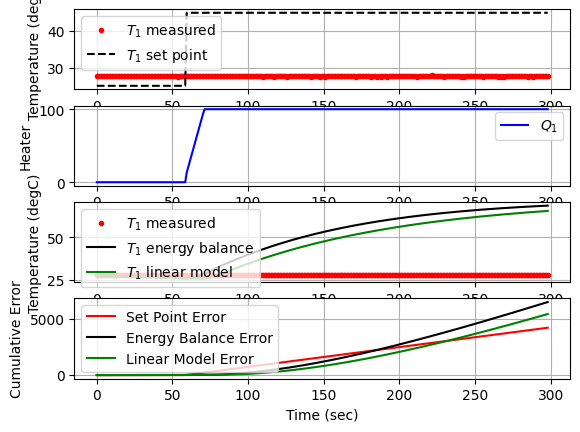

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 300.1  45.00  27.61 100.00   5.82  88.63  -0.00


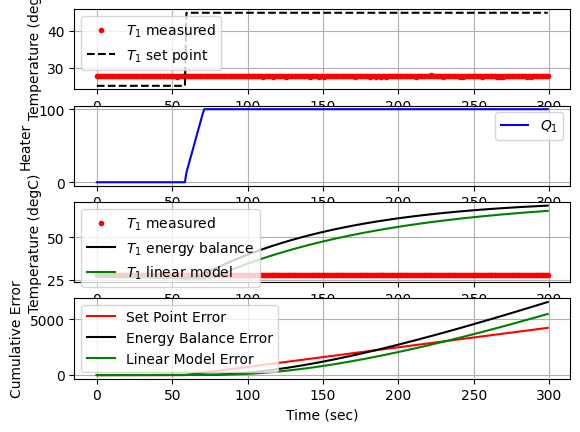

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 301.1  45.00  27.61 100.00   5.82  88.63  -0.00


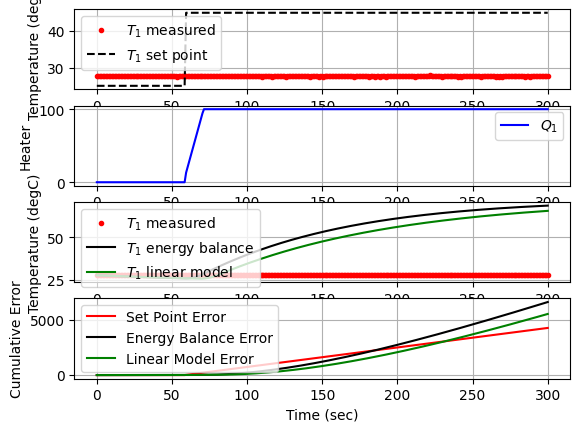

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 302.0  45.00  27.60 100.00   5.82  88.63   0.00


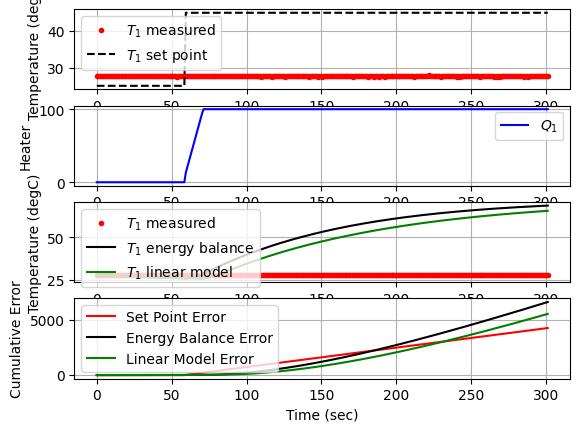

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 303.0  45.00  27.61 100.00   5.82  88.63  -0.00


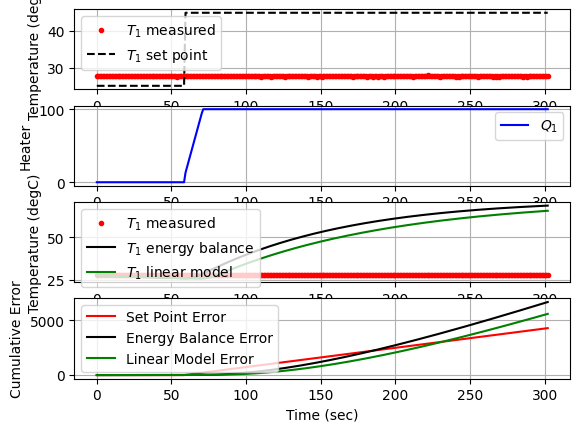

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 304.0  45.00  27.69 100.00   5.79  88.63  -0.00


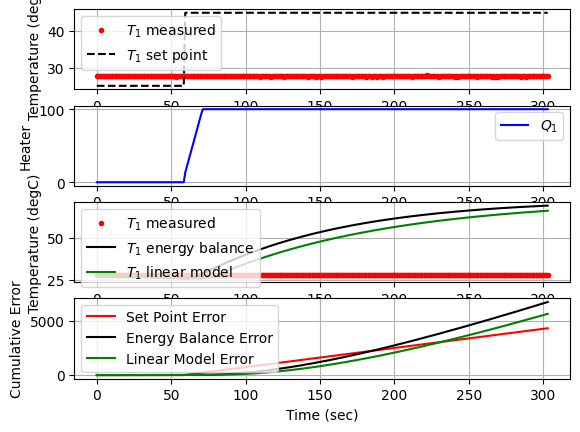

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 305.0  45.00  27.66 100.00   5.80  88.63   0.00


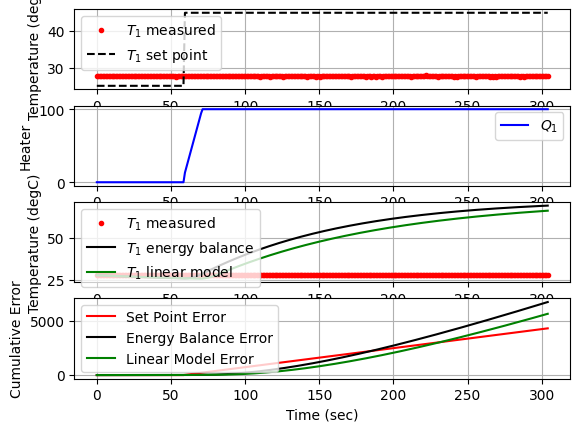

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 306.0  45.00  27.61 100.00   5.82  88.63   0.00


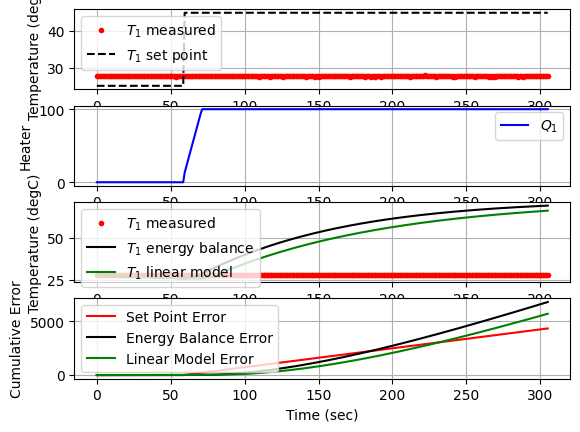

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 307.0  45.00  27.66 100.00   5.80  88.63  -0.00


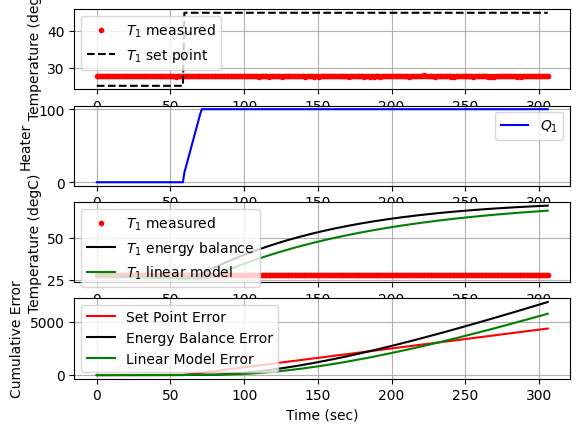

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 308.0  45.00  27.65 100.00   5.81  88.63   0.00


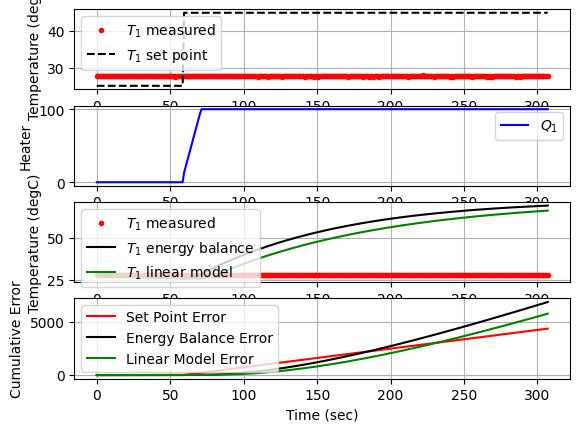

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 309.0  45.00  27.71 100.00   5.79  88.63  -0.00


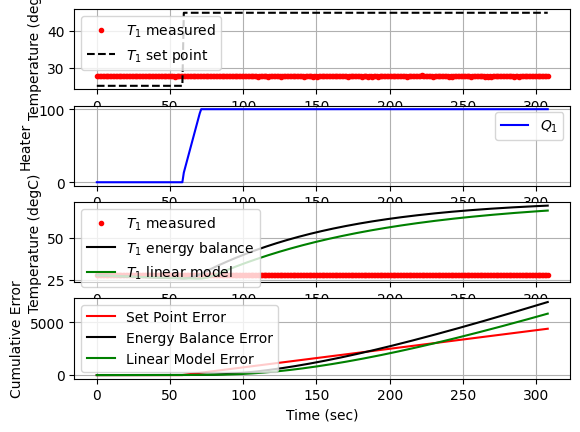

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 310.0  45.00  27.67 100.00   5.80  88.63   0.00


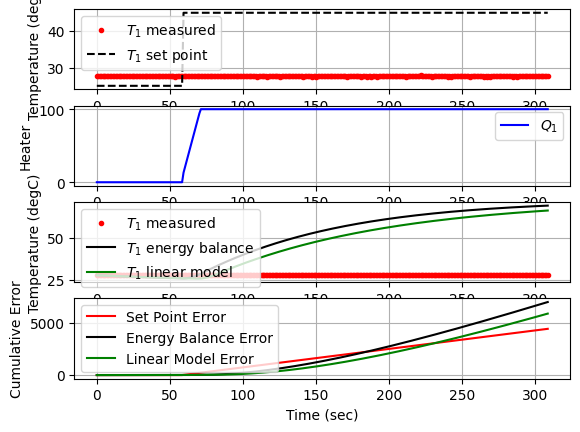

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 311.0  45.00  27.54 100.00   5.84  88.63   0.01


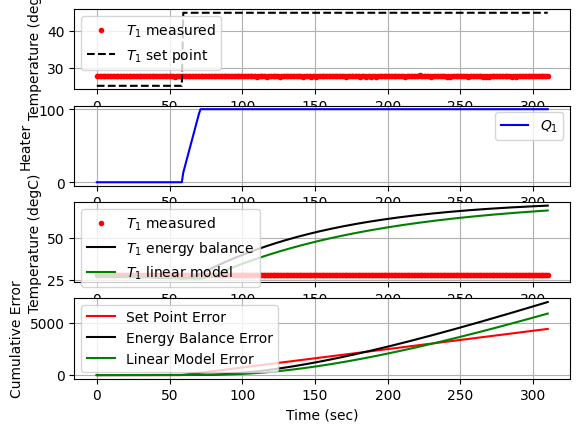

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 311.9  45.00  27.62 100.00   5.82  88.63  -0.00


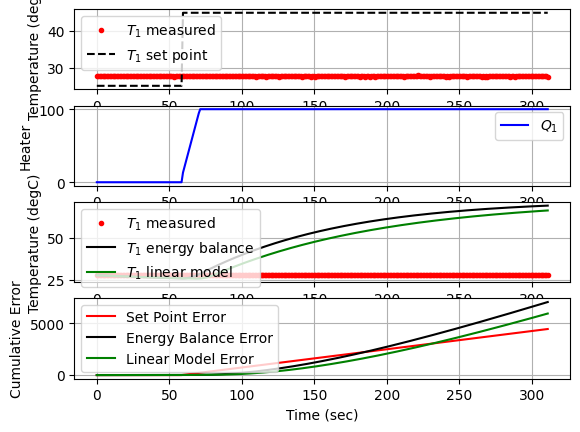

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 312.9  45.00  27.56 100.00   5.84  88.63   0.00


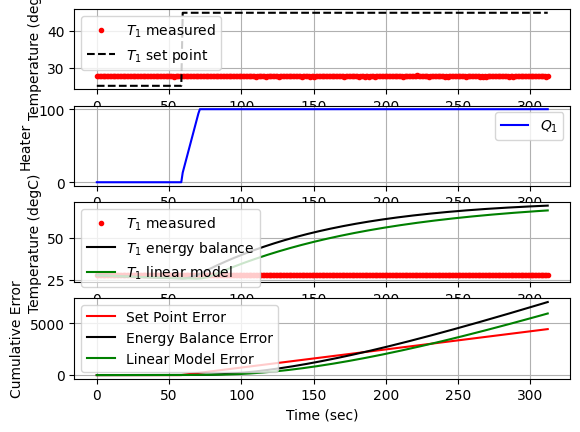

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 313.9  45.00  27.66 100.00   5.80  88.63  -0.00


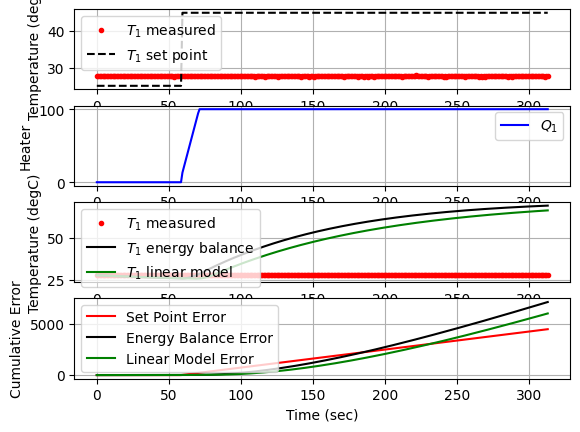

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 314.9  45.00  27.65 100.00   5.81  88.63   0.00


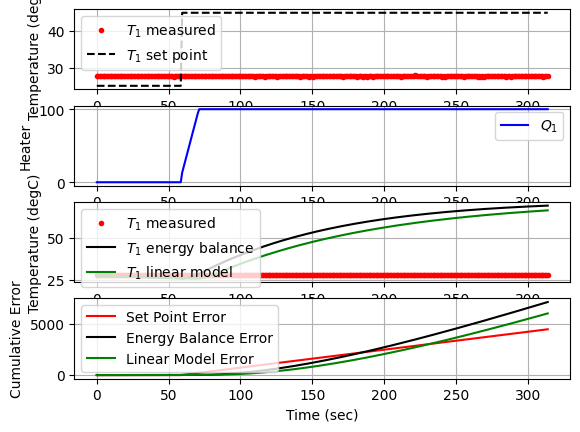

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 315.9  45.00  27.55 100.00   5.84  88.63   0.00


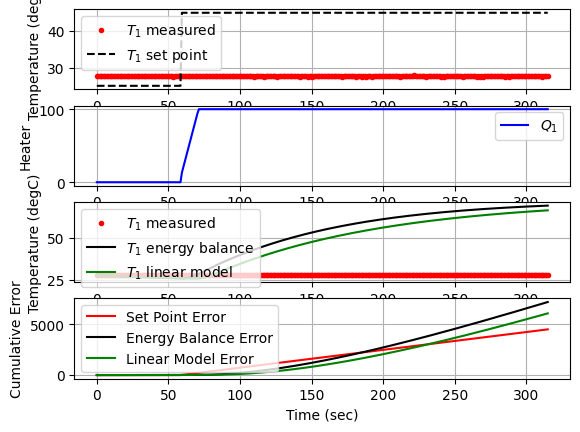

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 316.9  45.00  27.63 100.00   5.81  88.63  -0.00


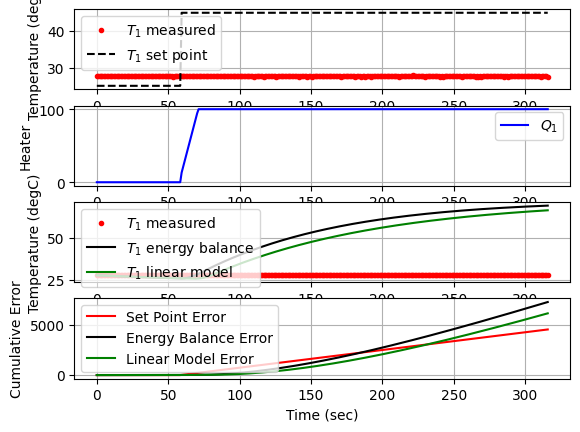

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 317.9  45.00  27.65 100.00   5.81  88.63  -0.00


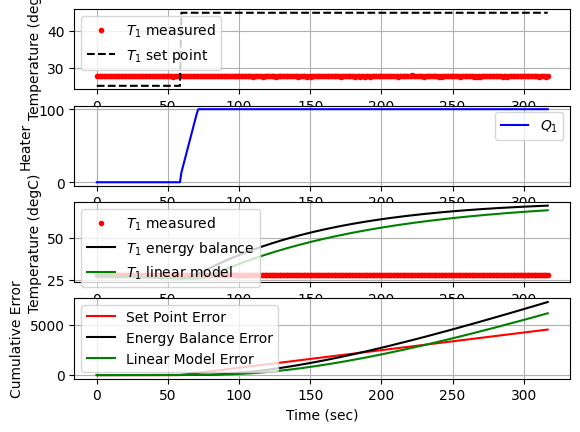

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 318.9  45.00  27.54 100.00   5.84  88.63   0.01


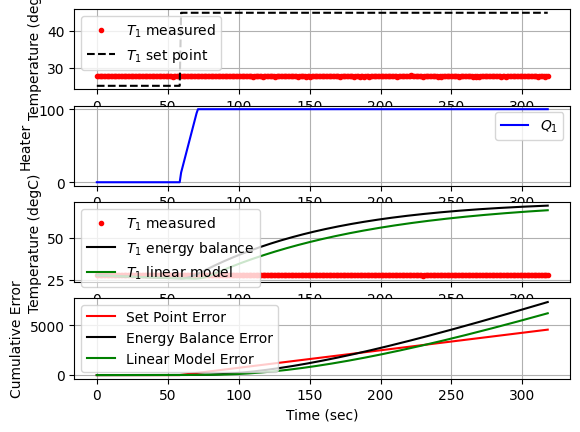

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 319.9  45.00  27.60 100.00   5.82  88.63  -0.00


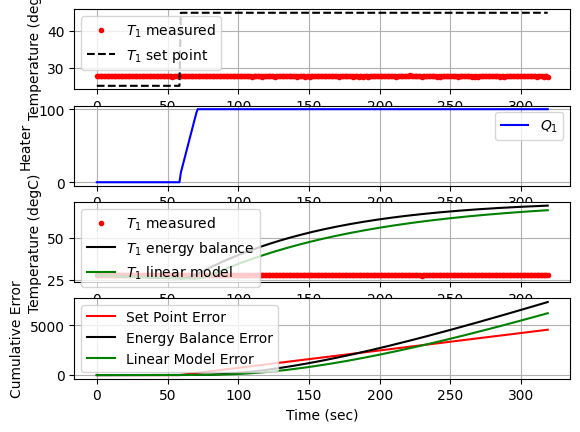

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 320.9  45.00  27.65 100.00   5.81  88.63  -0.00


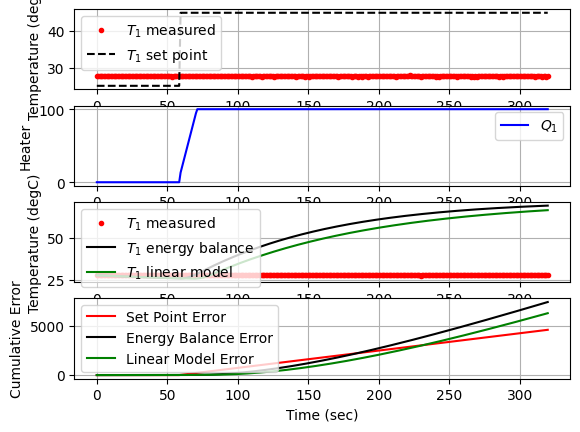

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 321.9  45.00  27.58 100.00   5.83  88.63   0.00


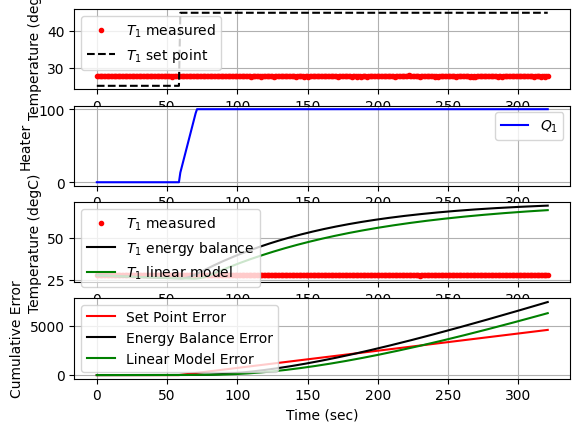

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 322.8  45.00  27.88 100.00   5.73  88.63  -0.01


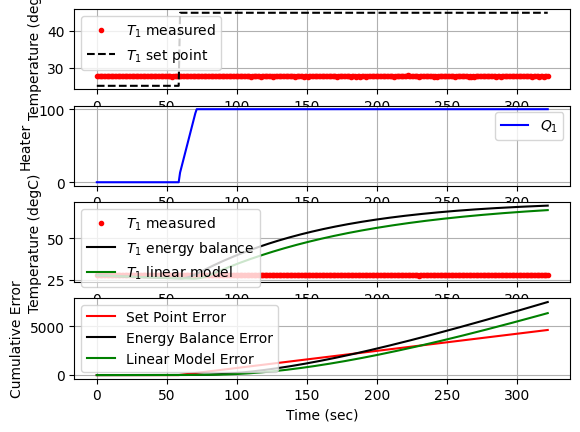

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 323.8  45.00  27.70 100.00   5.79  88.63   0.01


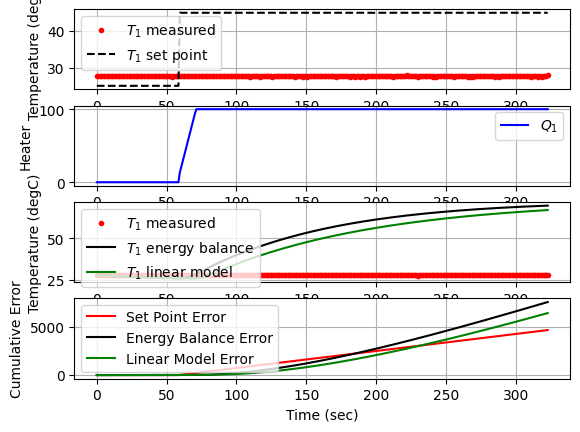

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 324.8  45.00  27.62 100.00   5.82  88.63   0.00


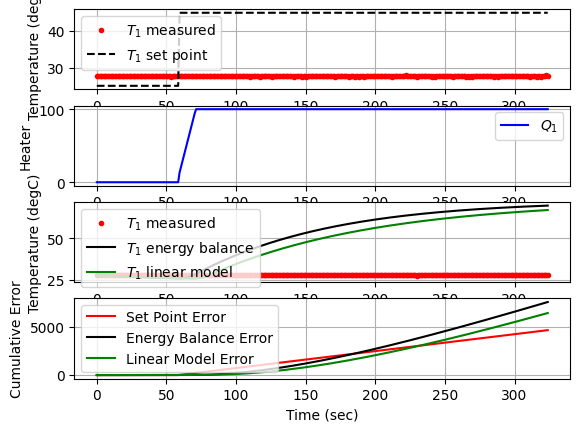

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 325.8  45.00  27.66 100.00   5.80  88.63  -0.00


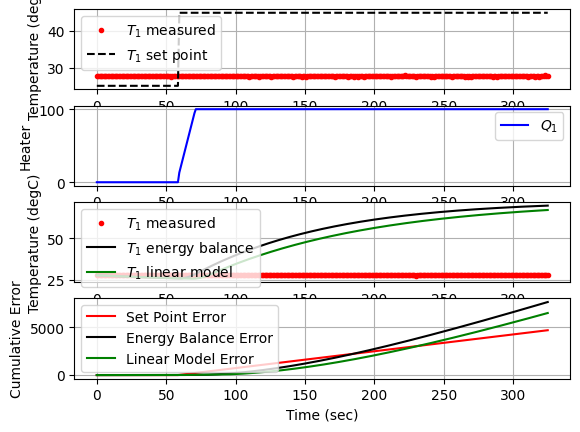

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 326.8  45.00  27.54 100.00   5.84  88.63   0.01


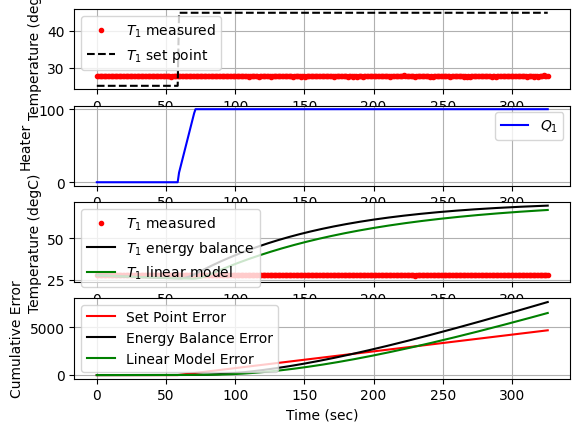

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 327.8  45.00  27.60 100.00   5.82  88.63  -0.00


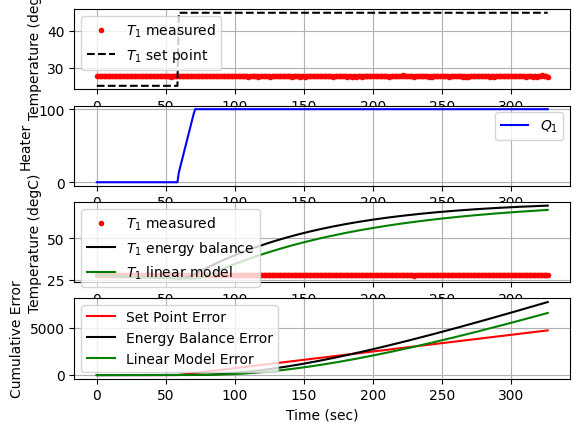

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 328.8  45.00  27.64 100.00   5.81  88.63  -0.00


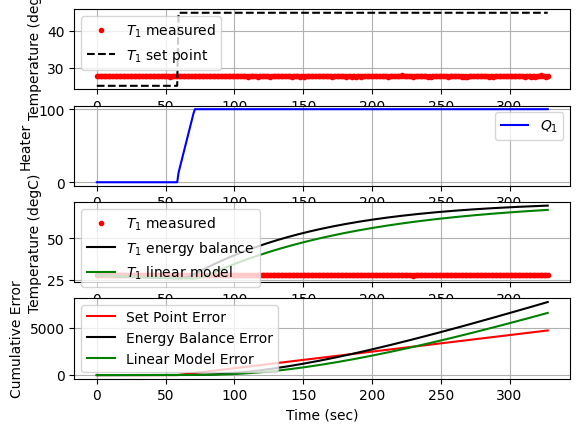

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 329.8  45.00  27.69 100.00   5.79  88.63  -0.00


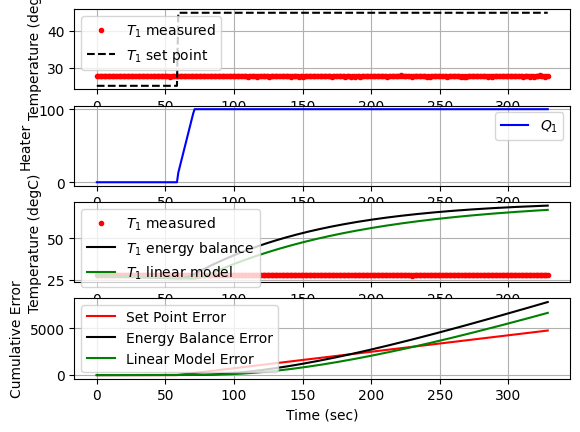

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 330.8  45.00  27.68 100.00   5.80  88.63   0.00


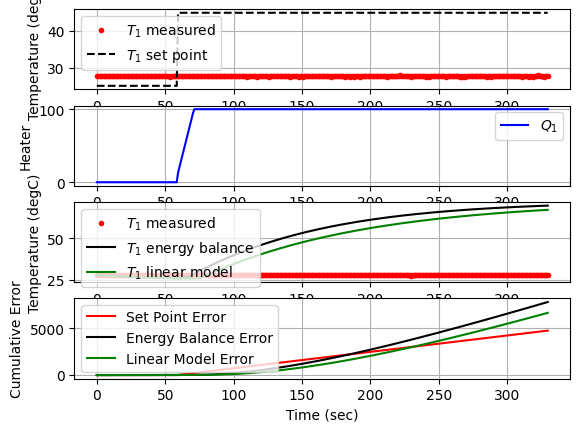

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 331.8  45.00  27.56 100.00   5.84  88.63   0.01


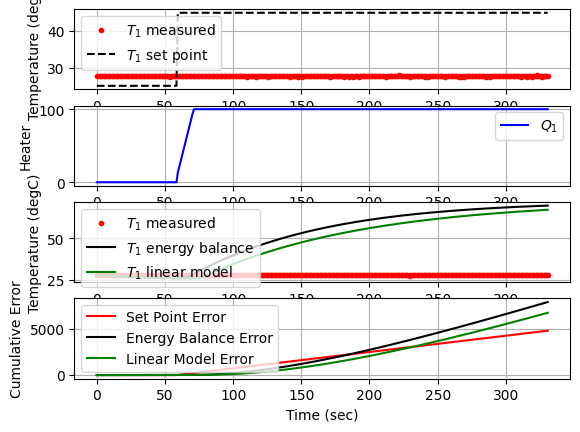

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 332.7  45.00  27.60 100.00   5.82  88.63  -0.00


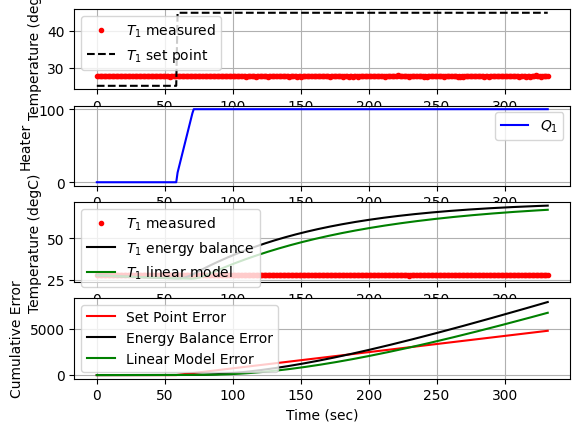

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 333.7  45.00  27.61 100.00   5.82  88.63  -0.00


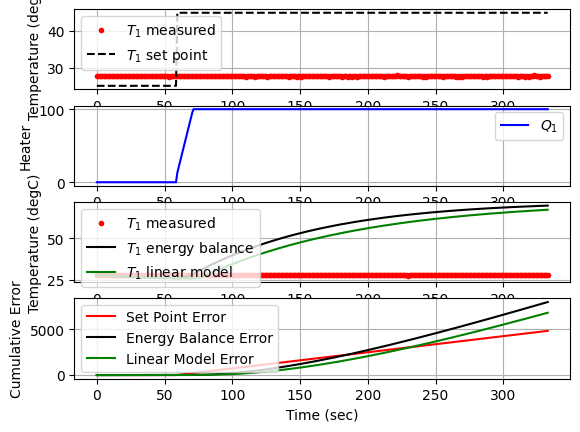

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 334.7  45.00  27.64 100.00   5.81  88.63  -0.00


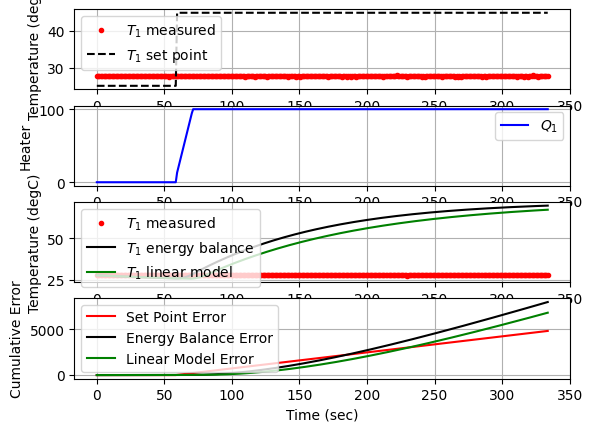

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 335.7  45.00  27.70 100.00   5.79  88.63  -0.00


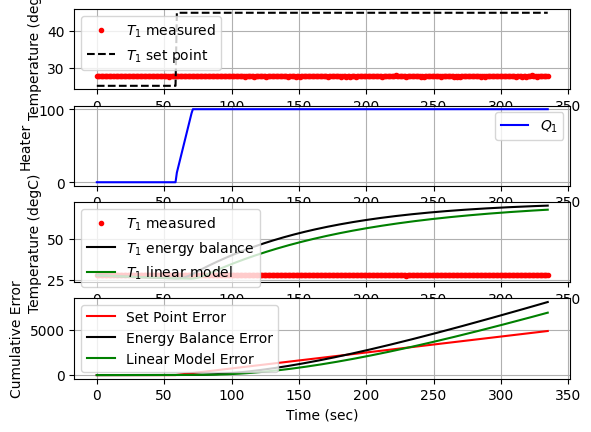

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 336.7  45.00  27.62 100.00   5.82  88.63   0.00


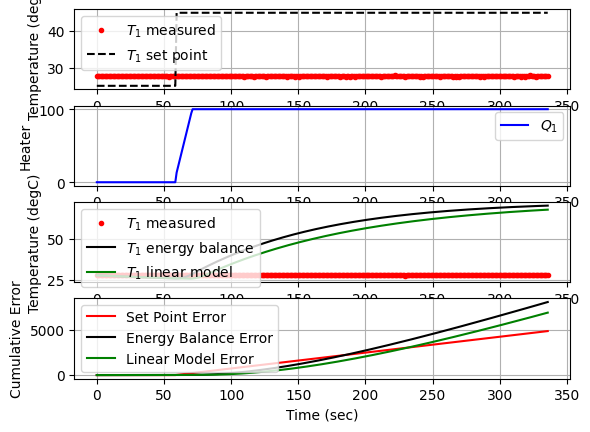

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 337.7  45.00  27.56 100.00   5.84  88.63   0.00


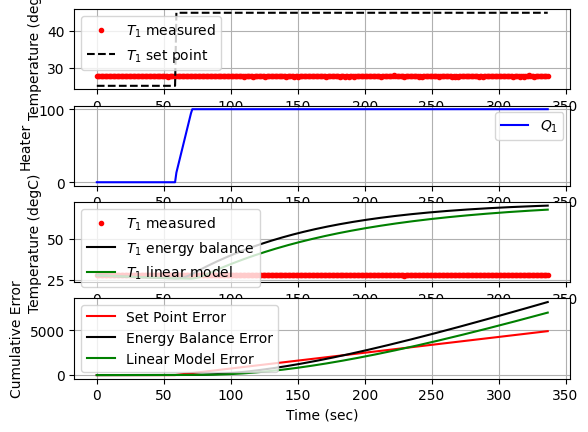

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 338.7  45.00  27.58 100.00   5.83  88.63  -0.00


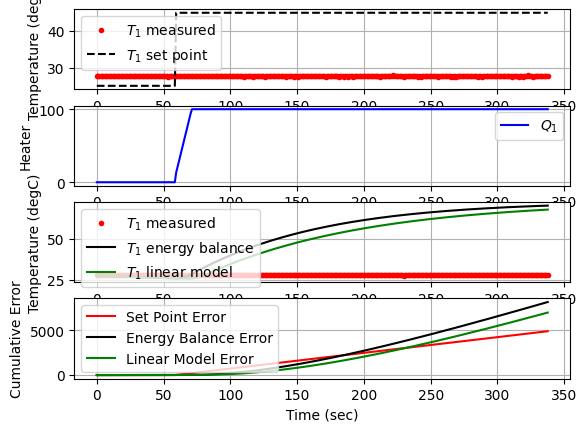

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 339.7  45.00  27.53 100.00   5.85  88.63   0.00


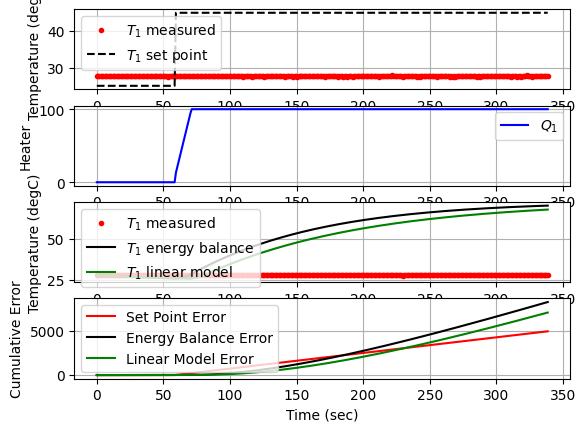

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 340.7  45.00  27.51 100.00   5.85  88.63   0.00


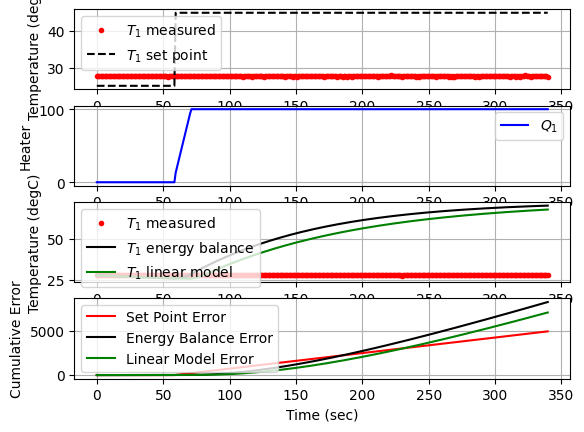

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 341.7  45.00  27.60 100.00   5.82  88.63  -0.00


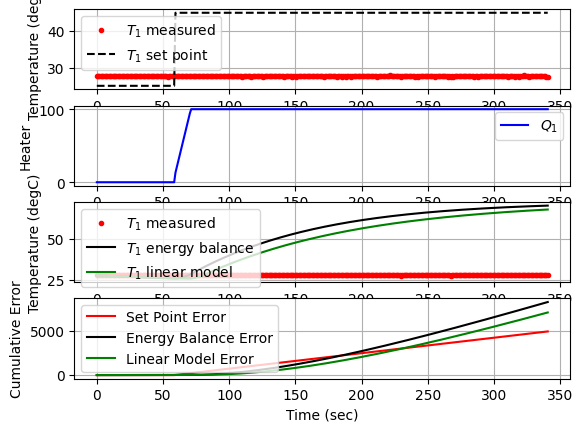

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 342.6  45.00  27.62 100.00   5.82  88.63  -0.00


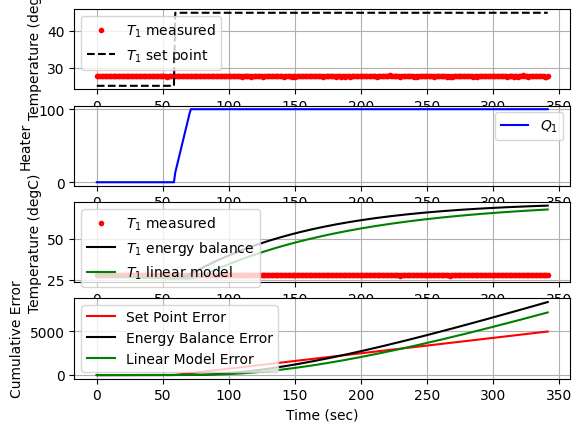

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 343.6  45.00  27.63 100.00   5.81  88.63  -0.00


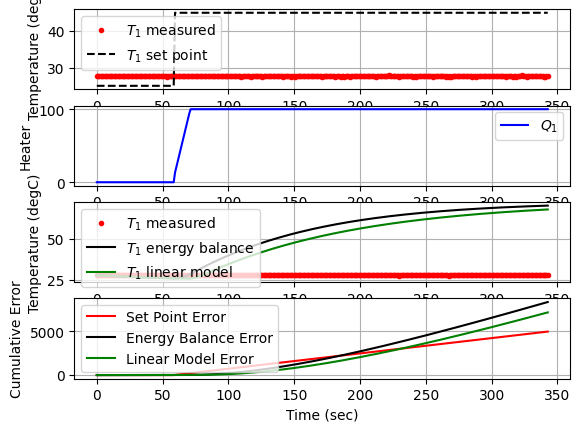

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 344.6  45.00  27.60 100.00   5.82  88.63   0.00


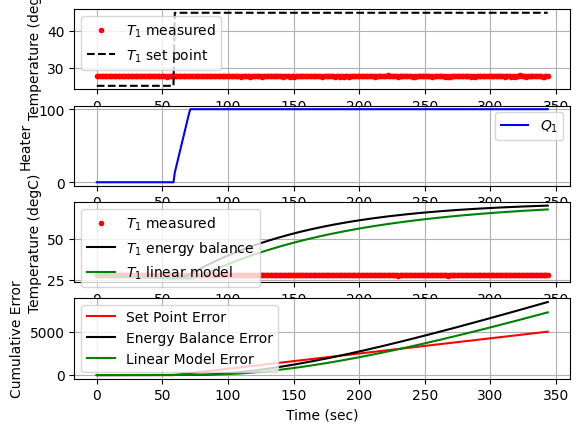

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 345.6  45.00  27.63 100.00   5.81  88.63  -0.00


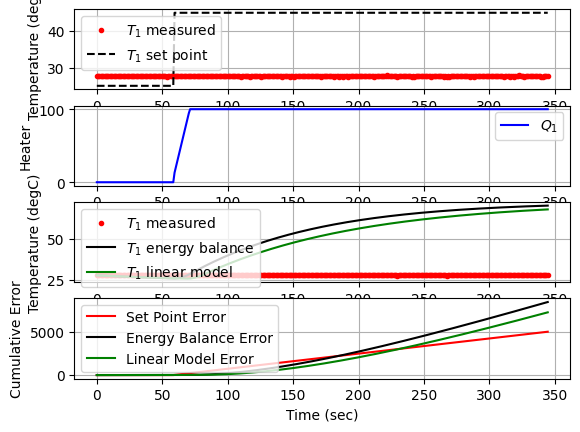

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 346.6  45.00  27.52 100.00   5.85  88.63   0.01


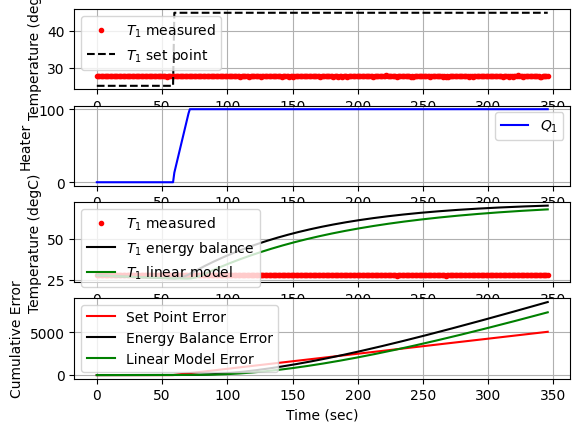

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 347.6  45.00  27.71 100.00   5.79  88.63  -0.01


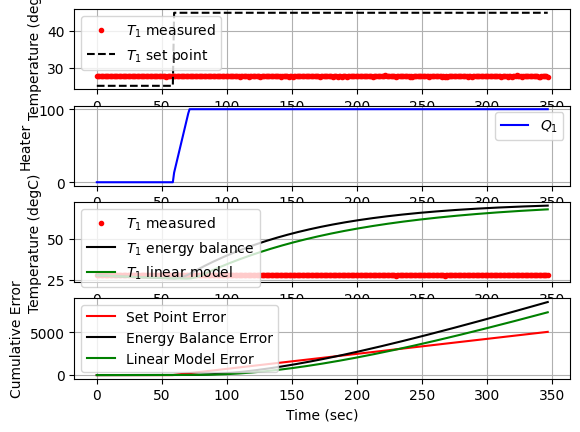

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 348.6  45.00  27.63 100.00   5.81  88.63   0.00


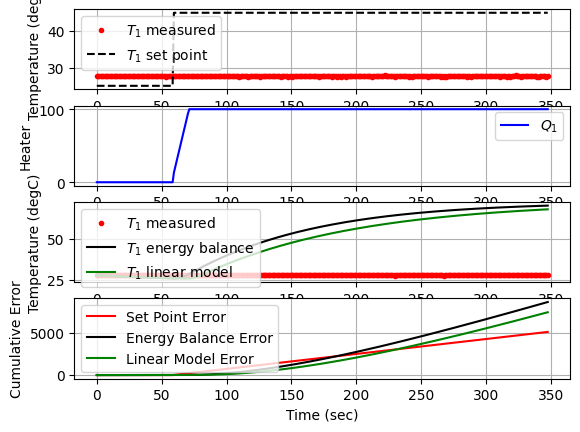

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 349.6  45.00  27.67 100.00   5.80  88.63  -0.00


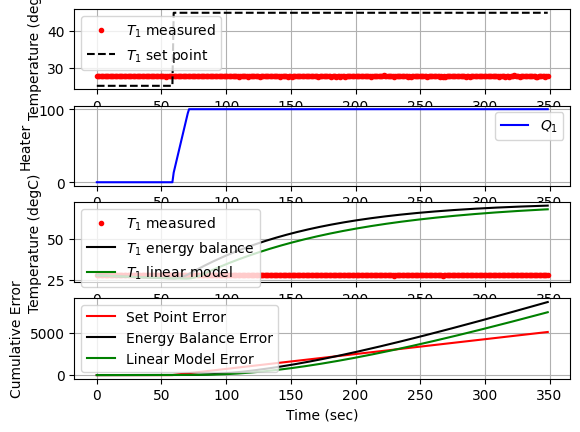

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 350.6  45.00  27.57 100.00   5.83  88.63   0.00


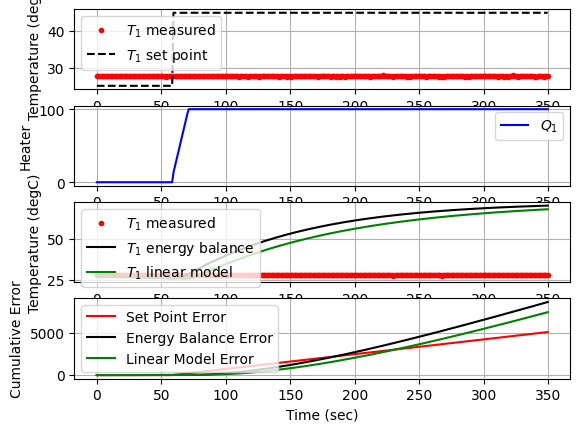

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 351.6  45.00  27.61 100.00   5.82  88.63  -0.00


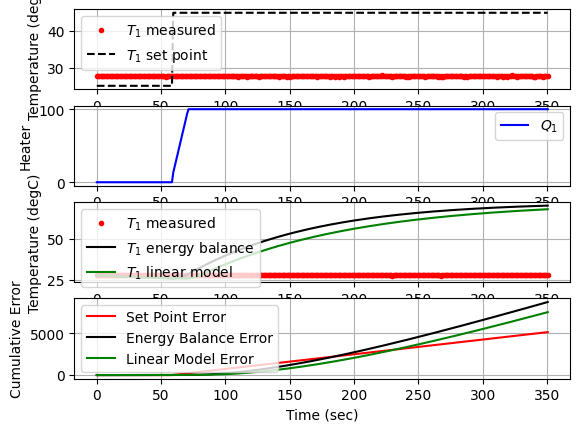

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 352.6  45.00  27.56 100.00   5.84  88.63   0.00


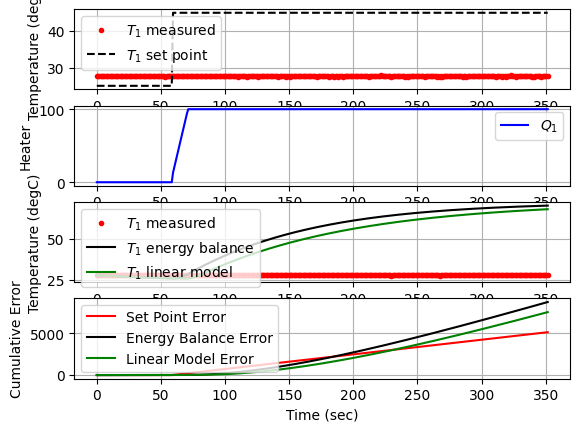

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 353.5  45.00  27.68 100.00   5.80  88.63  -0.01


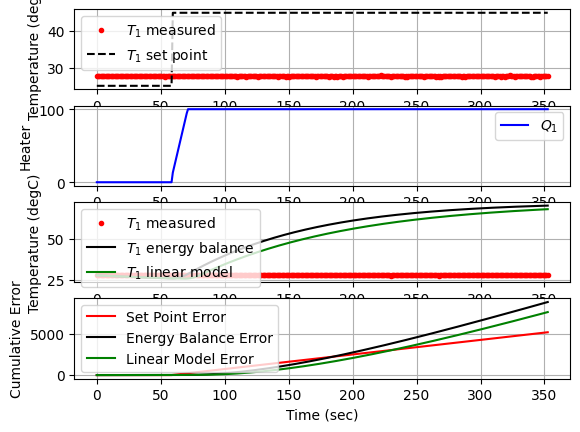

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
 354.5  45.00  27.59 100.00   5.83  88.63   0.00


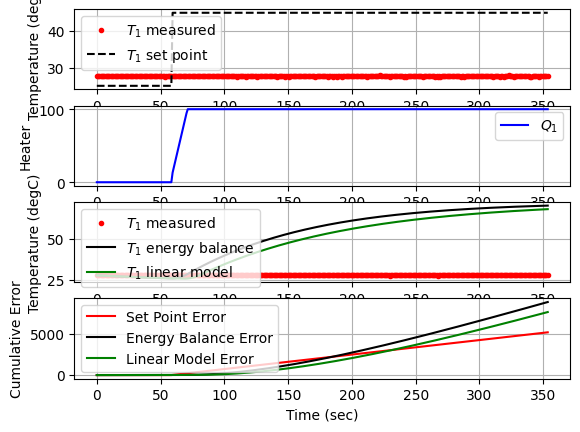

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 355.5  45.00  27.81 100.00   5.75  88.63  -0.01


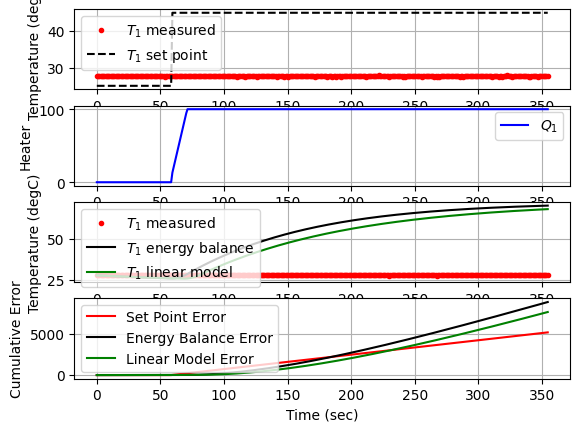

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
 356.5  30.00  27.52  90.39   0.79  89.59   0.01


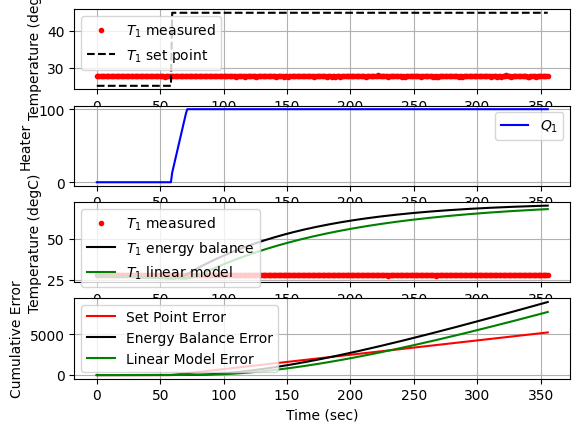

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
 357.5  30.00  27.63  91.26   0.75  90.52  -0.00


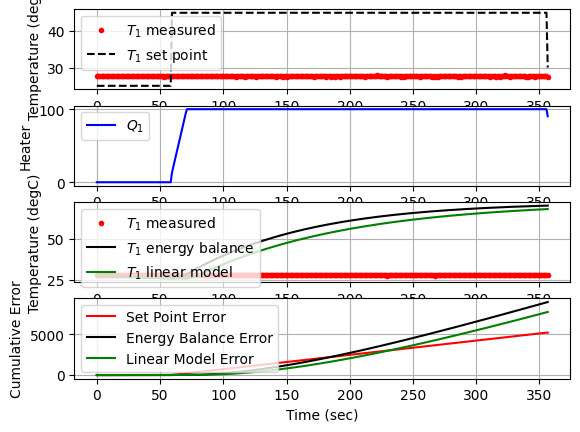

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
 358.5  30.00  27.64  92.18   0.75  91.44  -0.00


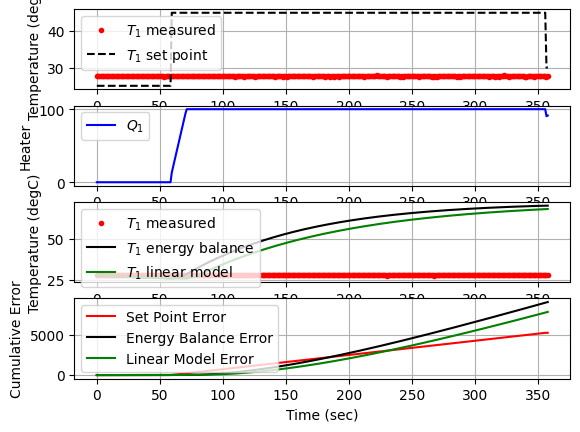

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 359.5  30.00  27.61  93.12   0.76  92.37   0.00


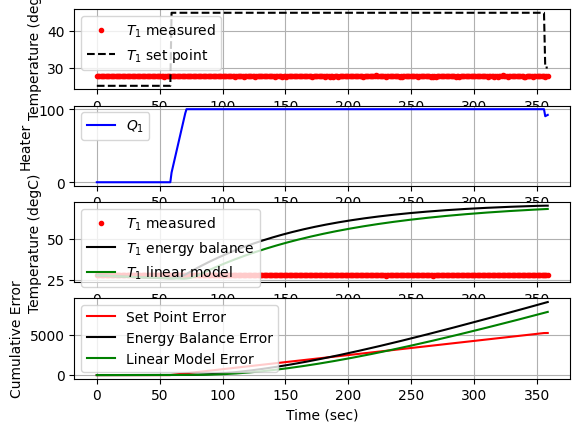

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 360.5  30.00  27.55  94.10   0.78  93.32   0.00


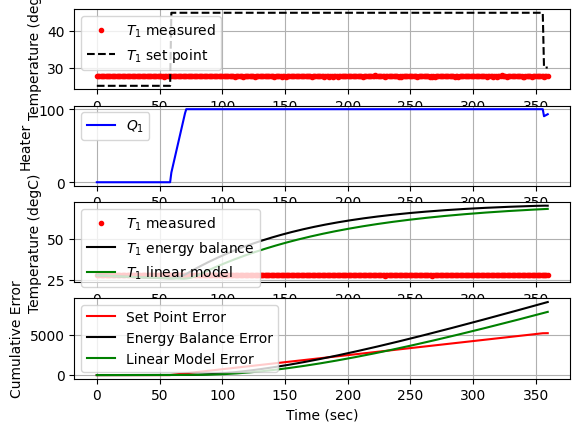

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 361.5  30.00  27.63  94.99   0.75  94.24  -0.00


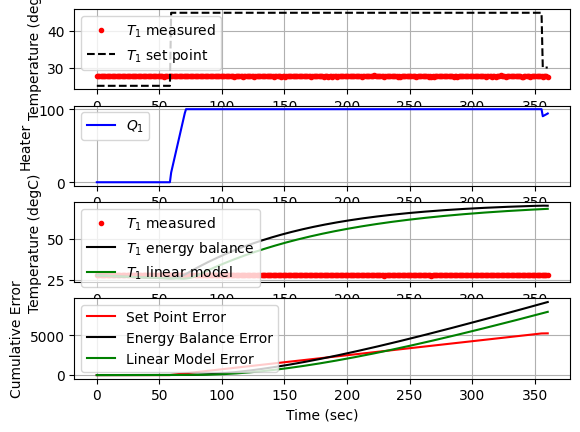

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 362.5  30.00  27.57  95.96   0.77  95.19   0.00


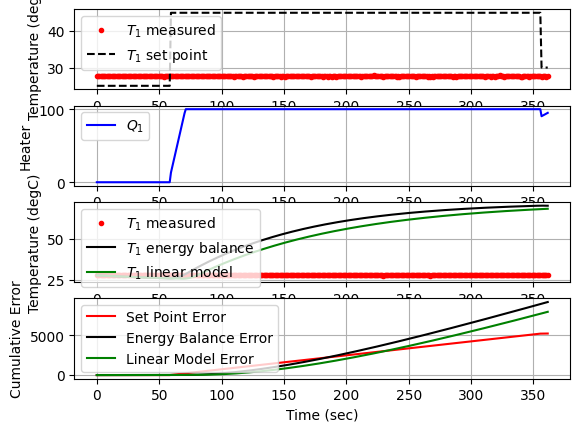

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 363.4  30.00  27.65  96.84   0.74  96.10  -0.00


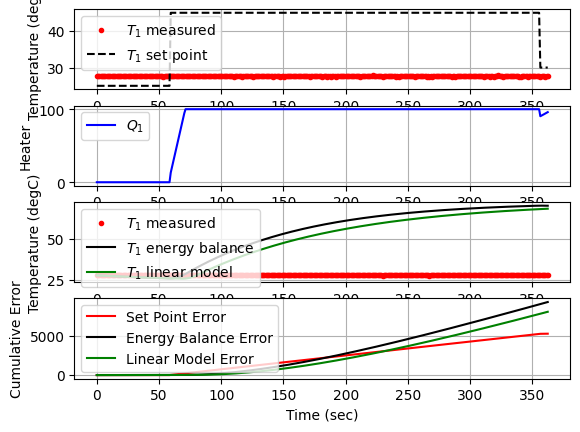

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 364.4  30.00  27.63  97.78   0.75  97.03   0.00


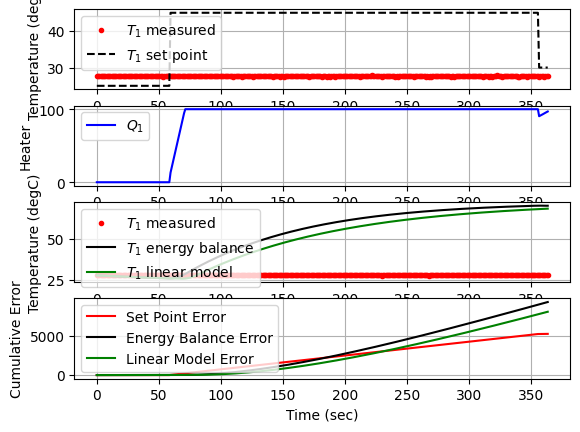

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 365.4  30.00  27.57  98.74   0.77  97.97   0.00


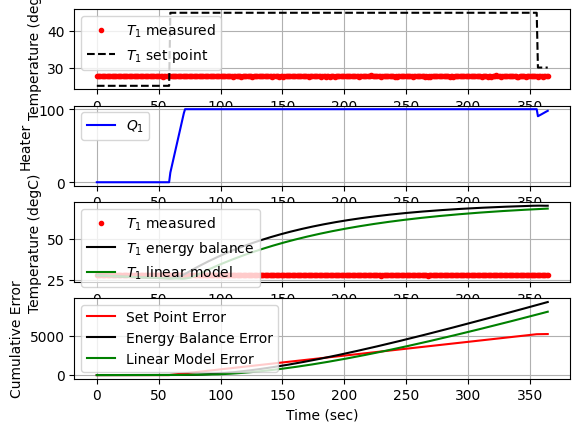

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
 366.4  30.00  27.58  99.68   0.77  98.92  -0.00


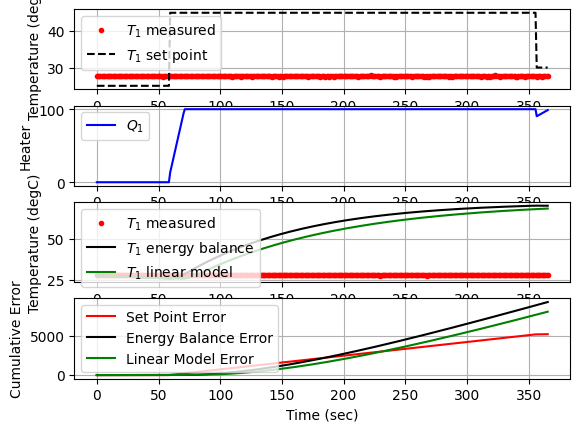

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 367.4  30.00  27.57 100.00   0.77  98.92   0.00


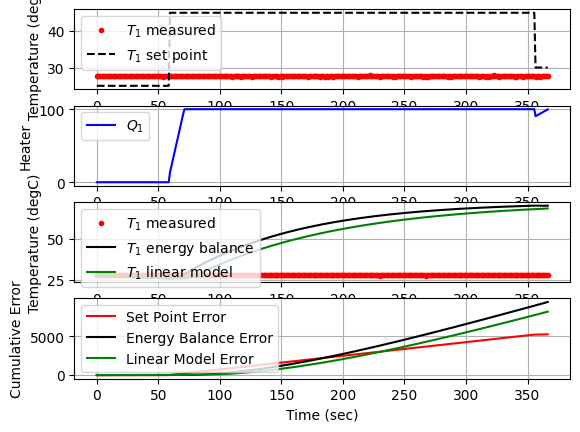

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 368.4  30.00  27.60 100.00   0.76  98.92  -0.00


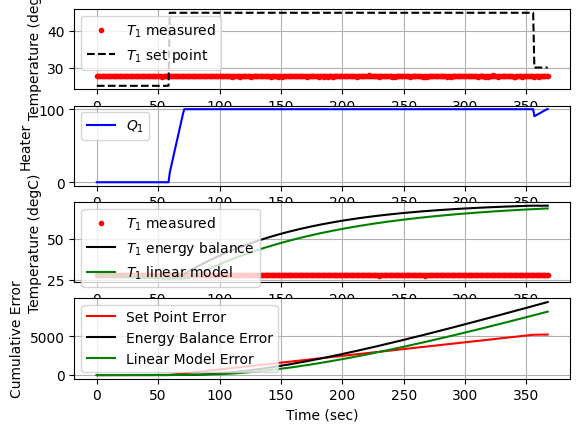

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 369.4  30.00  27.55 100.00   0.78  98.92   0.00


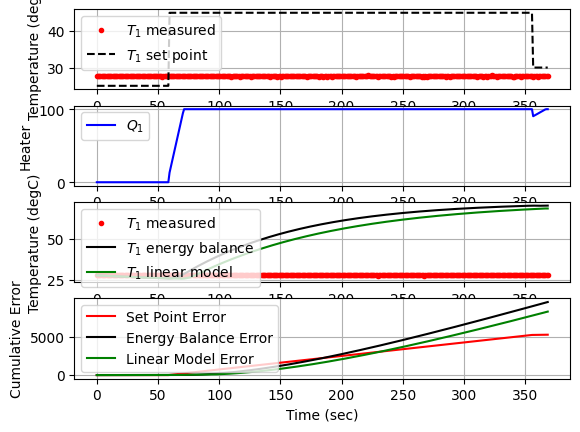

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 370.4  30.00  27.58 100.00   0.77  98.92  -0.00


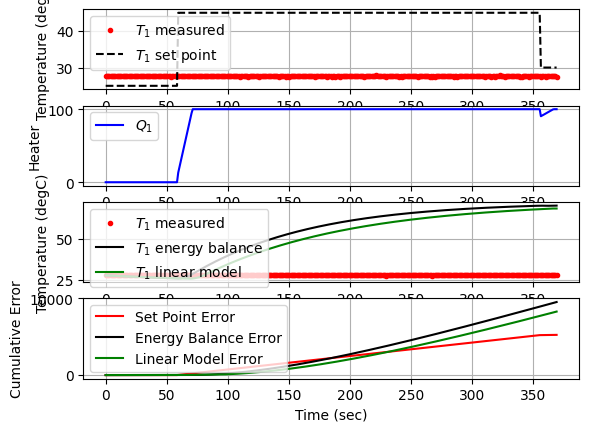

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 371.4  30.00  27.67 100.00   0.74  98.92  -0.00


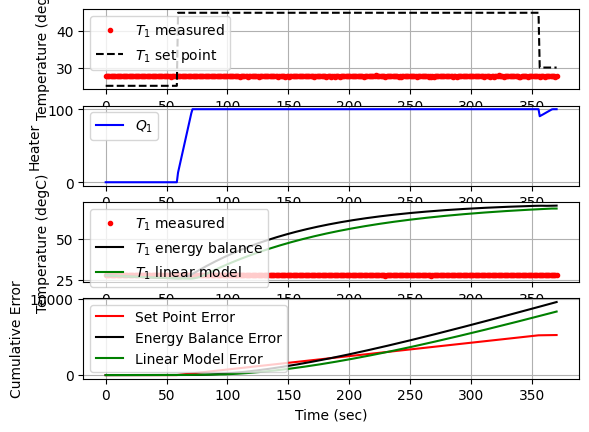

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
 372.4  30.00  27.61 100.00   0.76  98.92   0.00


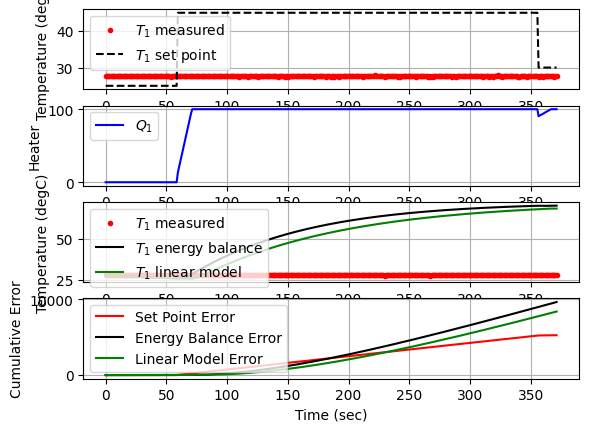

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 373.3  30.00  27.70 100.00   0.73  98.92  -0.00


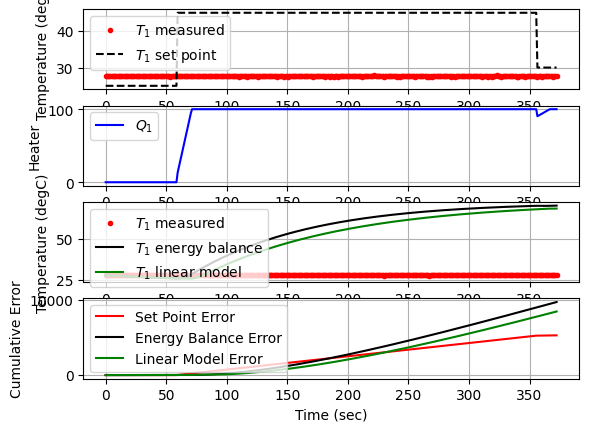

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
 374.3  30.00  27.69 100.00   0.73  98.92   0.00


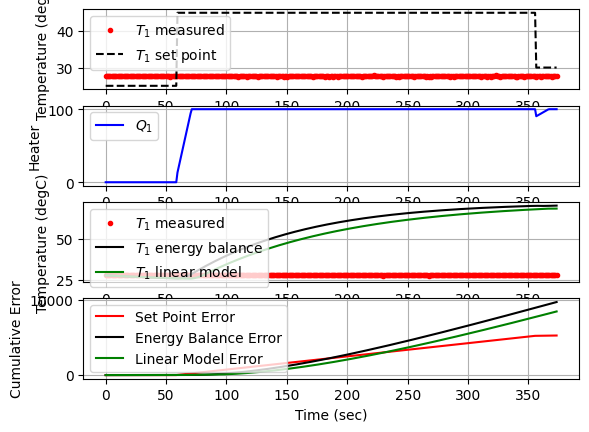

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 375.3  30.00  27.64 100.00   0.75  98.92   0.00


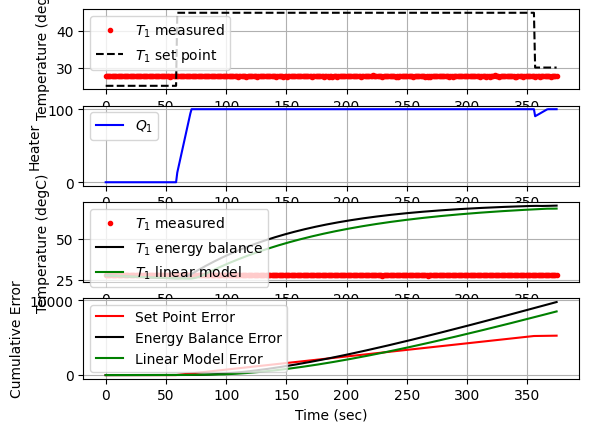

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 376.3  30.00  27.67 100.00   0.74  98.92  -0.00


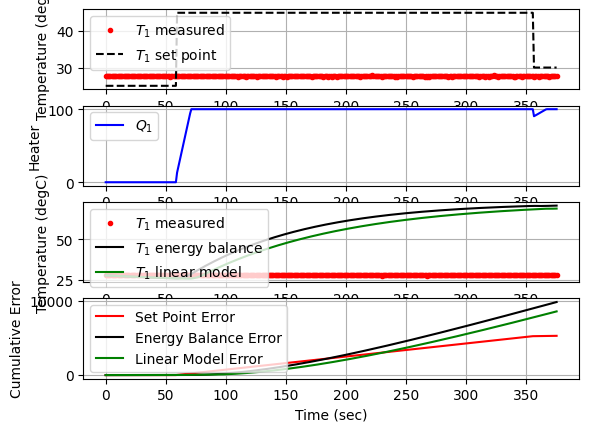

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 377.3  30.00  27.64 100.00   0.75  98.92   0.00


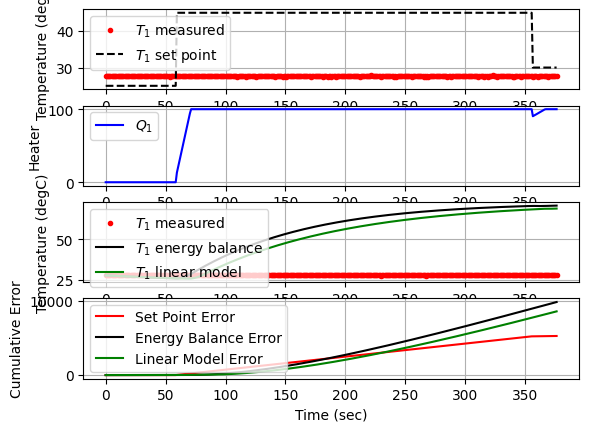

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 378.3  30.00  27.69 100.00   0.73  98.92  -0.00


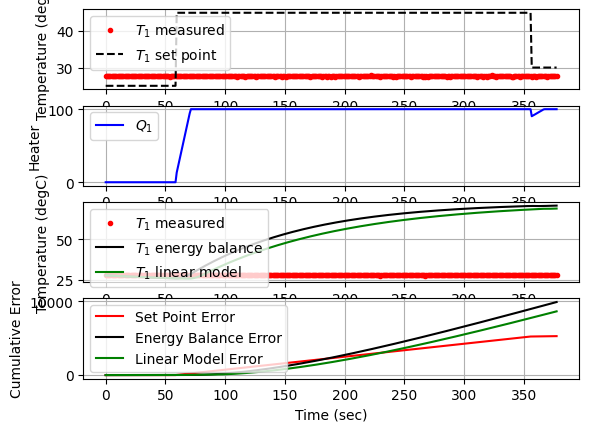

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 379.3  30.00  27.63 100.00   0.75  98.92   0.00


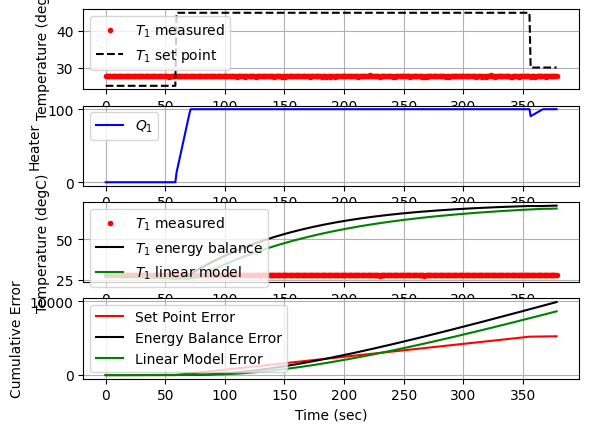

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 380.3  30.00  27.62 100.00   0.75  98.92   0.00


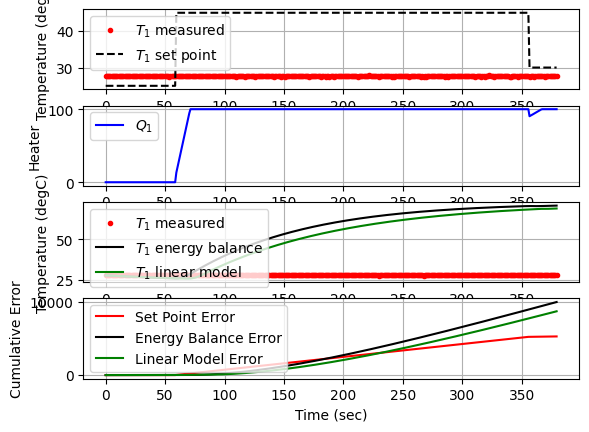

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 381.3  30.00  27.61 100.00   0.76  98.92   0.00


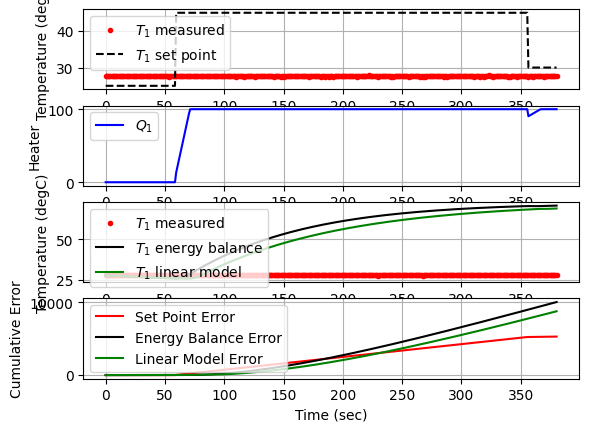

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 382.3  30.00  27.66 100.00   0.74  98.92  -0.00


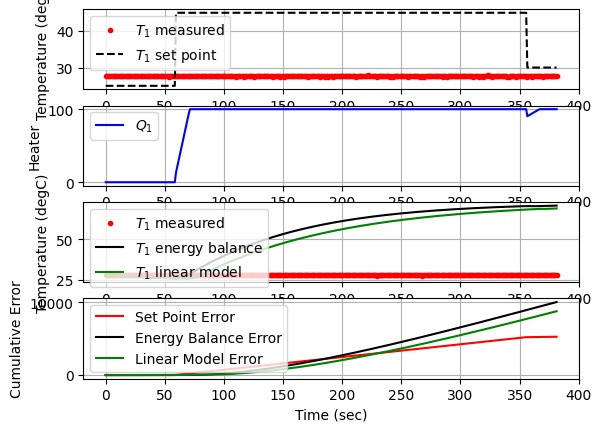

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
 383.3  30.00  27.62 100.00   0.75  98.92   0.00


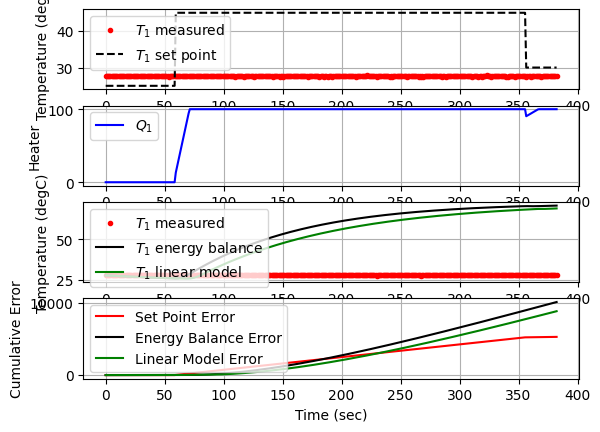

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 384.2  30.00  27.63 100.00   0.75  98.92  -0.00


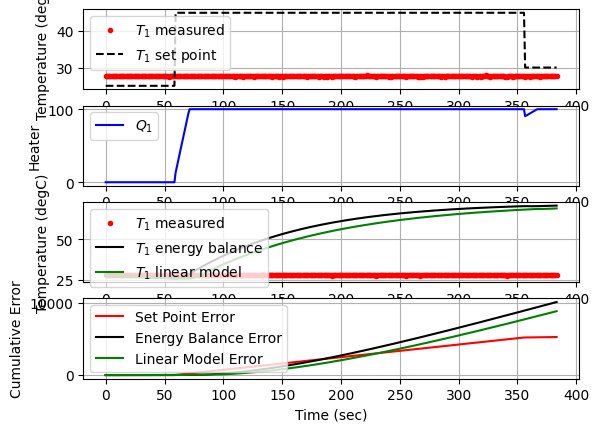

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 385.2  30.00  27.65 100.00   0.74  98.92  -0.00


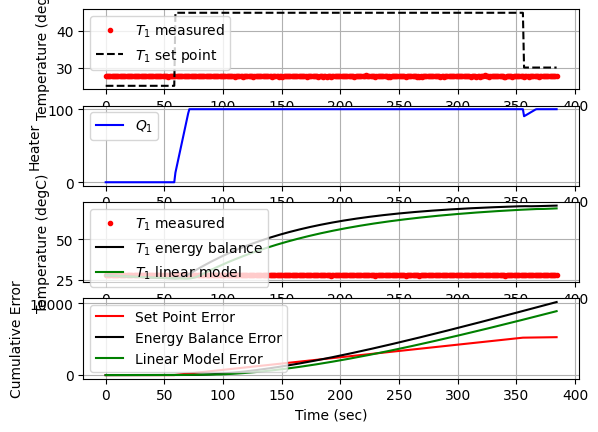

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 386.2  30.00  27.59 100.00   0.76  98.92   0.00


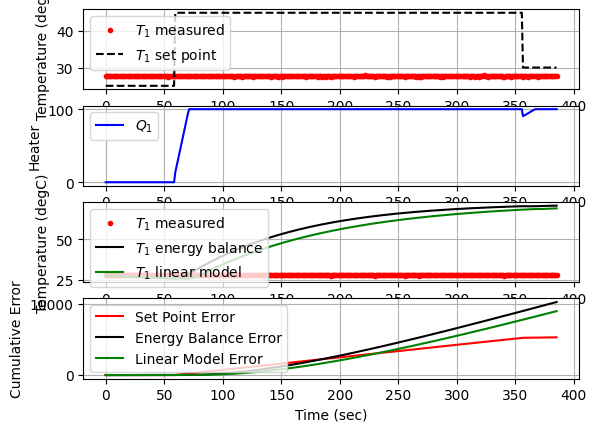

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
 387.2  30.00  27.65 100.00   0.74  98.92  -0.00


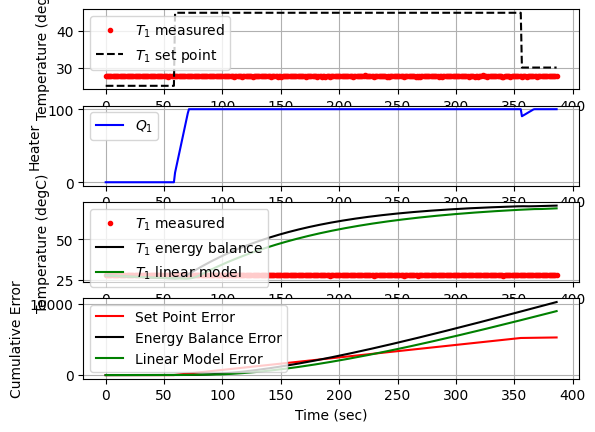

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 388.2  30.00  27.65 100.00   0.74  98.92  -0.00


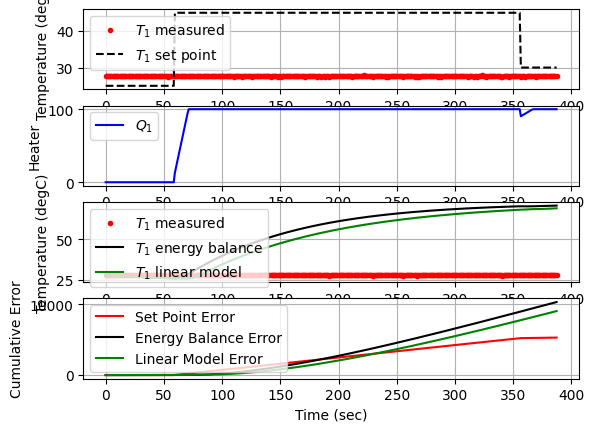

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 389.2  30.00  27.65 100.00   0.74  98.92  -0.00


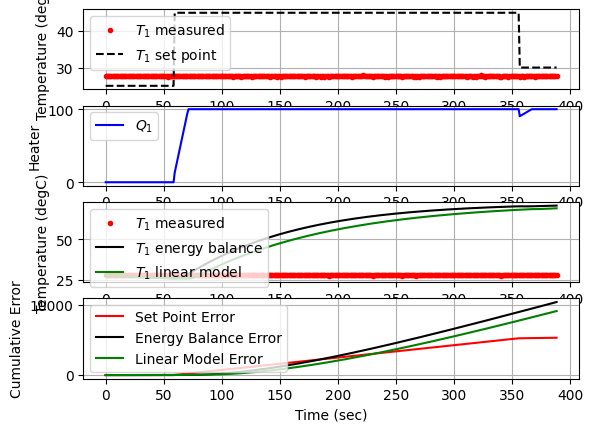

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 390.2  30.00  27.60 100.00   0.76  98.92   0.00


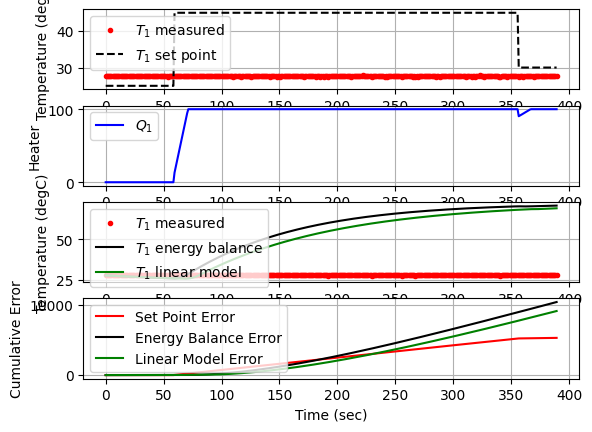

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 391.2  30.00  27.65 100.00   0.74  98.92  -0.00


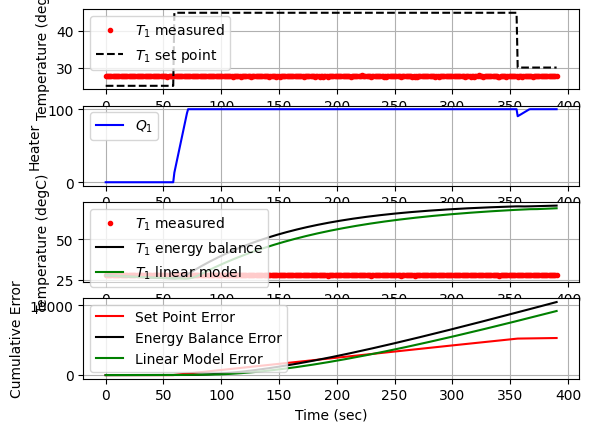

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 392.2  30.00  27.67 100.00   0.74  98.92  -0.00


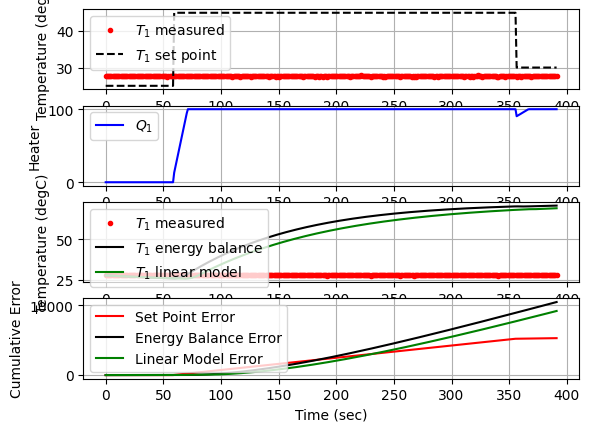

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
 393.2  30.00  27.61 100.00   0.76  98.92   0.00


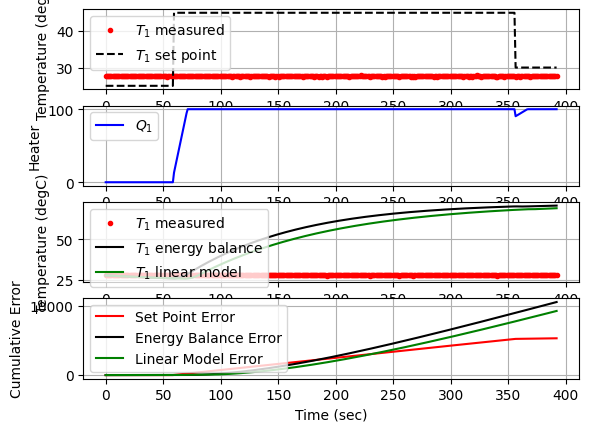

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 394.2  30.00  27.63 100.00   0.75  98.92  -0.00


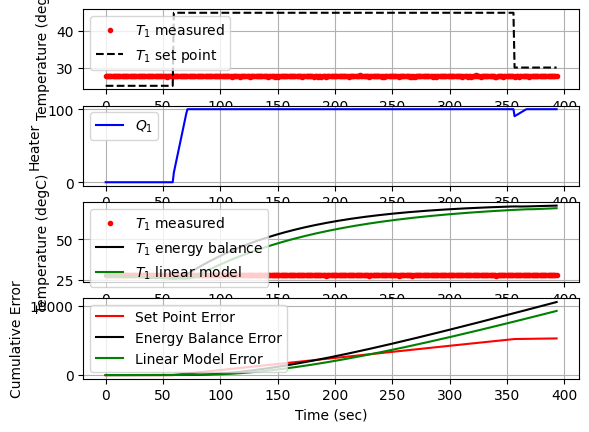

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 395.2  30.00  27.61 100.00   0.76  98.92   0.00


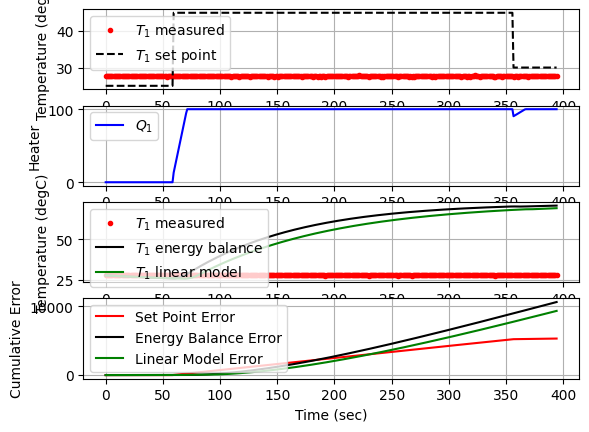

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 396.2  30.00  27.59 100.00   0.76  98.92   0.00


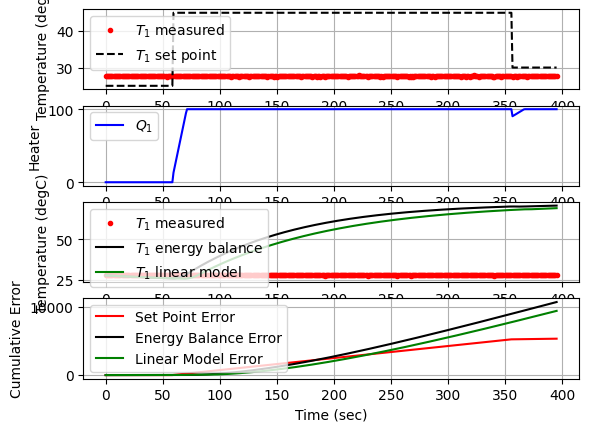

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 397.1  30.00  27.62 100.00   0.75  98.92  -0.00


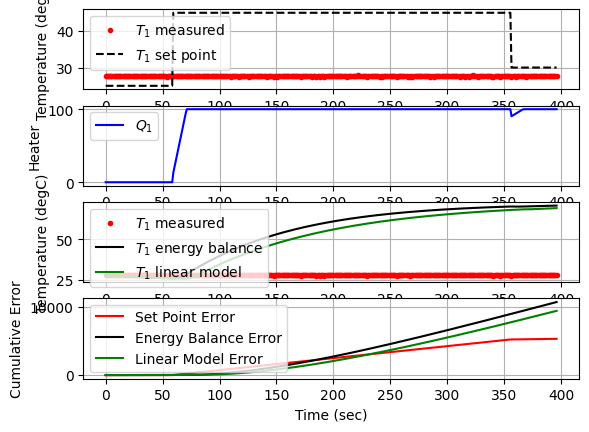

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 398.1  30.00  27.71 100.00   0.72  98.92  -0.00


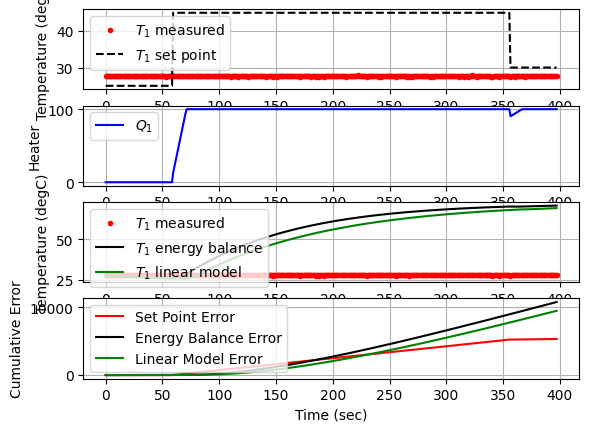

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 399.1  30.00  27.67 100.00   0.74  98.92   0.00


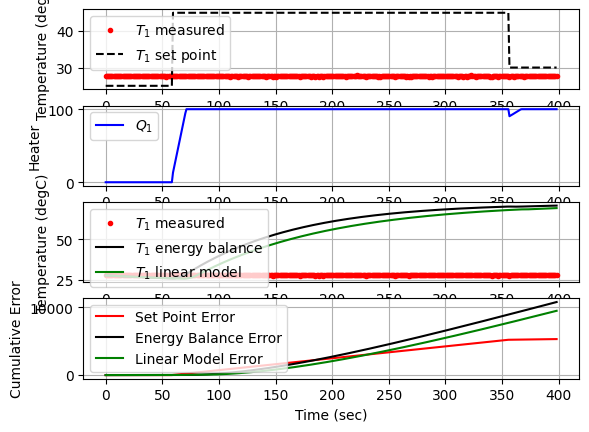

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
 400.1  30.00  27.61 100.00   0.76  98.92   0.00


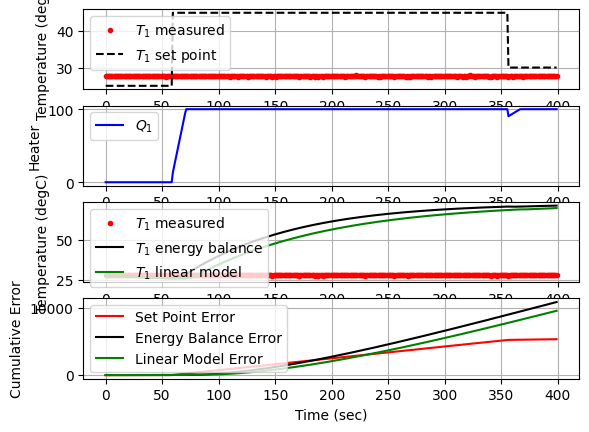

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 401.1  30.00  27.68 100.00   0.73  98.92  -0.00


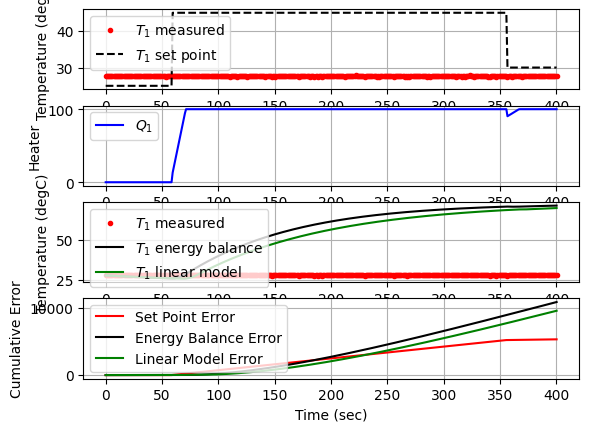

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 402.1  30.00  27.64 100.00   0.75  98.92   0.00


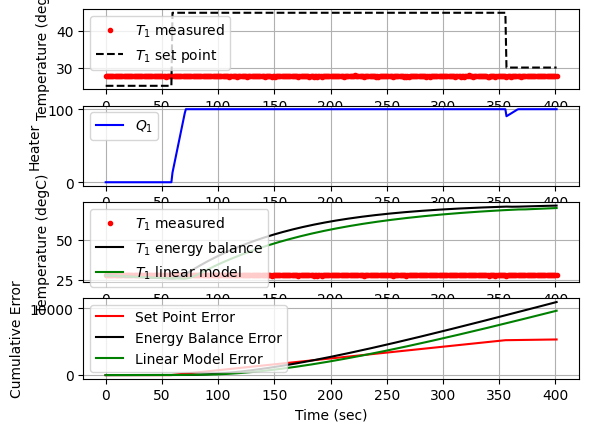

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 403.1  30.00  27.61 100.00   0.76  98.92   0.00


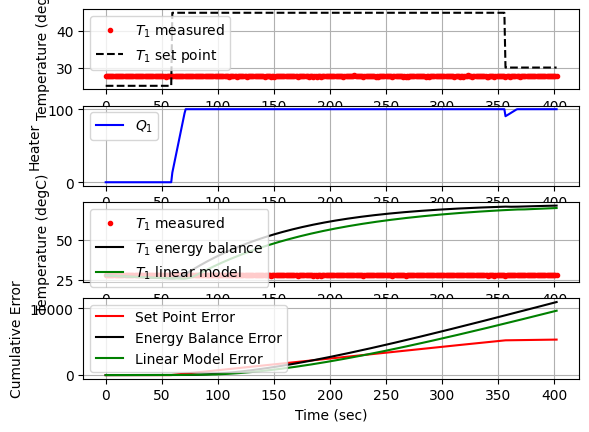

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
 404.1  30.00  27.53 100.00   0.78  98.92   0.00


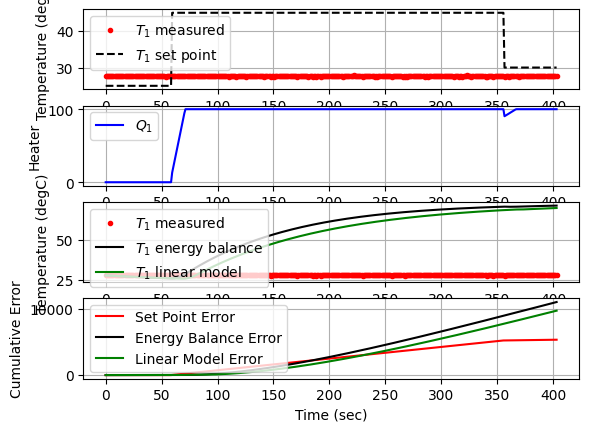

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 405.1  30.00  27.64 100.00   0.75  98.92  -0.00


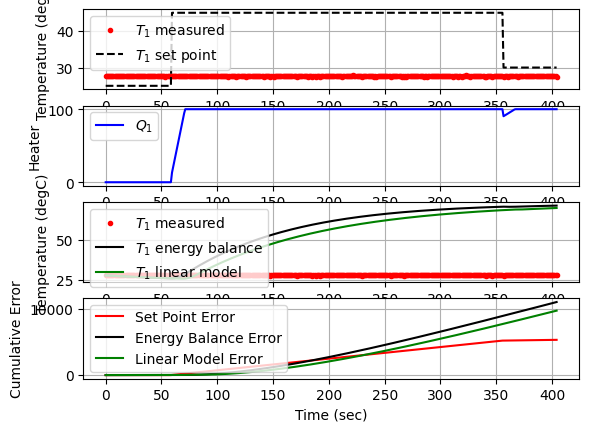

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 406.1  30.00  27.67 100.00   0.74  98.92  -0.00


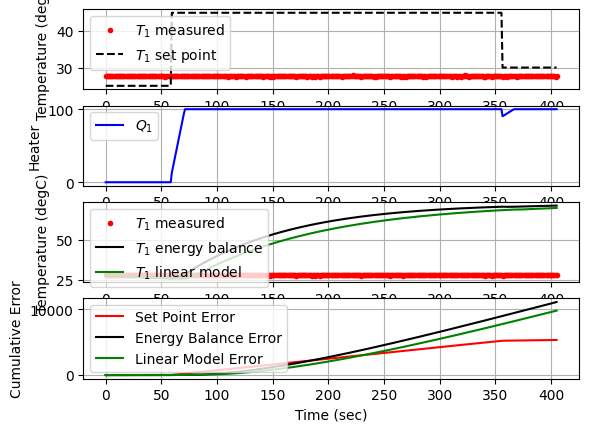

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 407.0  30.00  27.65 100.00   0.74  98.92   0.00


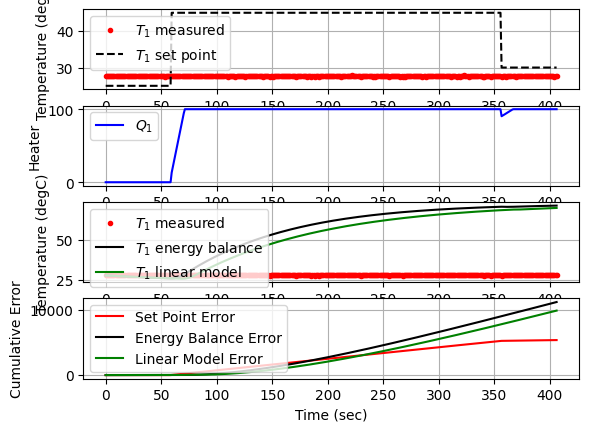

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
 408.0  30.00  27.61 100.00   0.76  98.92   0.00


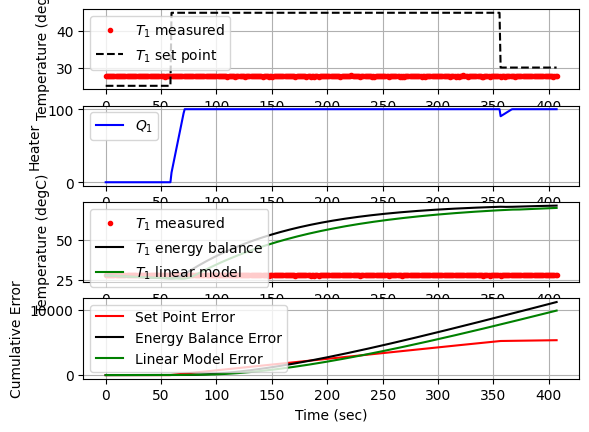

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 409.0  30.00  27.51 100.00   0.79  98.92   0.00


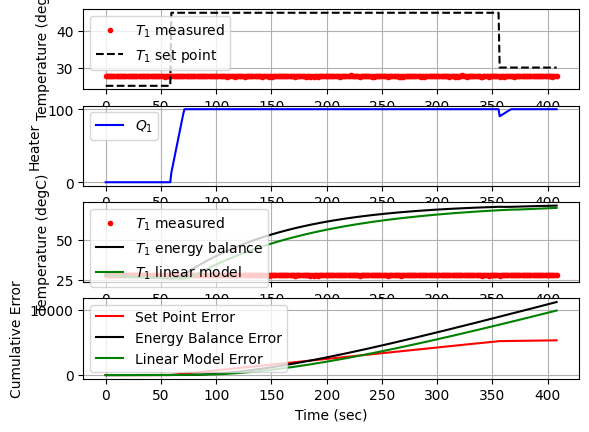

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 410.0  30.00  27.72 100.00   0.72  98.92  -0.01


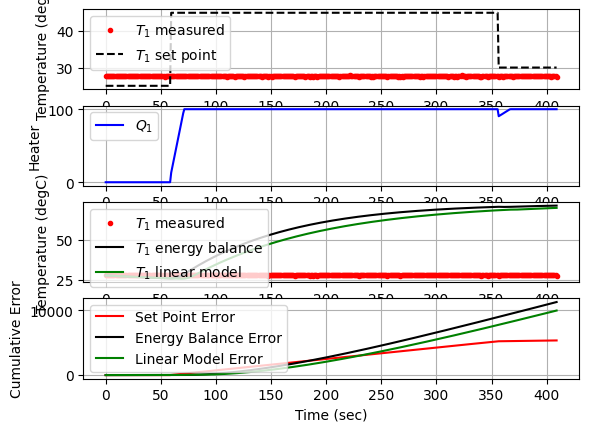

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
 411.0  30.00  27.69 100.00   0.73  98.92   0.00


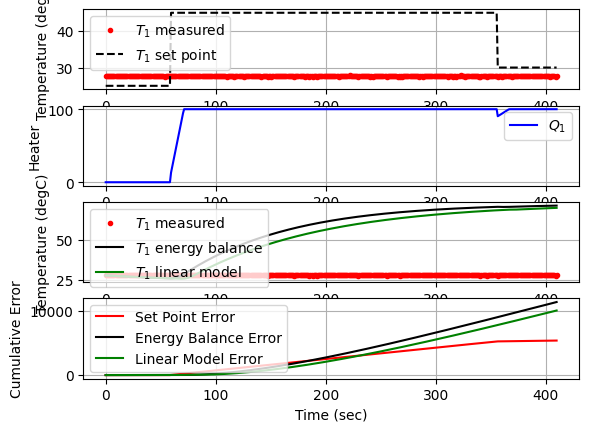

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
 412.0  30.00  27.67 100.00   0.74  98.92   0.00


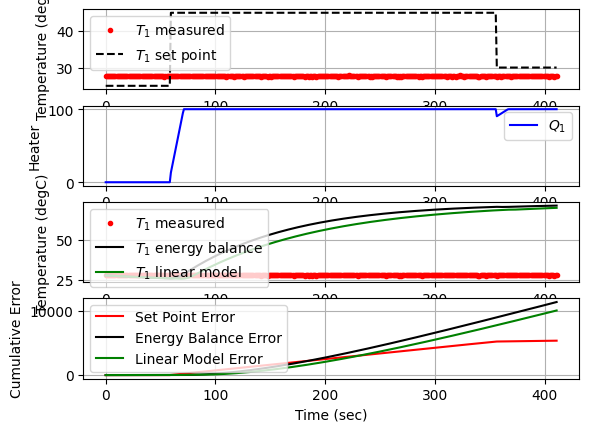

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
 413.0  30.00  27.59 100.00   0.76  98.92   0.00


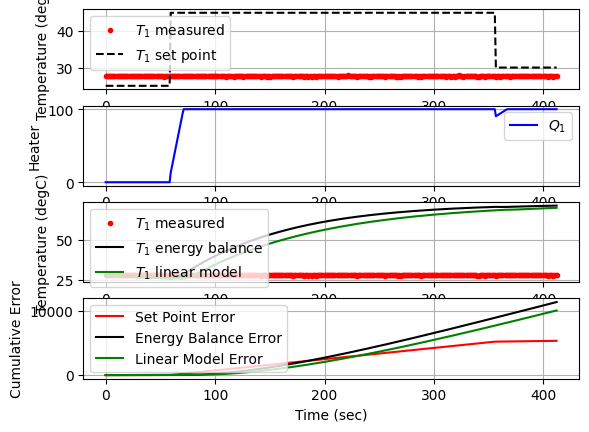

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 414.0  30.00  27.66 100.00   0.74  98.92  -0.00


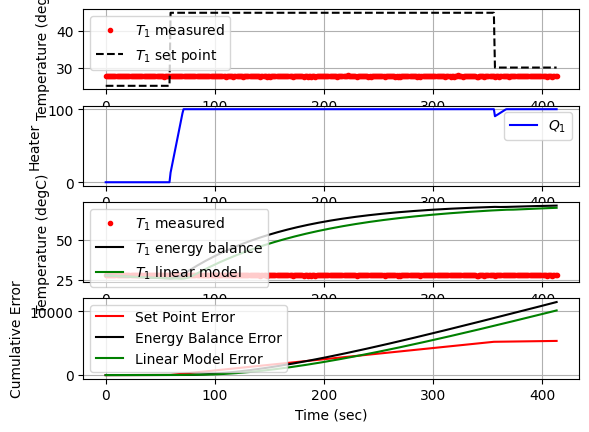

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 415.0  30.00  27.68 100.00   0.73  98.92  -0.00


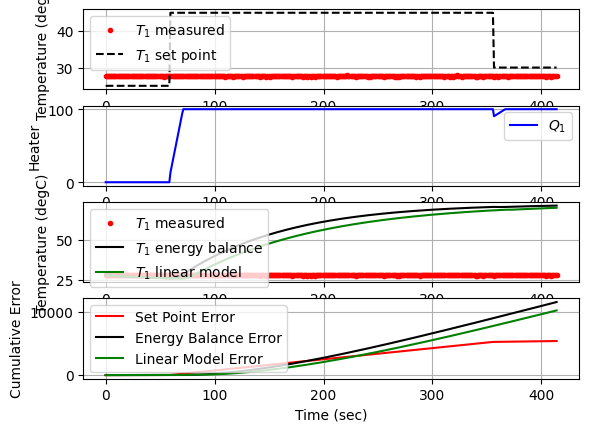

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 416.0  30.00  27.61 100.00   0.76  98.92   0.00


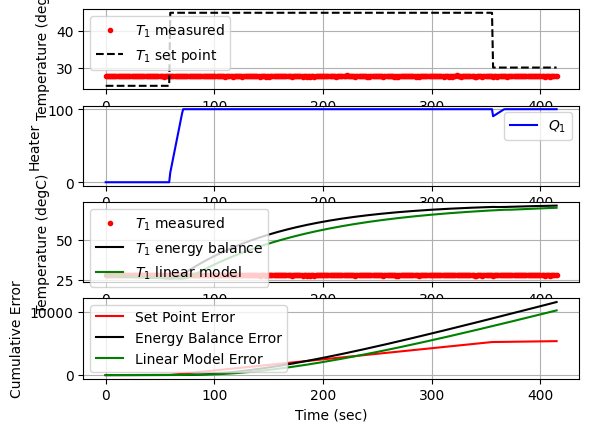

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
 416.9  30.00  27.61 100.00   0.76  98.92  -0.00


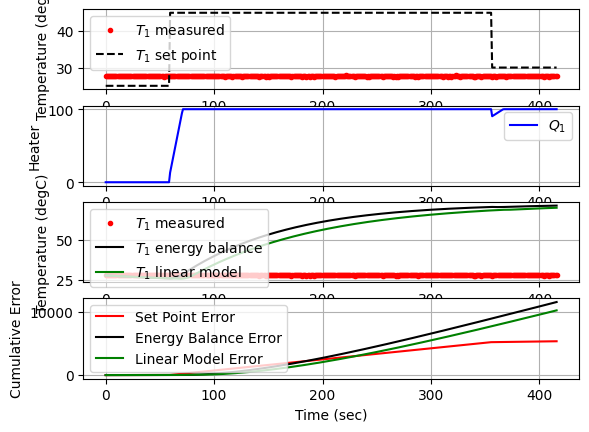

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 417.9  30.00  27.68 100.00   0.73  98.92  -0.00


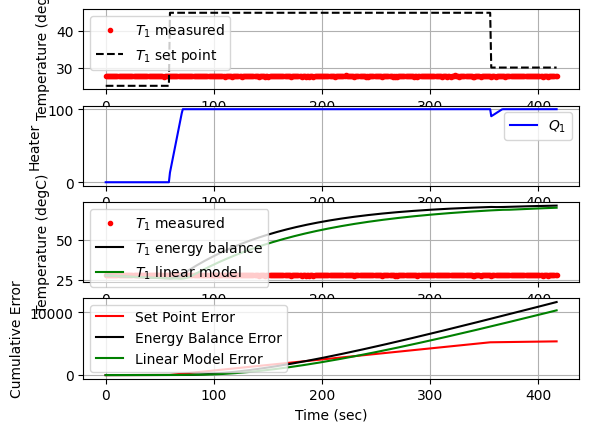

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 418.9  30.00  27.66 100.00   0.74  98.92   0.00


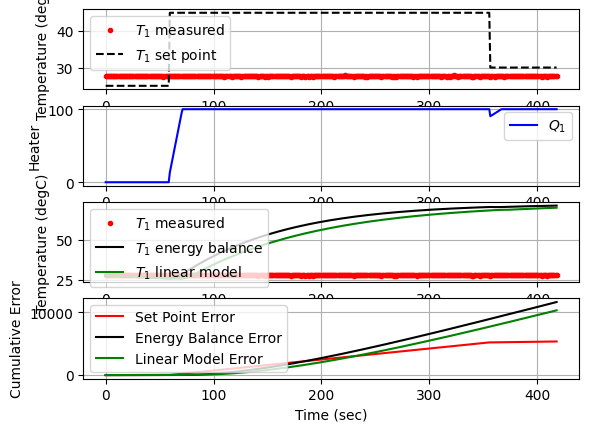

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 419.9  30.00  27.57 100.00   0.77  98.92   0.00


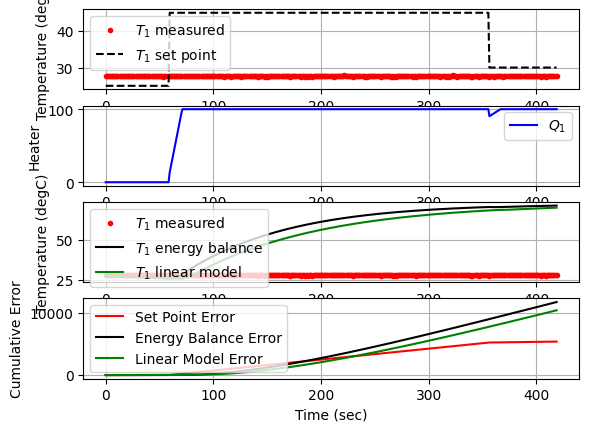

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
 420.9  30.00  27.77 100.00   0.70  98.92  -0.01


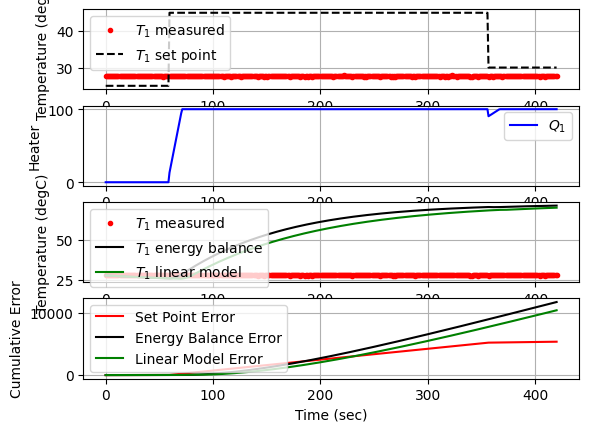

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
 421.9  30.00  27.61 100.00   0.76  98.92   0.01


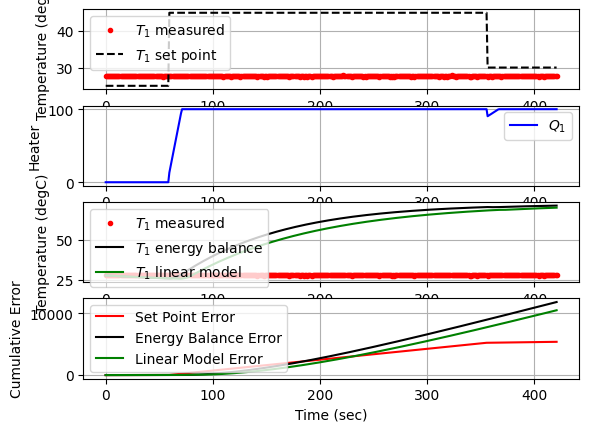

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 422.9  30.00  27.64 100.00   0.75  98.92  -0.00


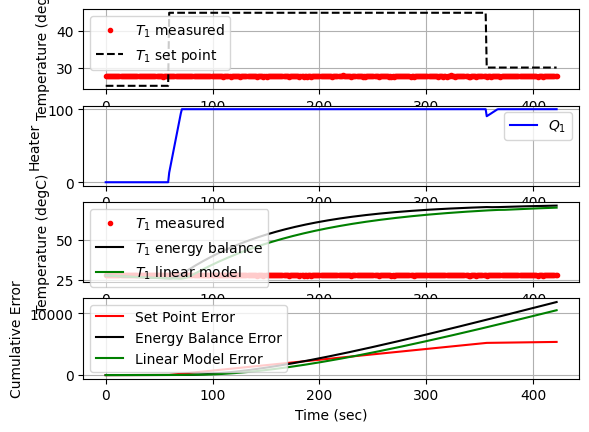

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
 423.9  30.00  27.64 100.00   0.75  98.92  -0.00


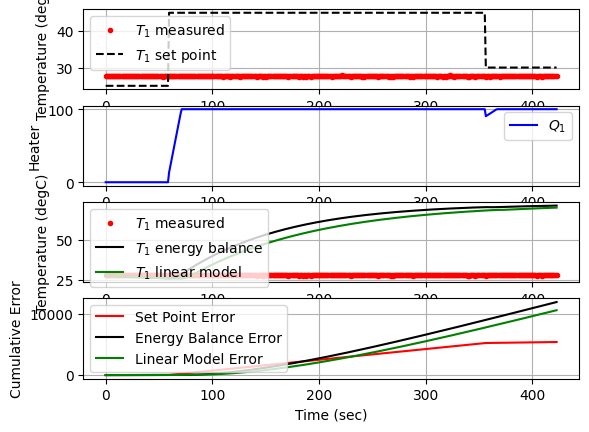

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 424.9  30.00  27.60 100.00   0.76  98.92   0.00


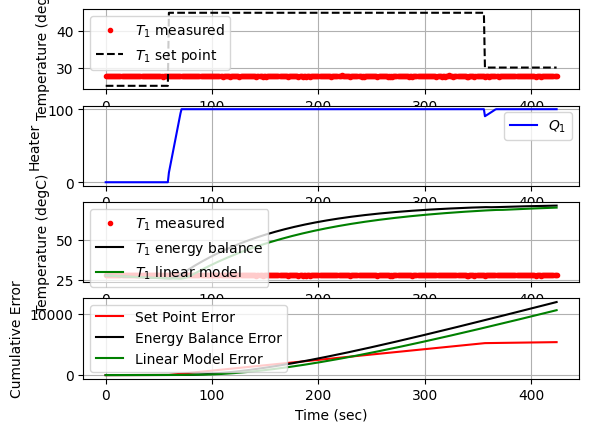

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 425.9  30.00  27.53 100.00   0.78  98.92   0.00


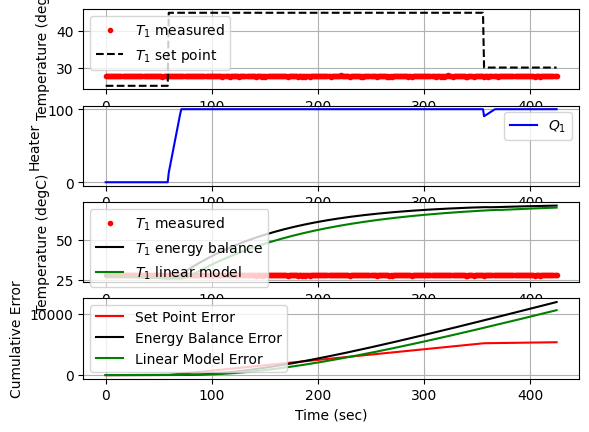

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 426.9  30.00  27.57 100.00   0.77  98.92  -0.00


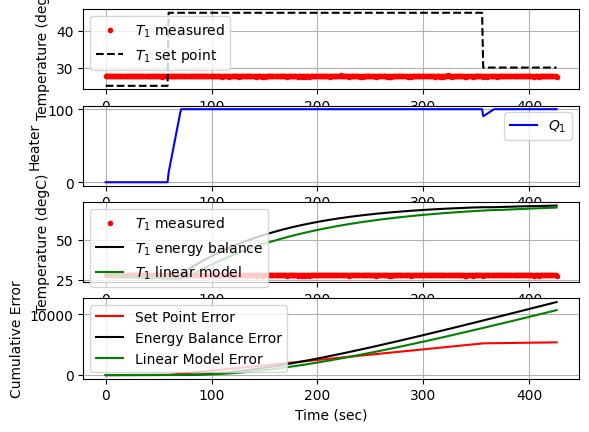

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 427.8  30.00  27.61 100.00   0.76  98.92  -0.00


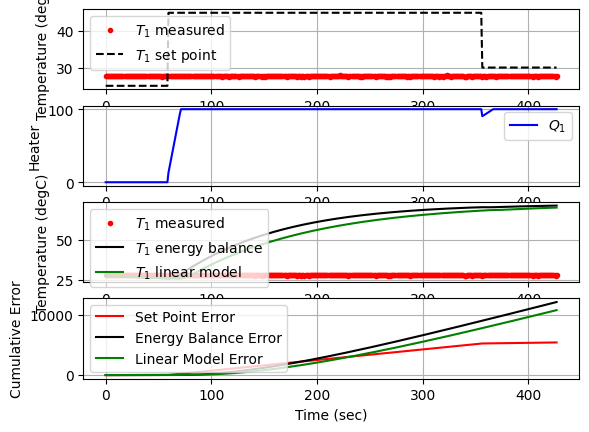

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 428.8  30.00  27.75 100.00   0.71  98.92  -0.01


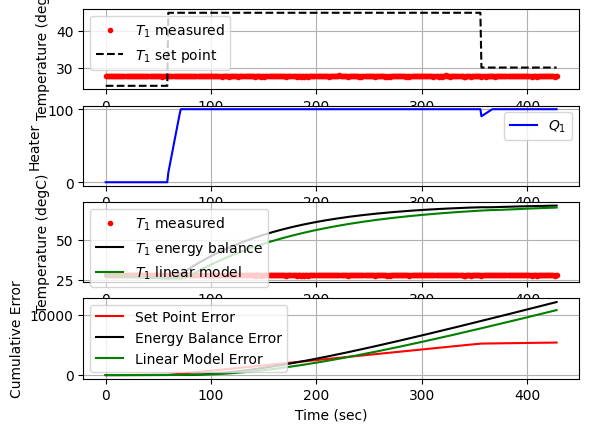

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 429.8  30.00  27.58 100.00   0.77  98.92   0.01


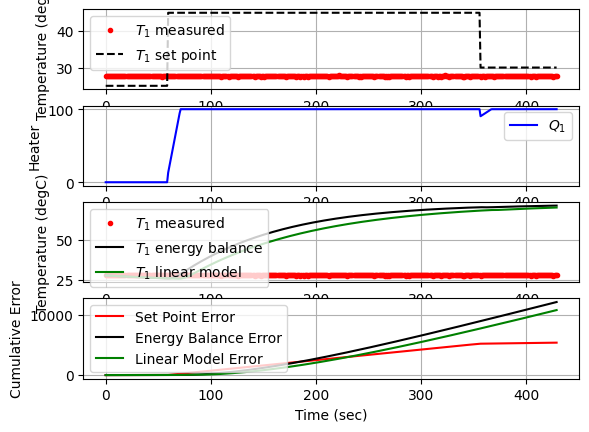

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 430.8  30.00  27.61 100.00   0.76  98.92  -0.00


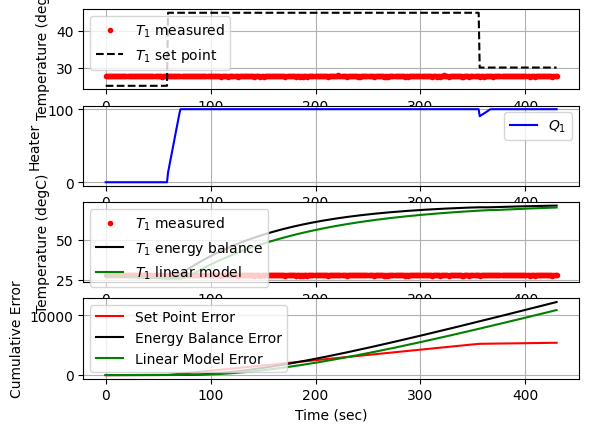

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 431.8  30.00  27.62 100.00   0.75  98.92  -0.00


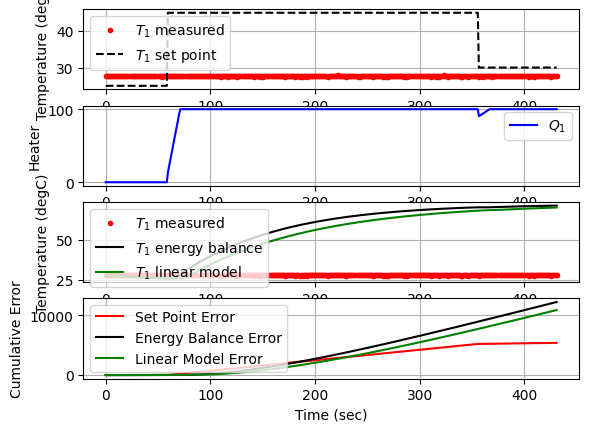

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 432.8  30.00  27.58 100.00   0.77  98.92   0.00


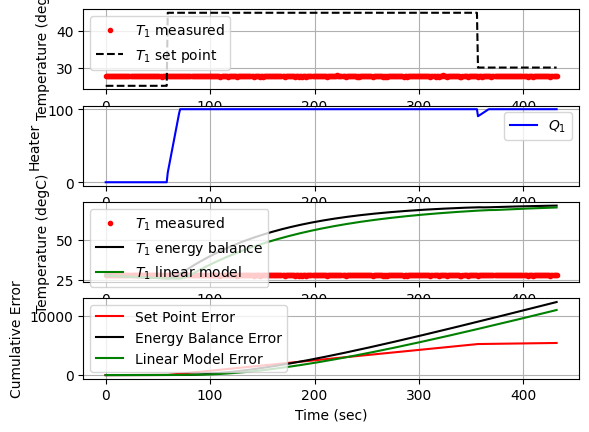

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 433.8  30.00  27.61 100.00   0.76  98.92  -0.00


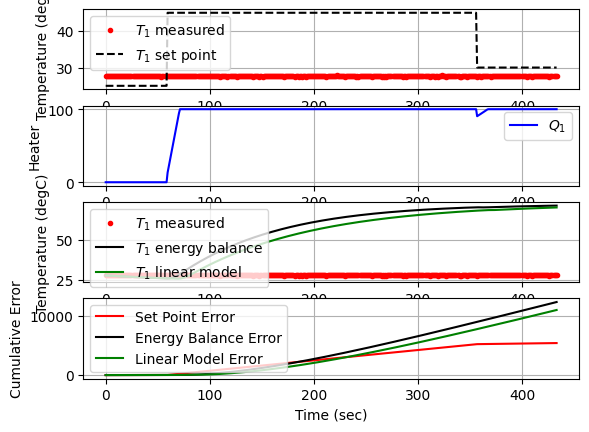

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 434.8  30.00  27.70 100.00   0.73  98.92  -0.00


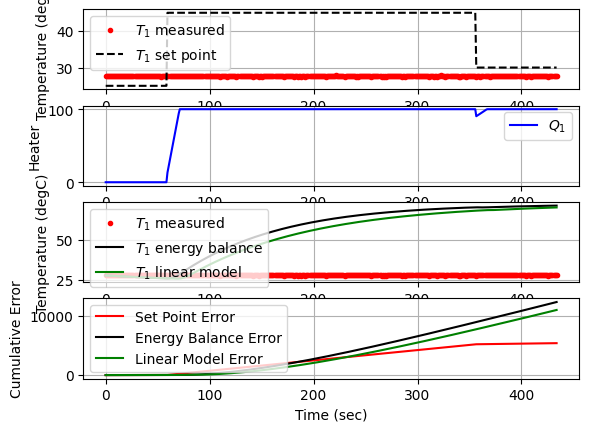

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
 435.8  30.00  27.59 100.00   0.76  98.92   0.00


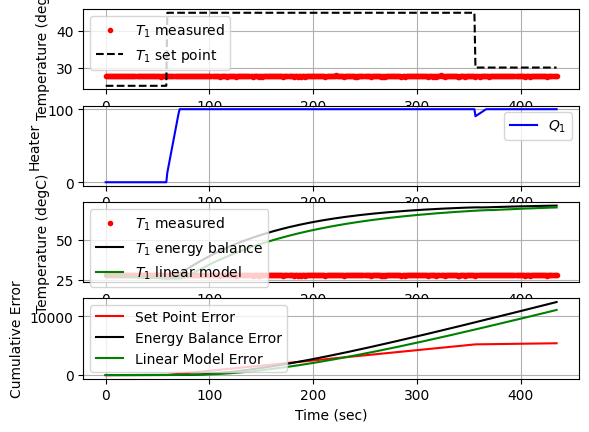

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
 436.8  30.00  27.67 100.00   0.74  98.92  -0.00


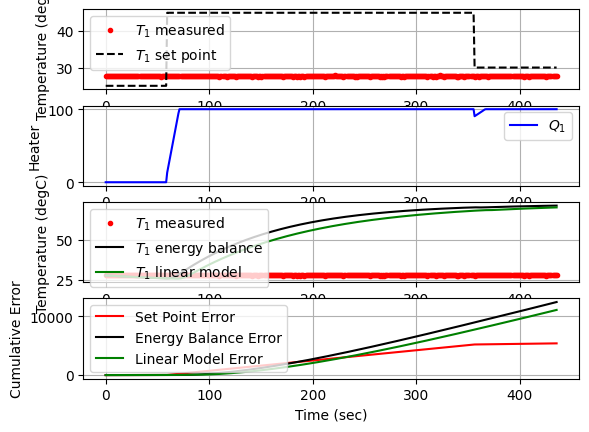

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 437.7  30.00  27.61 100.00   0.76  98.92   0.00


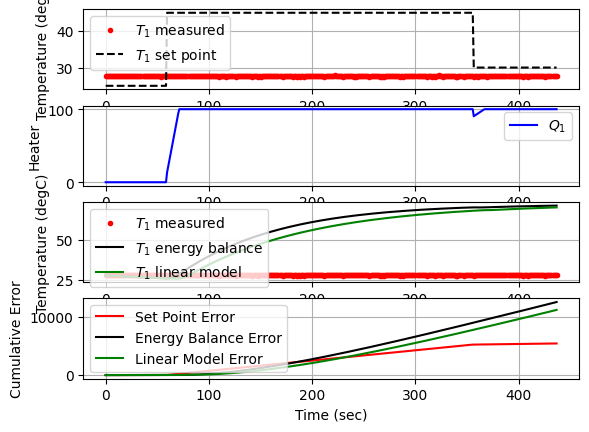

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 438.7  30.00  27.61 100.00   0.76  98.92  -0.00


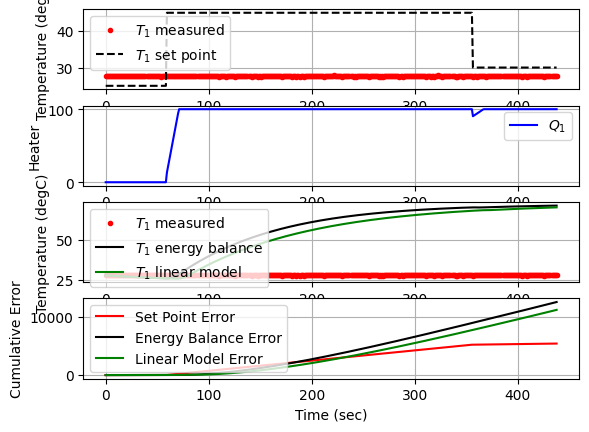

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 439.7  30.00  27.53 100.00   0.78  98.92   0.00


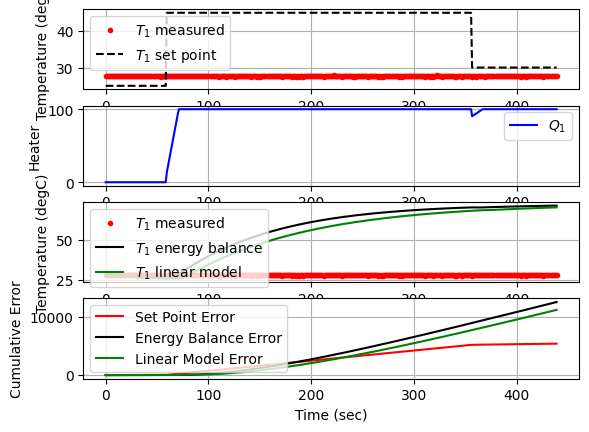

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
 440.7  30.00  27.82 100.00   0.69  98.92  -0.01


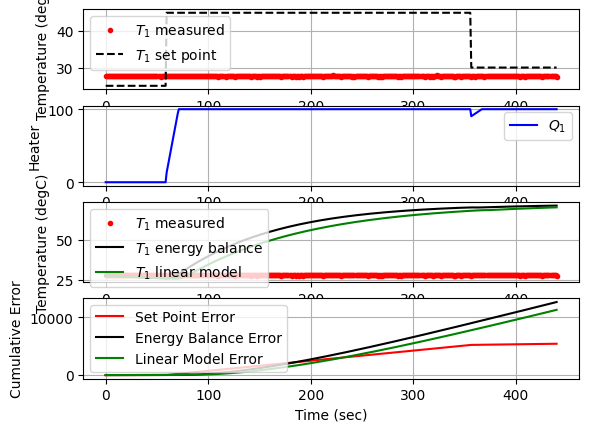

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 441.7  30.00  27.62 100.00   0.75  98.92   0.01


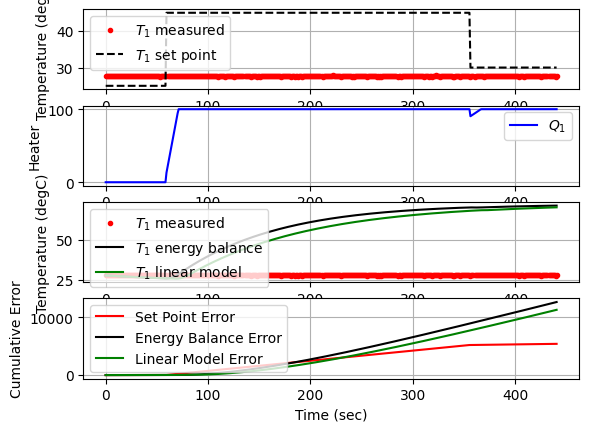

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
 442.7  30.00  27.66 100.00   0.74  98.92  -0.00


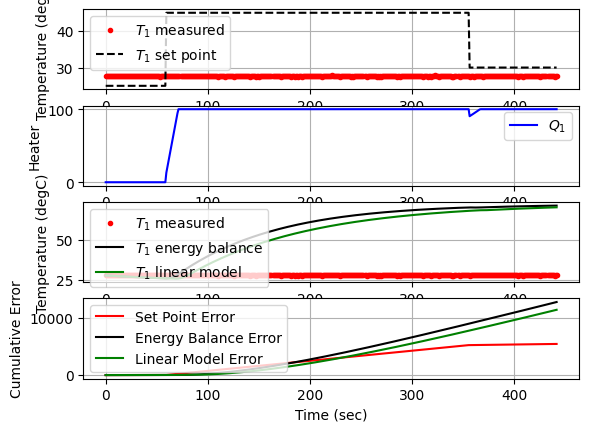

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 443.7  30.00  27.64 100.00   0.75  98.92   0.00


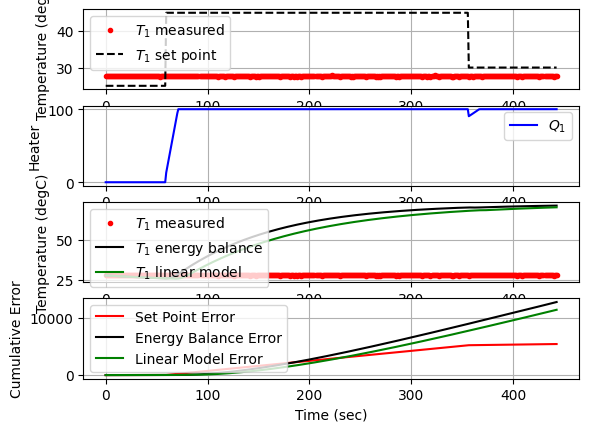

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
 444.7  30.00  27.62 100.00   0.75  98.92   0.00


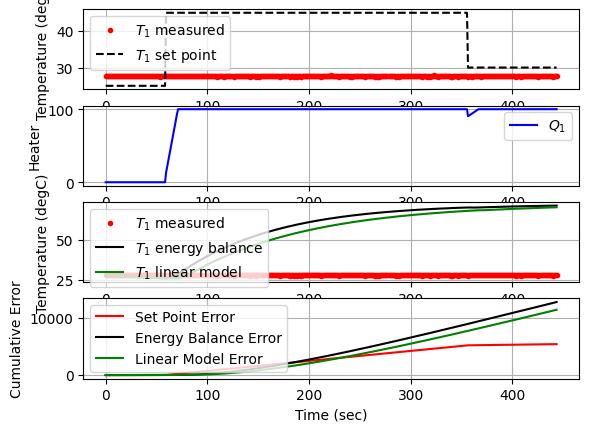

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
 445.7  30.00  27.66 100.00   0.74  98.92  -0.00


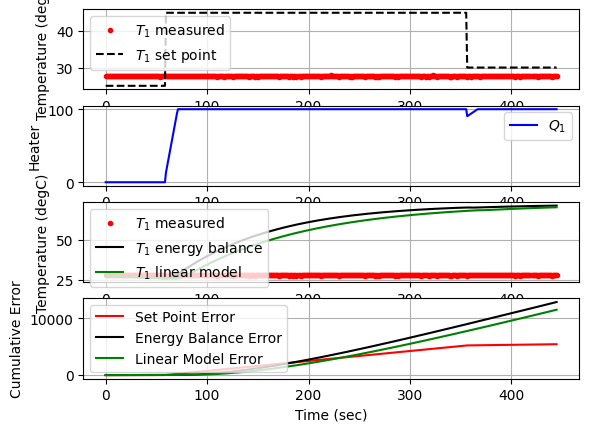

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 446.7  30.00  27.66 100.00   0.74  98.92  -0.00


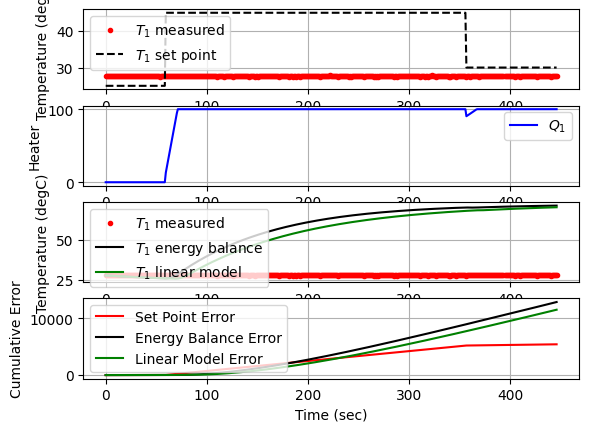

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
 447.6  30.00  27.59 100.00   0.76  98.92   0.00


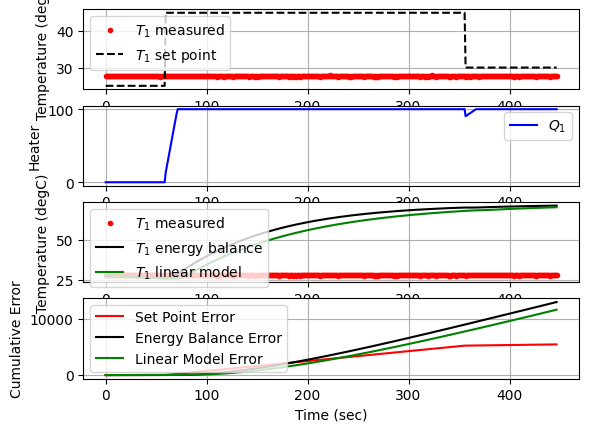

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
 448.6  30.00  27.64 100.00   0.75  98.92  -0.00


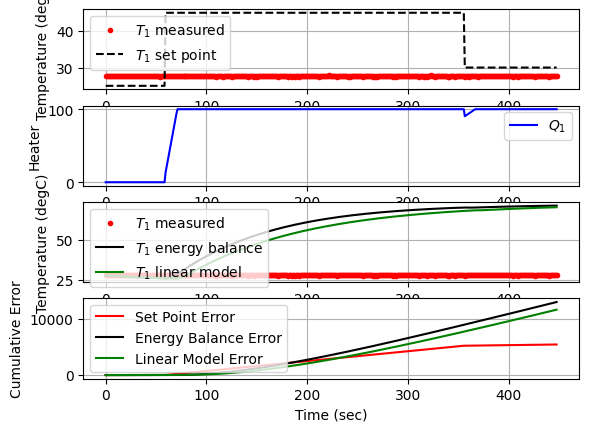

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
 449.6  30.00  27.57 100.00   0.77  98.92   0.00


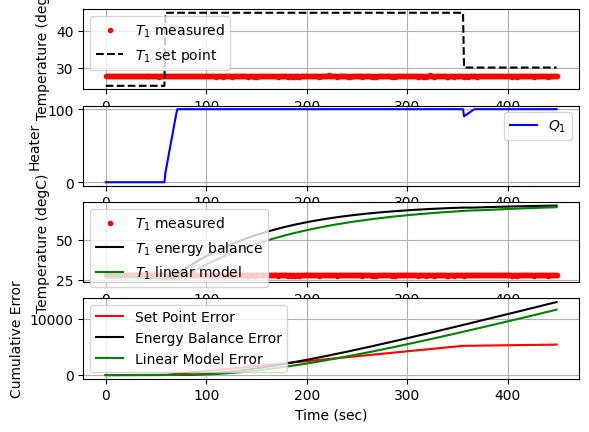

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
 450.6  30.00  27.58 100.00   0.77  98.92  -0.00


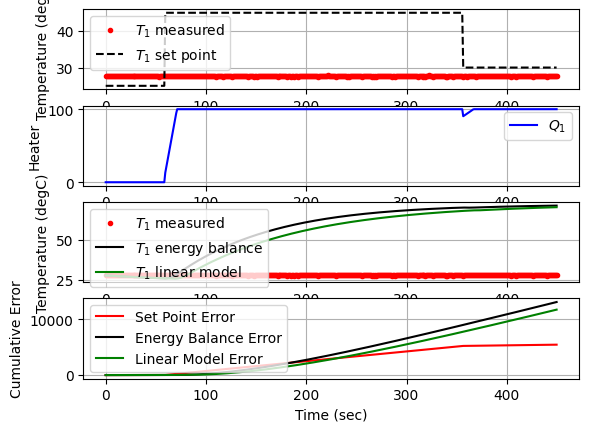

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
 451.6  30.00  27.61 100.00   0.76  98.92  -0.00


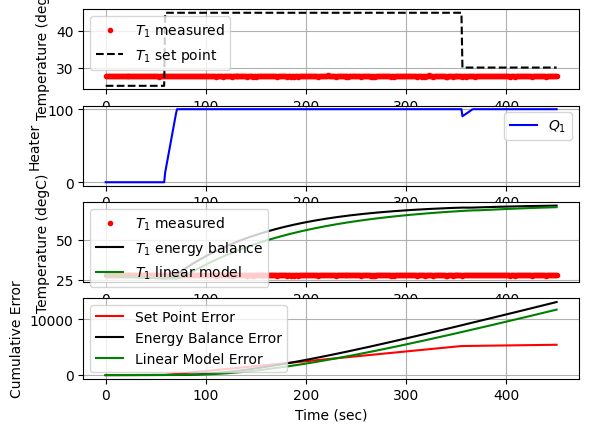

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
 452.7  30.00  27.62 100.00   0.75  98.92  -0.00


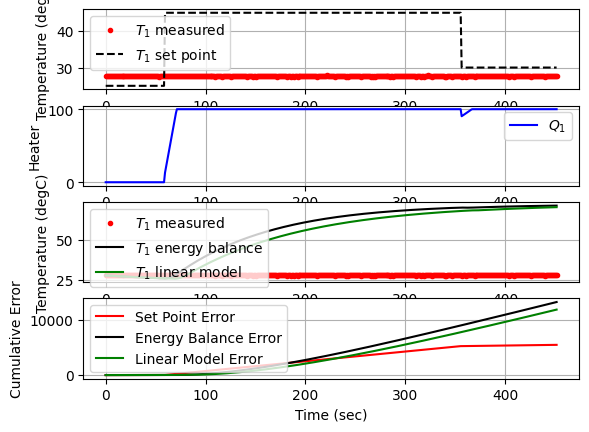

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
 453.6  30.00  27.62 100.00   0.75  98.92  -0.00


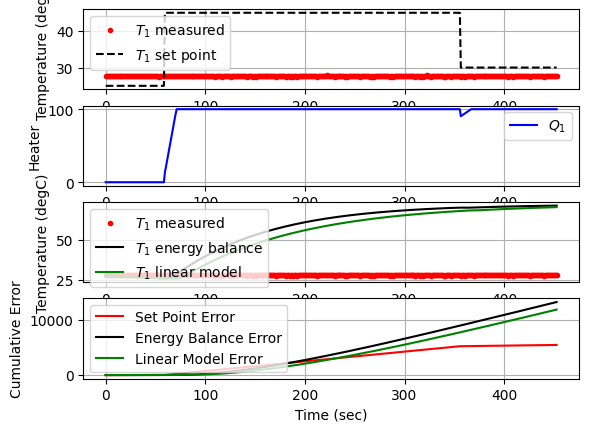

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
 454.6  30.00  27.75 100.00   0.71  98.92  -0.01


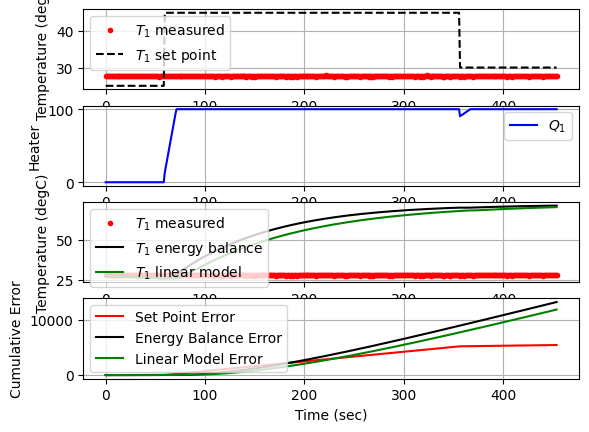

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
 455.6  30.00  27.65 100.00   0.74  98.92   0.00


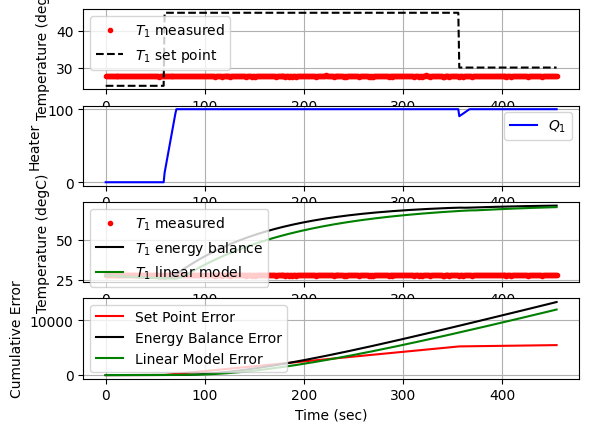

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 456.6  30.00  27.67 100.00   0.74  98.92  -0.00


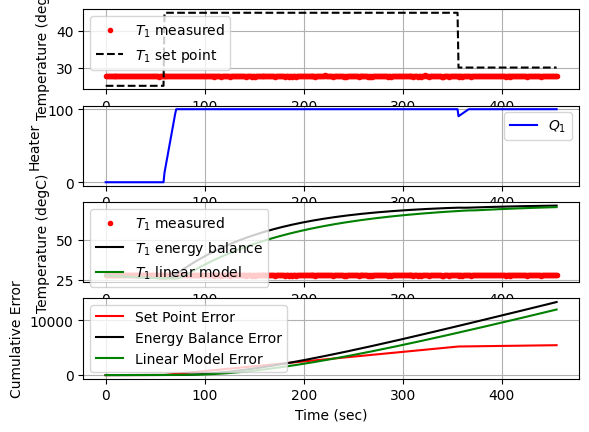

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 457.6  30.00  27.69 100.00   0.73  98.92  -0.00


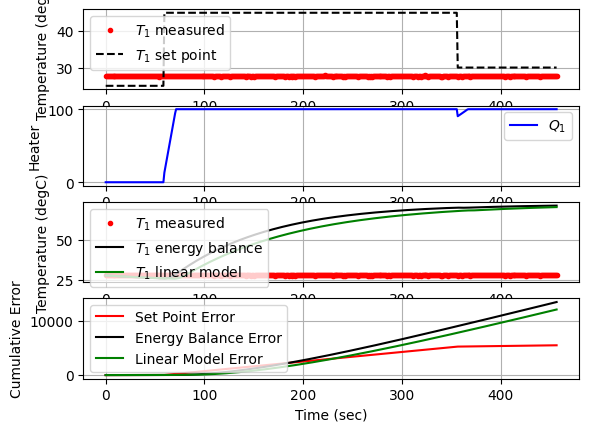

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 458.6  30.00  27.57 100.00   0.77  98.92   0.00


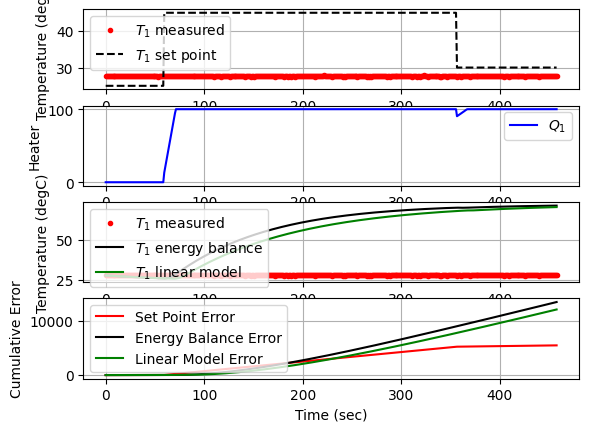

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 459.6  30.00  27.61 100.00   0.76  98.92  -0.00


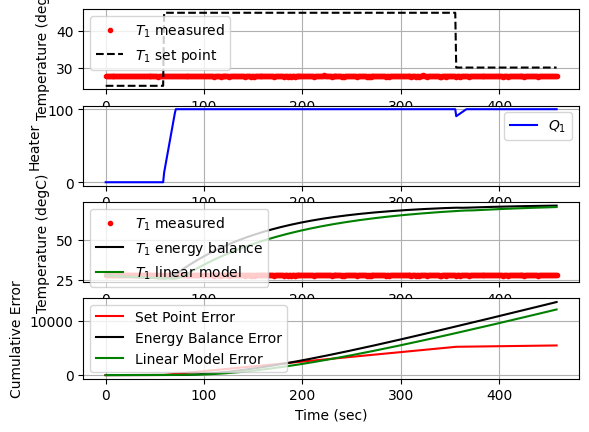

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
 460.6  30.00  27.69 100.00   0.73  98.92  -0.00


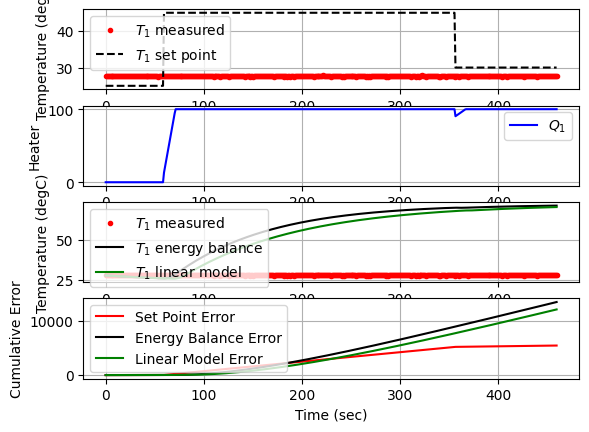

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
 461.6  30.00  27.68 100.00   0.73  98.92   0.00


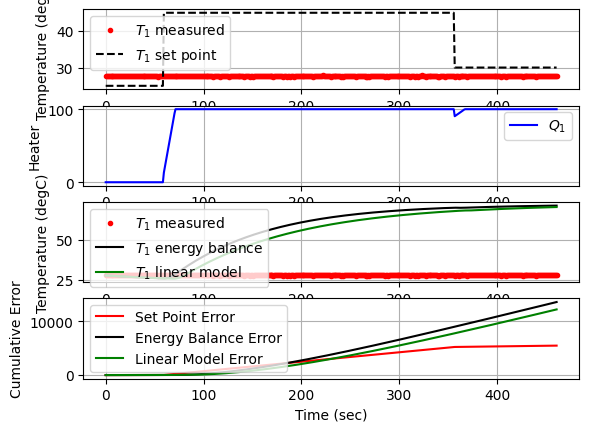

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
 462.6  30.00  27.66 100.00   0.74  98.92   0.00


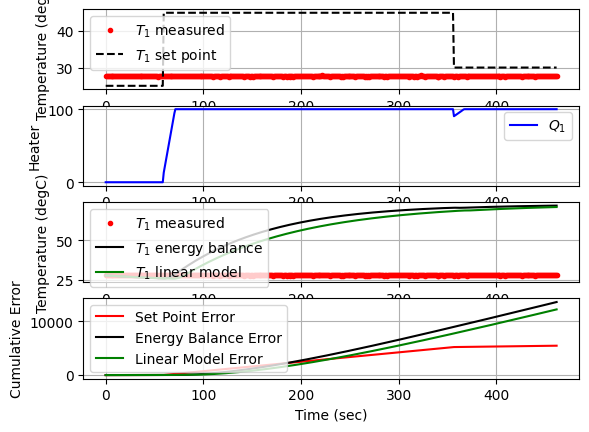

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
 463.6  30.00  27.58 100.00   0.77  98.92   0.00


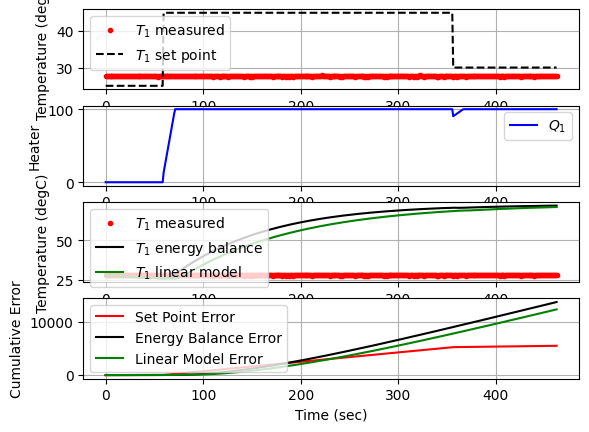

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 464.5  30.00  27.67 100.00   0.74  98.92  -0.00


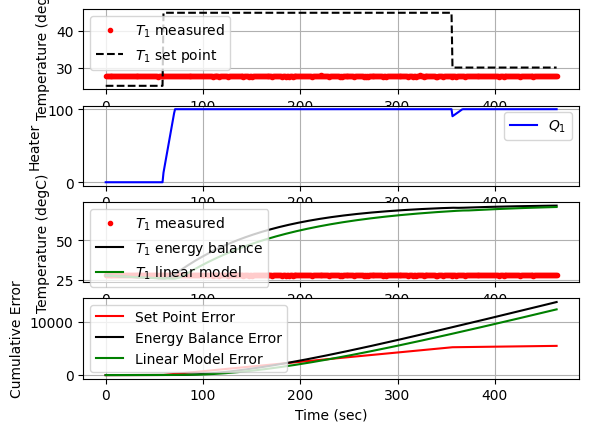

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 465.5  30.00  27.74 100.00   0.71  98.92  -0.00


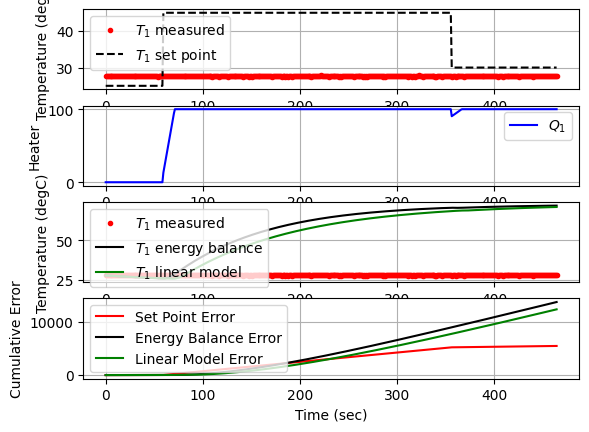

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 466.5  30.00  27.64 100.00   0.75  98.92   0.00


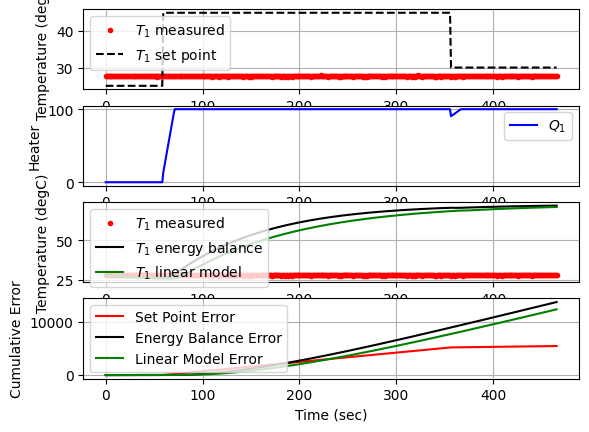

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 467.5  30.00  27.65 100.00   0.74  98.92  -0.00


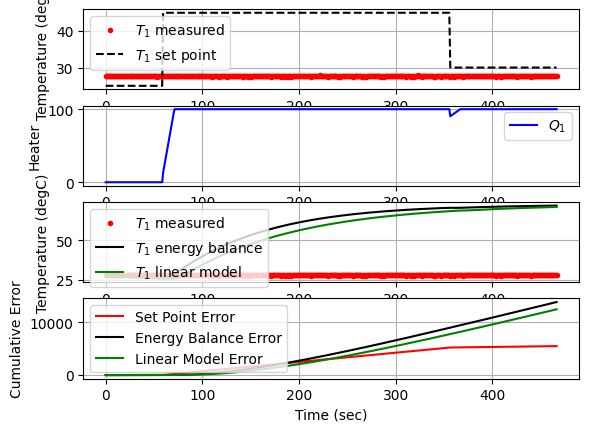

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
 468.5  30.00  27.67 100.00   0.74  98.92  -0.00


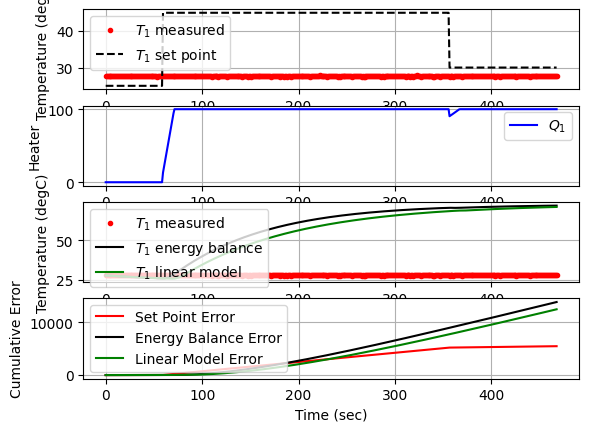

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
 469.5  30.00  27.56 100.00   0.77  98.92   0.00


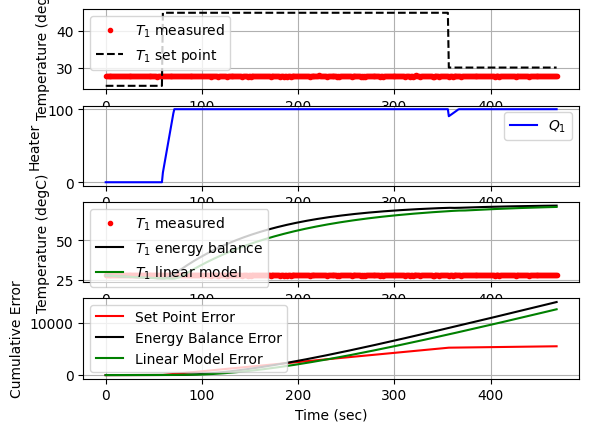

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 470.5  30.00  27.72 100.00   0.72  98.92  -0.01


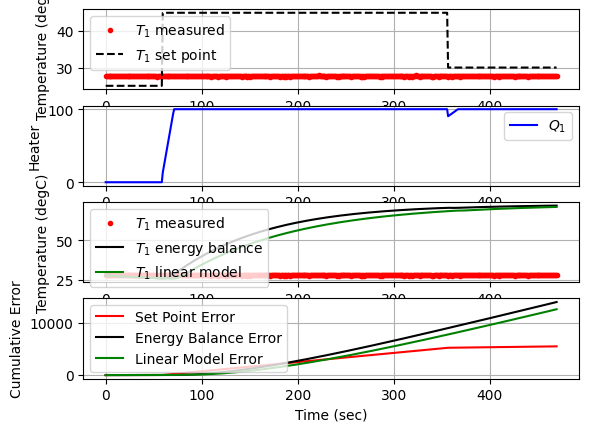

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
 471.5  30.00  27.68 100.00   0.73  98.92   0.00


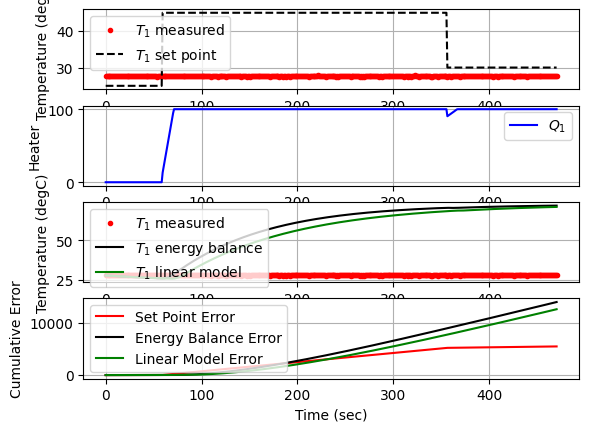

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
 472.5  30.00  27.64 100.00   0.75  98.92   0.00


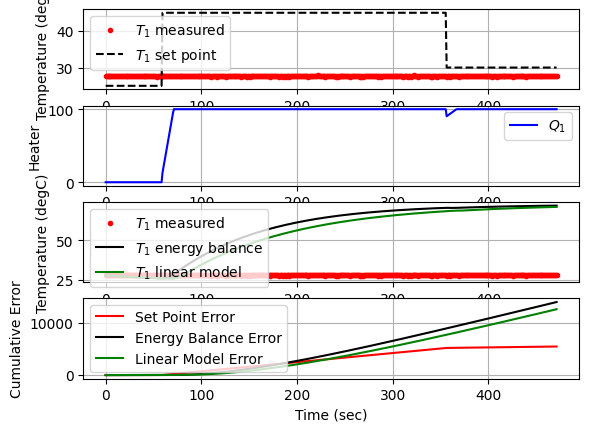

Shutting down
Arduino disconnected successfully
Arduino disconnected successfully


True

<Figure size 640x480 with 0 Axes>

In [14]:
######################################################
# Do not adjust anything below this point            #
######################################################

# Connect to Arduino
a = itclab.iTCLab()
#a.encode('utf-8').strip()#modification error
# Turn LED on
print('LED On')
a.LED(100)

# Run time in minutes
run_time = 15.0

# Number of cycles
loops = int(60.0*run_time)
tm = np.zeros(loops)

# Temperature
# set point (degC)
Tsp1 = np.ones(loops) * 25.0 
Tsp1[60:] = 45.0
Tsp1[360:] = 30.0
Tsp1[660:] = 35.0
T1 = np.ones(loops) * a.T1 # measured T (degC)
error_sp = np.zeros(loops)

Tsp2 = np.ones(loops) * 23.0 # set point (degC)
T2 = np.ones(loops) * a.T2 # measured T (degC)

# Predictions
Tp = np.ones(loops) * a.T1
error_eb = np.zeros(loops)
Tpl = np.ones(loops) * a.T1
error_fopdt = np.zeros(loops)

# impulse tests (0 - 100%)
Q1 = np.ones(loops) * 0.0
Q2 = np.ones(loops) * 0.0

print('Running Main Loop. Ctrl-C to end.')
print('  Time     SP     PV     Q1   =  P   +  I  +   D')
print(('{:6.1f} {:6.2f} {:6.2f} ' + \
       '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
           tm[0],Tsp1[0],T1[0], \
           Q1[0],0.0,0.0,0.0))

# Create plot
plt.figure(figsize=(10,7))
plt.ion()
plt.show()

# Main Loop
start_time = time.time()
prev_time = start_time
# Integral error
ierr = 0.0
try:
    for i in range(1,loops):
        # Sleep time
        sleep_max = 1.0
        sleep = sleep_max - (time.time() - prev_time)
        if sleep>=0.01:
            time.sleep(sleep-0.01)
        else:
            time.sleep(0.01)

        # Record time and change in time
        t = time.time()
        dt = t - prev_time
        prev_time = t
        tm[i] = t - start_time

        # Read temperatures in Kelvin 
        T1[i] = a.T1
        T2[i] = a.T2

        # Simulate one time step with Energy Balance
        Tnext = odeint(heat,Tp[i-1]+273.15,[0,dt],args=(Q1[i-1],))
        Tp[i] = Tnext[1]-273.15

        # Simulate one time step with linear FOPDT model
        z = np.exp(-dt/tauP)
        Tpl[i] = (Tpl[i-1]-Tss) * z \
                 + (Q1[max(0,i-int(thetaP)-1)]-Qss)*(1-z)*Kp \
                 + Tss

        # Calculate PID Output (Choose one of them)
        # 1. Manually Choosen
#         [Q1[i],P,ierr,D] = pid(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 2. Based on Deep Learning Result
        [Q1[i],P,ierr,D] = pid_dl(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # Start setpoint error accumulation after 1 minute (60 seconds)
        if i>=60:
            error_eb[i] = error_eb[i-1] + abs(Tp[i]-T1[i])
            error_fopdt[i] = error_fopdt[i-1] + abs(Tpl[i]-T1[i])
            error_sp[i] = error_sp[i-1] + abs(Tsp1[i]-T1[i])

        # Write output (0-100)
        a.Q1(Q1[i])
        a.Q2(0.0)

        # Print line of data
        print(('{:6.1f} {:6.2f} {:6.2f} ' + \
              '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
                  tm[i],Tsp1[i],T1[i], \
                  Q1[i],P,ierr,D))

        # Plot
        plt.clf()
        ax=plt.subplot(4,1,1)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tsp1[0:i],'k--',label=r'$T_1$ set point')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,2)
        ax.grid()
        plt.plot(tm[0:i],Q1[0:i],'b-',label=r'$Q_1$')
        plt.ylabel('Heater')
        plt.legend(loc='best')
        ax=plt.subplot(4,1,3)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tp[0:i],'k-',label=r'$T_1$ energy balance')
        plt.plot(tm[0:i],Tpl[0:i],'g-',label=r'$T_1$ linear model')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,4)
        ax.grid()
        plt.plot(tm[0:i],error_sp[0:i],'r-',label='Set Point Error')
        plt.plot(tm[0:i],error_eb[0:i],'k-',label='Energy Balance Error')
        plt.plot(tm[0:i],error_fopdt[0:i],'g-',label='Linear Model Error')
        plt.ylabel('Cumulative Error')
        plt.legend(loc='best')
        plt.xlabel('Time (sec)')
        plt.draw()
        plt.pause(0.05)

    # Turn off heaters
    a.Q1(0)
    a.Q2(0)
    # Save figure
    plt.savefig('test_PID_dl.png')

# Allow user to end loop with Ctrl-C           
except KeyboardInterrupt:
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')

# Make sure serial connection still closes when there's an error
except:           
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Error: Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')
    raise

a.close()

In [ ]:
a.close()